In [2]:
# increase nbr of symols to 16
# 50k observations (500k if possible)

import pandas as pd
import numpy as np
from numpy import save
import matplotlib.pyplot as plt
from scipy.fft import fft, fftshift

from scipy.linalg import dft
import scipy.constants as scipy_cst
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.utils import shuffle
from sklearn.preprocessing import MinMaxScaler

In [2]:
from google.colab import drive
from numpy import load
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!nvidia-smi -L

GPU 0: Tesla P100-PCIE-16GB (UUID: GPU-c11a11d6-2104-48d3-3f86-ff62c53c91d8)


# **Modeling everything**

In [3]:
class Parameters :
    
    
    def __init__(self, bandwidth = 1, nsymbols=256, M = 16, Nt= 2**10, nLayers=100, timeMesh=200):
        
        # distance variables are converted in km
        #--------------------------------- variables ------------------------------------------------------#

        # distance
        self.L = 1#1000e3
        # bandwidth - 1 GHz
        self.B = bandwidth #1.2

        #---------------------------------- physical constants --------------------------------------------#

        # power loss in dB
        self.a_dB = 0.2 
        # loss coefficient
        self.alpha = (1e-4)*np.log2(10)*self.a_dB
        # speed of light m/s
        self.c = 3e8
        # dispersion ps/(nm-m)
        self.D = 17*1e-6
        #non-linearity coefficient - W^-1 m^-1
        self.gama = 1.27*1e-3
        # a constant factor
        self.nsp = 1
        # Planck constant - J.s
        self.h = scipy_cst.Planck
        # center wavelength - m
        self.lambda0 = 1.55e-6 #1.55e-9
        # center frequency
        self.f0 = self.c/self.lambda0    
        # dispersion coefficient
        self.beta2 = -(self.D*(self.lambda0**2))/(2*np.pi*self.c)

        #---------------------------------- scale factors ------------------------------------------------#

        self.L0 = self.L
        self.T0 = np.sqrt(np.abs(self.beta2*self.L)/2)
        self.P0 = 2/(self.gama*self.L)

        #----------------------------------- noise PSD ---------------------------------------------------#

        # physical noise 
        self.sigma02 = self.nsp*self.h*self.alpha*self.f0
        # normalized
        self.sigma2 = self.sigma02*self.L/(self.P0*self.T0) 

        #-------------------------------------------------------------------------------------------------#

        self.power = 6e-2
        self.l = 1#5
        self.nz = nLayers # 500
        self.z = 1#self.l/self.L #1

        #------------------------------------ time mesh --------------------------------------------------#

        # you have to choose this
        self.T = timeMesh #( (1/bandwidth)*self.nb ) + (10*2/ self.nb) #timeMesh # 200#20 # (1/B)*Ns + 10*2/B
        # you have to choose this
        self.N = Nt #2*10**2 #2**10
        self.dt = self.T/self.N
        self.t = np.linspace(-self.T/2, self.T/2, num=self.N, endpoint=True)

        #------------------------------------ frequency mesh ---------------------------------------------#

        self.F = 1/self.dt
        self.df = 1/self.T
        self.f = np.linspace(-self.F/2, self.F/2, num=self.N, endpoint=True) #np.fft.fftfreq(self.N, self.dt)
        self.omega = 2*np.pi*self.f
        self.w = np.fft.fftshift(self.omega)

        #------------------------------------ bits to signal ---------------------------------------------#

        # size of the constellation
        self.M = M
        # number of symbols (or sinc functions); test with s=1
        self.n = nsymbols
        # number of bits
        self.nb = int(self.n * np.log2(self.M))
        # probability of zero
        self.p = 1/2
        
        #------------------------------------ Generative nnet ---------------------------------------------#
        
        # Number of the Layers of the Generative nnet 
        self.nbrLayers = nLayers
        # epsilon
        self.eps = self.z / self.nz
        
        # Amplitude for AWGN
        self.A = 2
        self.s = 2
    
    def setN(self,n):
        self.N = n
        self.__init__(N=n)
    
    def setNbrLayers(self,N):
        self.nbrLayers = N
        self.__init__(nbrLayers=N)

In [4]:
class NNetGenerator :

    #-------------------------------------------------------------------------------------------------#

    def __init__(self, parameters):
        self.params = parameters

    #-------------------------------------------------------------------------------------------------#

    def H(self, f, z):
        """ Compute the channel transfer function.
        @param f : frequency vector.
        @param z : scalar.
        """

        omega = 2*np.pi*f
        return np.exp(1j*z*omega**2)
       
    #-------------------------------------------------------------------------------------------------#

    def nnet_gen_old2(self,  X):
        """ Simulate a NNet by computing the V matrix (V is Y in the implementation).
            @param X : data.
        """
        # reshaping the input
        
        #print("[INFO] starting {nnet_gen}...")
        #print("X : ",X)
        X = X.reshape((-1, 1))
        dz = self.params.z/self.params.nz

        #np.set_printoptions(precision=2, suppress=True)  # for compact output

       # D = dft(X.size, scale='sqrtn')

       # R = self.H(self.params.f,dz)

       # W = np.dot(D.conj().T , np.dot(np.diag(R),D))

        # Deep Neural Network
        #print("[INFO] {nnet_gen} started generating the data...")
        #print("Before X.shape : ", X.shape)
        for j in range(self.params.nz):

            # Linear transformation     
           # X = np.dot(W, X)
            w = fftshift(2*np.pi*f)
            Y = ifft(fft(X)*np.exp(1j*w**2))
            
            w = np.fft.fftshift(2*np.pi*self.params.f)
            w = np.reshape(-1,1)
            if j  == 0:
              print("w.shape : ", w.shape)

            X = np.fft.ifft(np.exp(1j*dz*(w**2))*np.fft.fft(X))
            """ker = np.exp(1j*dz*(w**2))
            ker = np.reshape(-1,1)
            Xf = np.fft.fft(X)
            X = np.fft.ifft( ker*Xf )"""
            if j  == 0:
              print("After X.shape : ", X.shape)
            """
            if j  == 0:
              print("After Xf.shape : ", Xf.shape)
              print("After ker.shape : ", ker.shape)
              print("After X.shape : ", X.shape)
            """
            # Non-Linear transformation
            X = self.activation(X, dz)
            # Gaussian Noise 
            #Z = self.addNoise(len(X), self.params.sigma2 , self.params.B, dz)
            Z = self.noise(len(X), self.params.sigma2 , self.params.B, dz)
            X = X + Z
            
        # Output
        Y = np.squeeze(X + Z)
        
        return Y

    #-------------------------------------------------------------------------------------------------#

    def nnet_gen_old(self,  X):

      """ Simulate a NNet by computing the V matrix (V is Y in the implementation).
          @param X : data.
      """
      #X = X.reshape((-1, 1))
      X =  np.asarray(X)
      dz = self.params.z/self.params.nz


      for j in range(self.params.nz):

          # Linear transformation    

          
          #w = np.fft.fftshift(2*np.pi*self.params.f)
          
          #X = np.fft.ifft(np.exp(1j*dz*(w**2))*np.fft.fft(X))

          X = np.fft.ifft(np.fft.fft(X)*np.exp(1j*dz*(self.params.w**2)))
          # Non-Linear transformation
          X = self.activation(X, dz)

          # Complex Gaussian Noise 
          #Z = self.addNoise(len(X), self.params.sigma2 , self.params.B, dz)
          Z = self.noise(len(X), self.params.sigma2 , self.params.B, dz)
        
          #Y = X + Z
          #X = Y
          
      # Output
      Y = np.squeeze(X)
      
      return Y

    #-------------------------------------------------------------------------------------------------#

    def SpectrumAnalysis(self, x, Fs):
        L = int(np.power(2, np.ceil(np.log2(len(x)))))
        f = np.fft.fftshift(np.linspace(-Fs/2, Fs/2, L))
        x_fft = np.fft.fft(x, L)
        return np.abs(x_fft), f
    
    #-------------------------------------------------------------------------------------------------#

    def linearEffect(self, x, epsilon, Fs):

        L = int(np.power(2, np.ceil(np.log2(len(x)))))
        x_fft = np.fft.fft(x, L)
        f = np.fft.fftshift(np.linspace(-Fs/2, Fs/2, L))
        lamda = np.exp(1j * epsilon * ((2*f*np.pi)**2))
        x_ifft = np.fft.ifft(x_fft * lamda)
        x_ifft = np.delete(x_ifft, range(x.shape[0], L))

        return x_ifft 
    
    #-------------------------------------------------------------------------------------------------#

    def nonlinearEffect(self, x, epsilon):
        return x * np.exp(1j * 2 * epsilon * (np.abs(x)**2))
    
    #-------------------------------------------------------------------------------------------------#

    def add_noise(self, x, sigma02, B, epsilon):
        return np.random.normal(0, sigma02**2 * B * epsilon, x.shape)

    #-------------------------------------------------------------------------------------------------#

    def noise(self, n, sigma2, B, dz):
      Pn = sigma2 * B * dz

     # Z = np.fft.fftshift(np.fft.ifft(np.random.normal(loc=0, scale=np.sqrt(Pn), size=(n, 1))))
      Z = np.sqrt(Pn/2)*(np.random.randn(n) + 1j*np.random.randn(n)) # check if (n,1) or (1,n)

      return Z
    
    #-------------------------------------------------------------------------------------------------#

    def nnet_gen(self, X):
        
        epsilon = self.params.z / self.params.nz
        
        for i in range(self.params.nbrLayers):
            
            V = self.linearEffect(X, epsilon, self.params.F)
            U = self.nonlinearEffect(V, epsilon)
            Y = U + self.add_noise(U, self.params.sigma02, self.params.B, epsilon)
            X = Y
            
        return X

    #-------------------------------------------------------------------------------------------------#


    def activation(self, x, dz):
        """ Computes the activation of a neuron.
            @param X : data.
        """
        return x*np.exp(2j*dz*(np.abs(x)**2))

    #-------------------------------------------------------------------------------------------------#


    def addNoise(self, n, sigma2, B, dz):
        """ Generate Gaussian noise. """
        Pn = sigma2 * B * dz

        Z = np.fft.fftshift(np.fft.ifft(np.random.normal(loc=0, scale=np.sqrt(Pn), size=(n, 1))))
        return Z
        
    #-------------------------------------------------------------------------------------------------#

In [5]:
class Channel :

    #-------------------------------------------------------------------------------------------------#

    def __init__(self):
        super()

    #-------------------------------------------------------------------------------------------------#

    def channel(self, t, q0t, z, sigma2, B) :
        # total noise power in B Hz and distance [0, z]
        a = sigma2*B*z 
        # get the f vector from t vector
        f = np.fft.fftfreq(t.size, 2*t[-1]/t.size)
        omega = 2*np.pi*f
        omega2 = omega**2
        # input in frequency
        q0f = np.fft.fft(q0t)
        #output in frequency
        hwz = np.exp(1j*z*omega2)
        # element-wise multiplication
        qzf = np.multiply(q0f,hwz) 
        #add Guassian noise in frequency, with correct variance
        N = len(f)
        qzf = qzf + np.random.normal(0, np.sqrt(a), qzf.shape)
        # back to time
        qzt = np.fft.ifft(qzf) 

        print("[channel] qzt :",qzt)
        print("[channel] qzf :",qzf)
        
        return qzt, qzf

In [6]:
class Transmitor :

    def __init__(self):
        super()


    #-------------------------------------------------------------------------------------------------#
    
    def source(self, N, p):
        """ Generates an N-bit sequence drawn from a Bernoulli stochastic process.
            @param N : Length of the bit sequence
            @param p : probability of 0
        """
        n=1
        return np.random.binomial(n, p, size=N)
    
    def source__(self, N, p):
        b = np.zeros((N, 1), dtype=np.int32)
        for i in range(N):
            x = np.random.choice([0, 1], p=[p, 1-p])
            b[i] = x
        return b


    #-------------------------------------------------------------------------------------------------#

    def build_constellations(self, M):
    
        """ Builds a M-QAM constellation.
            @param M : Number of symbols.
        """
        
        # Sequential address from 0 to M-1 (1xM dimension)
        n = np.arange(0,M)
        #convert linear addresses to Gray code
        a = np.asarray([x^(x>>1) for x in n])
        #Dimension of K-Map - N x N matrix
        D = np.sqrt(M).astype(int) 
        # NxN gray coded matrix
        a = np.reshape(a,(D,D))
        # identify alternate rows
        oddRows=np.arange(start = 1, stop = D ,step=2) 
        
        # reshape to 1xM - Gray code walk on KMap
        nGray=np.reshape(a,(M)) 
        
        #element-wise quotient and remainder
        (x,y)=np.divmod(nGray,D) 
        # PAM Amplitudes 2d+1-D - real axis
        Ax=2*x+1-D 
        # PAM Amplitudes 2d+1-D - imag axis
        Ay=2*y+1-D 
        constellation = Ax+1j*Ay
        
        self.constellation = constellation

        return constellation


    #-------------------------------------------------------------------------------------------------#

    def bit_to_symb_(self, b, cnt):
        """ Creates a mapping between bits sequences and symbols.
            @param b : N-bit sequence
            @param cnt : constellation
        """
        
        M = len(cnt)
        N = len(b)
        n = int(N/np.log2(M))
        pas = int(np.log2(M))
        """
        print("[bit_to_symb] M :",M)
        print("[bit_to_symb] N :",N)
        print("[bit_to_symb] n :",n)
        print("[bit_to_symb] pas :",pas)
        print("[bit_to_symb] b :",b)
        """

        #dictionary of mapping
        #mapping_dict = {}
        #mapping_list = []        
        mapping_list_symbols_only = []

        for i in range(n):
            # bit sequence
            s = b[pas*i:(pas*i)+pas]   
            s_str = ''.join(map(str, s)) # converts the bit array to string
            
            # avoids adding a 0 len string to the mapping
            if s_str != '' :
                symbol = cnt[i%M]
                #mapping_dict[s_str] = symbol
                #mapping_list.append((s_str,symbol))
                mapping_list_symbols_only.append(symbol)


        #self.b2sMapping_dict = mapping_dict
        #self.b2sMapping_list = mapping_list

        """
        print("[bit_to_symb] mapping_dict :",mapping_dict)
        print("[bit_to_symb] mapping_dict len :",len(mapping_dict))
        print("[bit_to_symb] mapping_list len :",len(mapping_list))
        print("[bit_to_symb] mapping_list[0] :",mapping_list[0])
        print("mapping_list[0][0] : ", type(mapping_list[0][1]))
        """
        return mapping_list_symbols_only
    
    #-------------------------------------------------------------------------------------------------#

    def bit_to_symb(self, b, M):
        k = int(np.log2(M))
        
        if b.size % k != 0:
            b = np.vstack((b, np.zeros((6-b.size % k, 1), dtype=np.uint8)))
            
        bits = b.reshape((-1, k))
        
        symboles = []
        for bi in bits:
            biDec = np.packbits(np.hstack((np.zeros(8-k, dtype=np.uint8), bi)))[0]
            bin, code = self.grayCoding(biDec, M)
            symboles.append(code)

        return np.array(symboles)
    
    #-------------------------------------------------------------------------------------------------#

    def grayCoding(self, n, M):
        k = int(np.log2(M))

        reAxis = np.hstack((np.arange(-(np.sqrt(M)//2), 0, step=1),
                            np.arange(1, np.sqrt(M)/2+1, step=1)))
        imAxis = np.copy(reAxis)

        bin = np.unpackbits(np.array([n], dtype=np.uint8))[8-k:]

        rePart = bin[:k//2]
        imPart = bin[k//2:]

        aReBin = np.hstack((np.zeros(8-k//2, dtype=np.uint8), rePart))
        aImBin = np.hstack((np.zeros(8-k//2, dtype=np.uint8), imPart))

        aReDec = np.packbits(aReBin)
        aImDec = np.packbits(aImBin)

        reIndex = np.bitwise_xor(aReDec, aReDec//2)[0]
        imIndex = np.bitwise_xor(aImDec, aImDec//2)[0]

        return  bin, complex(reAxis[reIndex], imAxis[imIndex])
    
    #-------------------------------------------------------------------------------------------------#

In [7]:
class Modulator :

    #-------------------------------------------------------------------------------------------------#

    def __init__(self):
      super()

    #-------------------------------------------------------------------------------------------------#
    
    def mod_(self, t,S, B):
        """ Modulate symbols data.
            @param t : time.
            @param s : sequence of symbols.
            @param B : Bandwidth.
        """

        # number of symbols
        Ns = len(S)
        # init
        q0t = 0
             
        for i in range(Ns):
            q0t = q0t + np.sqrt(B)*S[i]*np.sinc(B*t-i) #np.sinc(B*t-i)
        
        norm = np.linalg.norm(q0t)
        q0t = q0t/norm
        
        return q0t
    
    def mod(self,t, s, B):
        Ns = len(s)  # Number of Symbols

        l1 = int(-(Ns/2))
        l2 = int((Ns/2) - 1)

        lRange = np.linspace(l1, l2, num=Ns, endpoint=True)

        q0t = 0# np.zeros((1, t.size), dtype=np.complex64)

        for sl, l in zip(s, lRange):
            q0t += sl * np.sinc(B*t - l)

        return np.sqrt(B)*q0t

    #-------------------------------------------------------------------------------------------------#


In [8]:
class Equalizer :

    #-------------------------------------------------------------------------------------------------#

    def __init__(self):
        super()

    #-------------------------------------------------------------------------------------------------#

    def equalize(self, t, qzt, z):
        
        # get the f vector from t vector
        f = np.fft.fftfreq(t.size, 2*t[-1]/t.size)
        # get the omega vector from f vector
        omega = 2*np.pi*f

        # compute omega² for h
        omega2 = omega**2

        # Channel transfer function
        hwz = np.exp(1j*z*omega2)
        hwz_1 = np.reciprocal(hwz)
        # input in frequency
        qzf = np.fft.fft(qzt)
        # output in frequency        
        qzfe = np.multiply(qzf,hwz_1)
        # back to time
        qzte = np.fft.ifft(qzfe)

        print("[Equalizer] qzte :",qzte)
        print("[Equalizer] qzfe :",qzfe)
        return qzte, qzfe

In [38]:
#-----------------------------------------------------------------------------------------#

# Generating the dataset
def generateDataset_old(nbrOfObservations, parameters):

    X = np.ndarray((parameters.N, nbrOfObservations), dtype=np.complex128)
    y = np.ndarray((parameters.N, nbrOfObservations), dtype=np.complex128)

    print("[INFO] Generating the dataset...")

    for i in tqdm(range(1,nbrOfObservations)):
        """
        #source
        source = transmitor.source(parameters.N , parameters.p)

        # Constellation
        constellation = transmitor.build_constellations(parameters.M)

        # Bits to Symboles 
        bitsToSymbols = transmitor.bit_to_symb(source, constellation)
        # Modulation
        q0t = modulator.mod(parameters.t, constellation, parameters.B)
        """
        q0t = parameters.A*np.exp(-parameters.t**2) 
        #q0f = np.fft.fft(q0t)
        X[i] = np.squeeze(q0t)

        # Neural Net Generator
        Y = nnetGen.nnet_gen(q0t)
        #Y = nnetGen.nnet_gen_old(q0t)

        y[i] = Y

    print("[INFO] The dataset is ready now !")
    return X, y
#-----------------------------------------------------------------------------------------#
# Generating the dataset
def generateDataset(nbrOfObservations, parameters, isGaussian=False, testing=False):

    X = np.ndarray((nbrOfObservations, parameters.N), dtype=np.complex128)
    y = np.ndarray((nbrOfObservations, parameters.N), dtype=np.complex128)

  
    print("[INFO] Generating the dataset...")
    #X = cp.asarray(X)
    #y = cp.asarray(y)

    #changed range from 0... not 1
    for i in tqdm(range(0,nbrOfObservations)):

        # Constellation
        constellation = transmitor.build_constellations(parameters.M)
        
        #source
        source = transmitor.source(parameters.nb , parameters.p) # USE IT FOR NEXT PART OF BITS
        
        # Bits to Symboles - symbol sequence
        #bitsToSymbols = transmitor.bit_to_symb(source, constellation)
        # symbol sequence
        #mapping_dict, mapping_list, mapping_list_symbols_only = transmitor.bit_to_symb(source, constellation)
        # we create a list of values of the complex symbols to use them in modulation
        val_s = transmitor.bit_to_symb(source, parameters.M)

        # Modulation
        if testing:
            print("[INFO] Modulation...")  

        # channel - we take gaussian input
        if isGaussian:
            q0t = parameters.A*np.exp(-parameters.t**2) 
            #q0f = np.fft.fft(q0t)

        else :
            q0t = modulator.mod(parameters.t,val_s, parameters.B)  
            #q0f = np.fft.fft(q0t)

        # SOURCE IS THE SEQUENCE OF BITS TO BE LEARNED
        X[i] = np.squeeze(q0t)

        # Neural Net Generator
        Y = nnetGen.nnet_gen_old(q0t)
        y[i] = Y
        
    print("[INFO] The dataset is ready now !")
    return X, y

#-----------------------------------------------------------------------------------------#

def createDataFrame(X,y) :
    X_ = np.column_stack((X.real,X.imag))
    y_ = np.column_stack((y.real,y.imag))
    data = np.column_stack((X_,y_))

    df = pd.DataFrame(data)
    print("df.shape : ",df.shape)
    df.to_csv("generatedData.csv")
    
    return df

#-----------------------------------------------------------------------------------------#

def test_dataset(X, parameters, index):
  
    withPlot = True
    q0t = X[index] #fromRealToComplex(l)
    q0f = np.fft.fft(q0t)

    qzt, qzf = channel.channel(parameters.t, q0t, parameters.z, parameters.sigma02, parameters.B)

    # Equalization
    qzte, qzfe = equalizer.equalize(parameters.t, qzt, parameters.z)

    if withPlot :
        fig2, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(6, figsize = (15, 15))
        fig2.tight_layout(pad=7.0)

        ###
        ax1.plot(parameters.t, np.squeeze(q0t.real), 'b-')
        ax1.set_xlabel("Time")
        ax1.set_ylabel("Re(q0t)")
        ax1.set_title("Modulation - Time plot - Re(q0t)")

        ###
        ax2.plot(parameters.f, np.squeeze(np.abs(q0f)), 'b-')
        ax2.set_xlabel("Freq")
        ax2.set_ylabel("Abs(q0f)")
        ax2.set_title("Modulation - Freq plot - |q0f|")

        ###        
        ax3.plot(parameters.t, np.squeeze(qzt.real), 'b-')
        ax3.set_xlabel("Time")
        ax3.set_ylabel("Re(qzt)")
        ax3.set_title("Channel - Time plot - Re(qzt)")

        ###
        ax4.plot(parameters.f, np.squeeze(np.abs(qzf)), 'b-')
        ax4.set_xlabel("Freq")
        ax4.set_ylabel("Abs(qzf)")
        ax4.set_title("Channel - Freq plot - |qzf|")

        ###
        ax5.plot(parameters.t, np.squeeze(qzte.real), 'b-')
        ax5.set_xlabel("Time")
        ax5.set_ylabel("Abs(qzf)")
        ax5.set_title("Equalization - Time plot - Re(qzte)")

        ###
        ax6.plot(parameters.f, np.squeeze(np.abs(qzfe)), 'b-')
        ax6.set_xlabel("Freq")
        ax6.set_ylabel("Abs(qzf)")
        ax6.set_title("Equalization - Freq plot - |qzfe|")

        plt.show()
        
#-----------------------------------------------------------------------------------------#

In [39]:
#-----------------------------------------------------------------------------------------#

def run(isGaussian=False, s=2):

    # builds the constellation 
    constellation = transmitor.build_constellations(parameters.M) # 16-QAM
    
    # Bernoulli source, random bits sequence
    b = transmitor.source(parameters.nb,parameters.p)
    print("b : ",b)

    # symbol sequence, we create a list of values of the complex symbols to use them in modulation
    #val_s = transmitor.bit_to_symb(b, constellation)
    val_s = transmitor.bit_to_symb(b, parameters.M)

    
    # modulation   

    # channel - we take gaussian input
    if isGaussian:
        print("isGaussian")
        q0t = parameters.A*np.exp(-parameters.t**2/s) 
        q0f = np.fft.fft(q0t)
        
    else :
        q0t = modulator.mod(parameters.t,val_s, parameters.B)  
        q0f = np.fft.fft(q0t)
    
        print("q0t : ",q0t)


    # Pass through the channel
    qzt, qzf = channel.channel(parameters.t, q0t, parameters.z, parameters.sigma02, parameters.B)

    # Equalization
    qzte, qzfe = equalizer.equalize(parameters.t, qzt, parameters.z)

    fig2, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(6, figsize = (25, 25))
    fig2.tight_layout(pad=10.0)

    ###
    ax1.plot(parameters.t, np.squeeze(q0t.real), 'b-')
    ax1.set_xlabel("Time")
    ax1.set_ylabel("Re(q0t)")
    ax1.set_title("Modulation - Time plot - Re(q0t)")

    ###
    ax2.plot(parameters.f, np.squeeze(np.abs(q0f)), 'b-')
    ax2.set_xlabel("Freq")
    ax2.set_ylabel("Abs(q0f)")
    ax2.set_title("Modulation - Freq plot - |q0f|")

    ###        
    ax3.plot(parameters.t, np.squeeze(qzt.real), 'b-')
    ax3.set_xlabel("Time")
    ax3.set_ylabel("Re(qzt)")
    ax3.set_title("Channel - Time plot - Re(qzt)")

    ###
    ax4.plot(parameters.f, np.squeeze(np.abs(qzf)), 'b-')
    ax4.set_xlabel("Freq")
    ax4.set_ylabel("Abs(qzf)")
    ax4.set_title("Channel - Freq plot - |qzf|")

    ###
    ax5.plot(parameters.t, np.squeeze(qzte.real), 'b-')
    ax5.set_xlabel("Time")
    ax5.set_ylabel("Abs(qzf)")
    ax5.set_title("Equalization - Time plot - Re(qzte)")

    ###
    ax6.plot(parameters.f, np.squeeze(np.abs(qzfe)), 'b-')
    ax6.set_xlabel("Freq")
    ax6.set_ylabel("Abs(qzf)")
    ax6.set_title("Equalization - Freq plot - |qzfe|")

    plt.show()

#-----------------------------------------------------------------------------------------#

def test(X, parameter):

    # Signal
    if X is None :
        X = parameter.A*np.exp(-parameter.t**2/parameter.s)

    # NNet generator
    Y1 = nnetGen.nnet_gen(X)

    # Channel
    Y2, _ = channel.channel(parameter.t, X, parameter.z, 0, 0)

    # Equalizer
    Y2e, _ = equalizer.equalize(parameter.t, Y2, parameter.z)
    Y1e, _ = equalizer.equalize(parameter.t, np.squeeze(Y1), parameter.z)

    # Fourier Transform
    Xf = fftshift(fft(X))
    Yf = fftshift(fft(Y1))
    
    #Plots
    
    fig = plt.figure(figsize=(25, 25))
    
    # Input signal
    ax = fig.add_subplot(711)
    fig.suptitle('X -- Y1 -- Y2')
    ax.set_xlabel('Time')
    ax.set_ylabel('X')
    ax.plot(parameter.t, X, 'g--')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')

    # NNet generator
    ax = fig.add_subplot(712)
    ax.set_xlabel('Time')
    ax.set_ylabel('Y1')
    ax.plot(parameter.t, np.squeeze(np.absolute(Y1)), 'r--')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    
    # Signal after channel
    ax = fig.add_subplot(713)
    ax.set_xlabel('Time')
    ax.set_ylabel('Y2')
    ax.plot(parameter.t, np.absolute(Y2), 'b--')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    
    # NNet gen signal after equalization 
    ax = fig.add_subplot(714)
    ax.set_xlabel('Time')
    ax.set_ylabel('Y1 equalized')
    ax.plot(parameter.t, np.absolute(Y1e), 'b--')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    
    # NNet gen signal after equalization
    ax = fig.add_subplot(715)
    ax.set_xlabel('Time')
    ax.set_ylabel('Y2 equalized')
    ax.plot(parameter.t, np.absolute(Y2e), 'b--')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    
    # Input vs output
    
    # in time
    ax = fig.add_subplot(716)
    ax.set_xlabel('Time')
    ax.plot(parameter.t, X, 'b--', label='input')
    ax.plot(parameter.t, np.absolute(Y2), 'r--', label='output')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    
    # in freq
    ax = fig.add_subplot(717)
    ax.set_xlabel('Frequency')
    ax.plot(parameter.f, np.absolute(Xf), 'b--', label='input')
    ax.plot(parameter.f, np.absolute(Yf), 'r--', label='output')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')

    plt.show()
    
#-----------------------------------------------------------------------------------------#

def test_generated(X, y, index, parameter):

    # Signal : X
    X = np.squeeze(X[index])
    
    # NNet generator : y
    y_gen = np.squeeze(y[index])
    y = np.squeeze(y[index])

    w_ = np.fft.fftshift(2*np.pi*parameter.f)
    w_ = np.reshape(-1,1)
    y_vf = np.fft.ifft(np.exp(1j*parameter.z*(w_**2))*np.fft.fft(X))
    
    # Channel
    Y2, _ = channel.channel(parameter.t, X, parameter.z, parameter.sigma2, parameter.B )#0, 0)

    # Equalizer
    Y2e, _ = equalizer.equalize(parameter.t, Y2, parameter.z)
    Y1e, _ = equalizer.equalize(parameter.t, np.squeeze(y), parameter.z)

    # Fourier Transform
    Xf = fftshift(fft(X))
    Yf = fftshift(fft(y))
    
    #Plots
    
    fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7) = plt.subplots(7, figsize = (25, 25))
    #fig = plt.figure(figsize=(25, 25))
    fig.tight_layout(pad=3.0)
    # Input signal
    #ax = fig.add_subplot(711)
    fig.suptitle('Testing the generated data')
    ax1.set_xlabel('Time')
    ax1.set_ylabel('X')
    ax1.set_title("Input Signal")
    ax1.plot(parameter.t, np.abs(X), 'g--')
    ax1.axhline(y=0, color='black')
    ax1.axvline(x=0, color='black')

    # NNet generator
    #ax = fig.add_subplot(712)
    ax2.set_xlabel('Time')
    ax2.set_ylabel('y')
    ax2.set_title("Output of the nnet gen")
    ax2.plot(parameter.t, np.abs(y_gen), 'r--')
    #ax2.plot(parameter.t, np.abs(y_vf), 'g--')
    ax2.axhline(y=0, color='black')
    ax2.axvline(x=0, color='black')
    
    # Signal after channel
    #ax = fig.add_subplot(713)
    ax3.set_xlabel('Time')
    ax3.set_ylabel('Y2')
    ax3.set_title("Output of X passing th channel function")
    ax3.plot(parameter.t, np.abs(Y2), 'b--')
    ax3.axhline(y=0, color='black')
    ax3.axvline(x=0, color='black')
    
    # NNet gen signal after equalization
    #ax = fig.add_subplot(714)
    ax4.set_xlabel('Time')
    ax4.set_ylabel('y equalized')
    ax4.set_title("Equalized output of the nnet gen")
    ax4.plot(parameter.t, np.abs(Y1e), 'b--')
    ax4.axhline(y=0, color='black')
    ax4.axvline(x=0, color='black')
    
    # NNet gen signal after equalization
    #ax = fig.add_subplot(715)
    ax5.set_xlabel('Time')
    ax5.set_ylabel('Y2 equalized')
    ax5.set_title("Equalized X passing th channel function")
    ax5.plot(parameter.t, np.abs(Y2e), 'b--')
    ax5.axhline(y=0, color='black')
    ax5.axvline(x=0, color='black')
    
    # Input vs output
    
    # in time
    #ax = fig.add_subplot(716)
    ax6.set_xlabel('Time')
    ax6.plot(parameter.t, np.abs(X), 'b--', label='input')
    ax6.plot(parameter.t, np.abs(Y2), 'r--', label='output')
    ax6.set_title("Input X vs X passing the channel function")
    ax6.axhline(y=0, color='black')
    ax6.axvline(x=0, color='black')
    ax6.legend()
    
    # in freq
    #ax = fig.add_subplot(717)
    ax7.set_xlabel('Frequency')
    ax7.plot(parameter.f, np.abs(Xf), 'b--', label='input')
    ax7.plot(parameter.f, np.abs(Yf), 'r--', label='output')
    ax7.set_title("Input X vs output of nnet gen (in Freq)")
    ax7.axhline(y=0, color='black')
    ax7.axvline(x=0, color='black')
    ax7.legend()

    plt.show()
    
#-----------------------------------------------------------------------------------------#

## **Helpers**

In [40]:
#----------------------------------------------------------------------------#

def fromComplexToReal(vect_im):
  
    vect_real = []

    for i in range(len(vect_im)) :
        tmp = []
        for j in range(len(vect_im[i])) :
            z = vect_im[i][j]
            tmp.append(z.real)
            tmp.append(z.imag)
        vect_real.append(tmp)

    vect_real = np.asarray(vect_real)
    print("{fromComplexToReal} vect_real.shape : ",vect_real.shape)

    return vect_real

#----------------------------------------------------------------------------#

def fromRealToComplex(vect_real):
  
    # init variables
    vect_im = []  

    # iterate over the vector
    for i in range(len(vect_real)) :
        tmp = []
        j = 0

        # we can't use for loop with range() we have no control over the index
        while j < len(vect_real[i]) :

          # y = a+j*b
          im = vect_real[i][j] + 1j*vect_real[i][j+1]
          # we already processed two elements 
          j = j + 2
          # append the new element to the output array
          tmp.append(im)

        # matrix i*j
        vect_im.append(tmp)
    
    # to numpy
    vect_im = np.asarray(vect_im)
    print("{fromRealToComplex} vect_im.shape : ",vect_im.shape)

    return vect_im

#----------------------------------------------------------------------------#

def prepareDataFrame(X, y, scaling) :

    X_real = fromComplexToReal(X)
    y_real = fromComplexToReal(y)

    data = np.column_stack((X_real,y_real))

    df_ = pd.DataFrame(data)

    if scaling :
      scaler = MinMaxScaler()
      df_ = scaler.fit_transform(df_)
      
    df_ = shuffle(df_)

    print("{prepareDataFrame} df_.shape : ",df_.shape)

    return df_

#----------------------------------------------------------------------------#

def prepareTrainAndTestData(df, withReshape, ts):

  #df = df.set_index('Attribute',inplace=True)
  
    N_samples = df.shape[0]
    N_features = df.shape[1]//2
    N_cols = df.shape[1]

    if type(df) != np.ndarray :
        print("[INFO] - {prepareTrainAndTestData} converting from pandas to numpy...")
        df_np = df.to_numpy()
        X = df_np[:N_samples,0:N_features]
        y = df_np[:N_samples,N_features:N_cols]
    else :
        X = df[:N_samples,0:N_features]
        y = df[:N_samples,N_features:N_cols]

    N_features = len(X[0])

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=ts)

    N_samples_train = len(X_train)
    N_samples_test = len(X_test)

    if withReshape :
        X_train = X_train.reshape(N_samples_train, N_features, 1)
        X_test = X_test.reshape(N_samples_test, N_features, 1)
        y_train = y_train.reshape(N_samples_train, N_features, 1)
        y_test = y_test.reshape(N_samples_test, N_features, 1)

    print(X.shape)
    print(y.shape)
    print(X_train.shape)
    print(y_train.shape)
    print(X_test.shape)
    print(y_test.shape)

    return X_train, X_test, y_train, y_test
  
#----------------------------------------------------------------------------#

## **Variables initialization**

In [41]:
bandwidth = 1#1e9                       # bandwidth
nsymbols = 16                    # Number of symbols
M = 16                                # size of the constellation
Nt = 2**10                           # Sample size
nLayers = 500                         # Number of Layers of the Generative network
nb = int(nsymbols * np.log2(M))       # Number of bits
timeMesh = int( (nb/bandwidth)+ (10*2/ nb) ) # 40 #70 # int( (nb/bandwidth)+ (10*2/ nb) )

In [42]:
int( (nb/bandwidth)+ (10*2/ nb) )

64

In [43]:
# Initialize parameters
parameters = Parameters(bandwidth, nsymbols, M, Nt, nLayers, timeMesh)
#params = Parameters(bandwidth, nsymbols, M, Nt, nLayers, timeMesh)
# Initialize the Transmitor
transmitor = Transmitor()
# Initialize the Transmitor
modulator = Modulator()
# Initialize the Channel
channel = Channel()
# Initialize the Equalizer
equalizer = Equalizer()
# Initialize the NNetGenerator
nnetGen = NNetGenerator(parameters)

In [44]:
parameters.sigma02

8.520514292895297e-24

[channel] qzt : [ 1.11022302e-16+0.00000000e+00j -1.11022302e-16+5.55111512e-17j
  0.00000000e+00+5.55111512e-17j ...  0.00000000e+00+5.55111512e-17j
  1.11022302e-16-1.11022302e-16j  0.00000000e+00-5.55111512e-17j]
[channel] qzf : [ 80.13377265+0.j         -79.74283823-1.01328674j
  78.52833912+3.51169614j ... -76.5083959 -5.94443197j
  78.56552   +2.5477682j  -79.7475545 -0.52397481j]
[Equalizer] qzte : [0.00000000e+00+3.70697840e-17j 1.11022302e-16+5.19471325e-18j
 2.22044605e-16-7.97806159e-17j ... 0.00000000e+00+5.79999026e-17j
 0.00000000e+00-4.48278759e-17j 1.11022302e-16+1.33290153e-16j]
[Equalizer] qzfe : [ 80.13377265+1.19348975e-15j -79.74890053-2.44667330e-01j
  78.60533964+4.82322376e-01j ... -76.7357288 +7.06286746e-01j
  78.60533964-4.82322376e-01j -79.74890053+2.44667330e-01j]
[Equalizer] qzte : [-8.21565038e-15+1.26565425e-14j -7.54951657e-15+1.47382107e-14j
 -8.43769499e-15+1.37667655e-14j ... -5.10702591e-15+1.16018306e-14j
 -8.65973959e-15+1.22124533e-14j -7.9936057

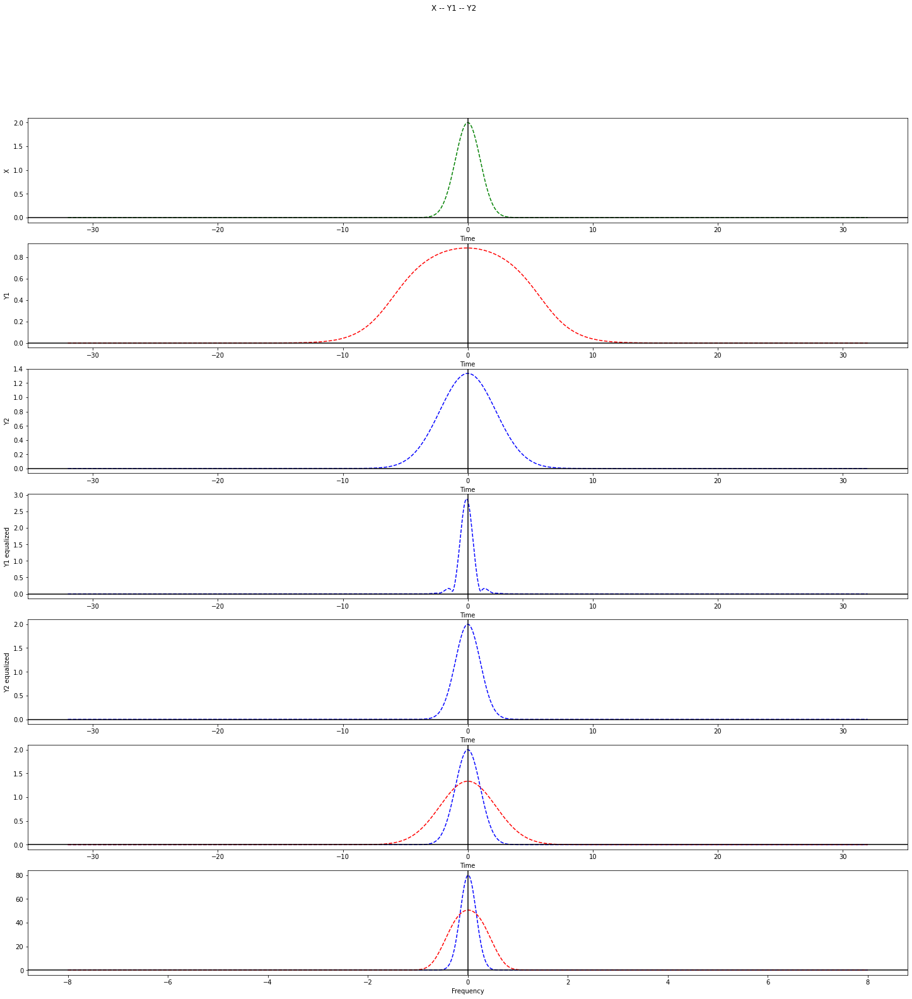

In [45]:
X=None
test(X, parameters)

## **Data generation**

In [33]:
# CUDA : Nicolas boucher

In [54]:
nbrOfObservations = 30000
#X, y = generateDataset(nbrOfObservations, parameters, isGaussian=0)
X, y = generateDataset(nbrOfObservations, parameters, isGaussian=False)

  0%|                                                                              | 1/30000 [00:00<1:25:29,  5.85it/s]

[INFO] Generating the dataset...


100%|██████████████████████████████████████████████████████████████████████████| 30000/30000 [2:38:44<00:00,  3.15it/s]

[INFO] The dataset is ready now !


In [47]:
index = 0

In [56]:
np.savez_compressed('data/data_1_30K_P6e-2.npz', X=X, y=y)

In [58]:
d1= np.load('data/data_1_30K_P6e-2.npz')
d2= np.load('data/data_3_30K_P2.6e-2.npz')
d3= np.load('data/data_2_30K_P5e-2.npz')

In [59]:
X = np.concatenate([d1['X'], d2['X'], d3['X']])
y = np.concatenate([d1['y'], d2['y'], d3['y']])

In [60]:
np.savez_compressed('data/data_1_90K_P6e-2_P5e-2_P2.6e-2.npz', X=X, y=y)

In [61]:
X.shape

(90000, 1024)

In [62]:
y.shape

(90000, 1024)

In [52]:
# Signal : X
X_ = np.absolute(np.squeeze(X[index]))

# NNet generator : y
y_ = np.absolute(np.squeeze(y[index]))

print(X_)
print(y_)

[7.03085884e-16 2.54003485e-02 4.99221621e-02 ... 5.07457882e-02
 2.58187016e-02 5.40660210e-16]
[0.1560736  0.14181651 0.12252471 ... 0.17347891 0.17152821 0.16586142]


In [ ]:
np.savez_compressed('gdrive/My Drive/DL_913/data/data_2.npz', X=X, y=y)

### **Generated Data Visualization**

In [63]:
index = 62561

[channel] qzt : [0.02828574+0.13180335j 0.0314675 +0.13118617j 0.03331096+0.12539861j ...
 0.01696819+0.10599869j 0.02137661+0.11915009j 0.02486673+0.12762874j]
[channel] qzf : [-15.07338056 +31.54364522j  48.65948066 -94.21161003j
 -89.89972251+125.24417961j ...  69.74039813 +15.89897104j
 -28.66361399 -46.6482428j   10.28698844 +25.01666913j]
[Equalizer] qzte : [-4.32455072e-10+6.18600304e-09j  1.46931918e-02-9.92564514e-03j
  2.88658037e-02-1.95179939e-02j ...  4.02236199e-02-1.27362930e-02j
  2.04602489e-02-6.48239425e-03j -5.48757884e-09+6.34793690e-09j]
[Equalizer] qzfe : [-15.07338056 +31.54364522j  47.74919618 -94.6762208j
 -85.00555919+128.61617138j ...  70.85559806  +9.79717481j
 -30.44030548 -45.50878076j  10.5276247  +24.91635976j]
[Equalizer] qzte : [0.02008143-0.01257037j 0.03180948-0.01918195j 0.04762833-0.02800441j ...
 0.01200913-0.01314162j 0.00370237-0.01607131j 0.00956924-0.01181726j]
[Equalizer] qzfe : [ 89.7704838  +11.76060019j -72.37385523 -23.65602258j
  64.729

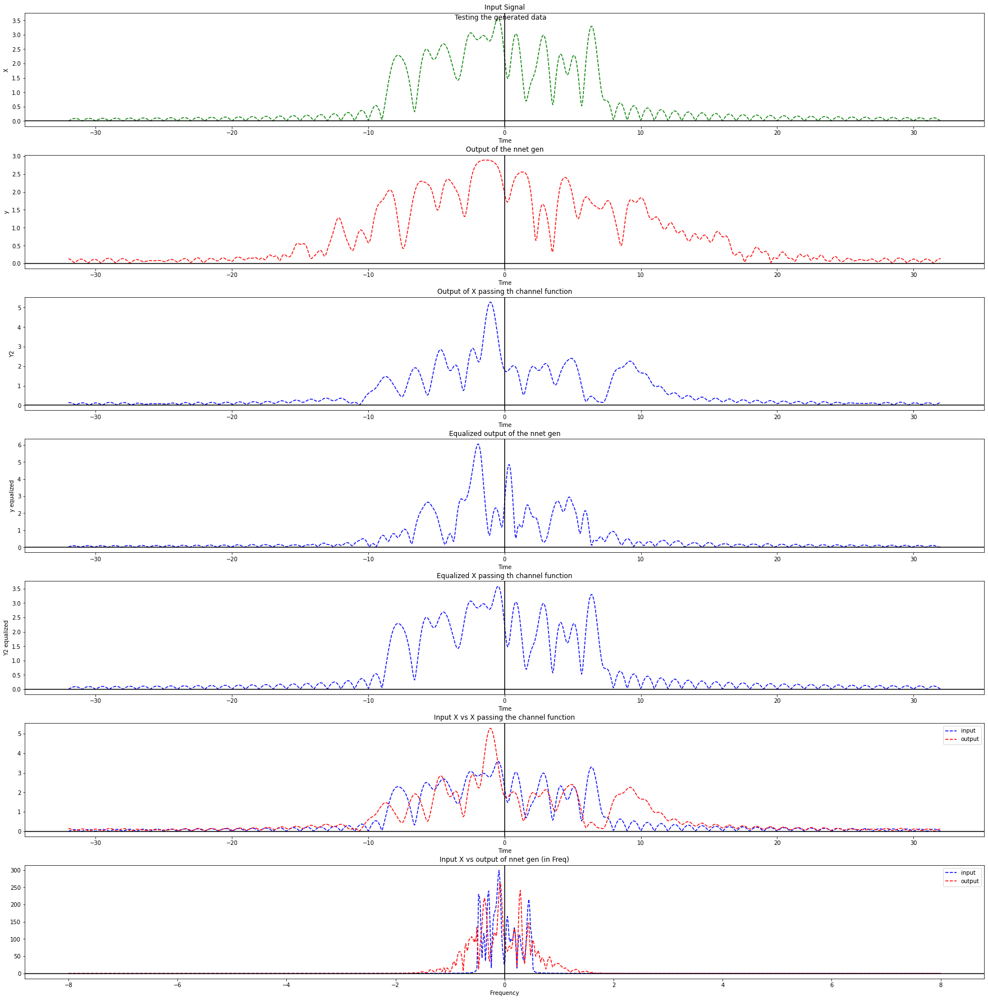

In [64]:
test_generated(X, y, index, parameters)

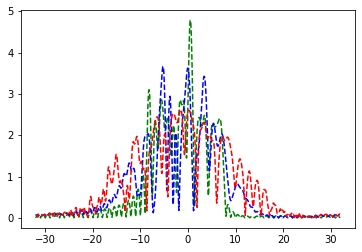

In [ ]:
from matplotlib.pyplot import plot
from numpy import abs
from numpy.fft import fft, ifft, fftshift 
t = parameters.t
#plot(t, np.squeeze(abs(X)))


f = parameters.f 
w = fftshift(2*np.pi*f)
Y1 = ifft(fft(X)*np.exp(1j*w**2))
Y2 = nnetGen.nnet_gen_old(X) 
plot(t, np.squeeze(abs(X)), 'g--')
plot(t, np.squeeze(abs(Y1)), 'b--')
plot(t, np.squeeze(abs(Y2)), 'r--')

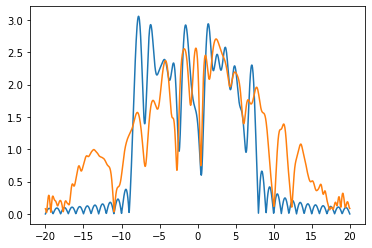

In [ ]:
plot(t, np.squeeze(abs(X)))
plot(t, np.squeeze(abs(y)))

In [ ]:
np.linalg.norm(X) - np.linalg.norm(Y1)

0.0

[]

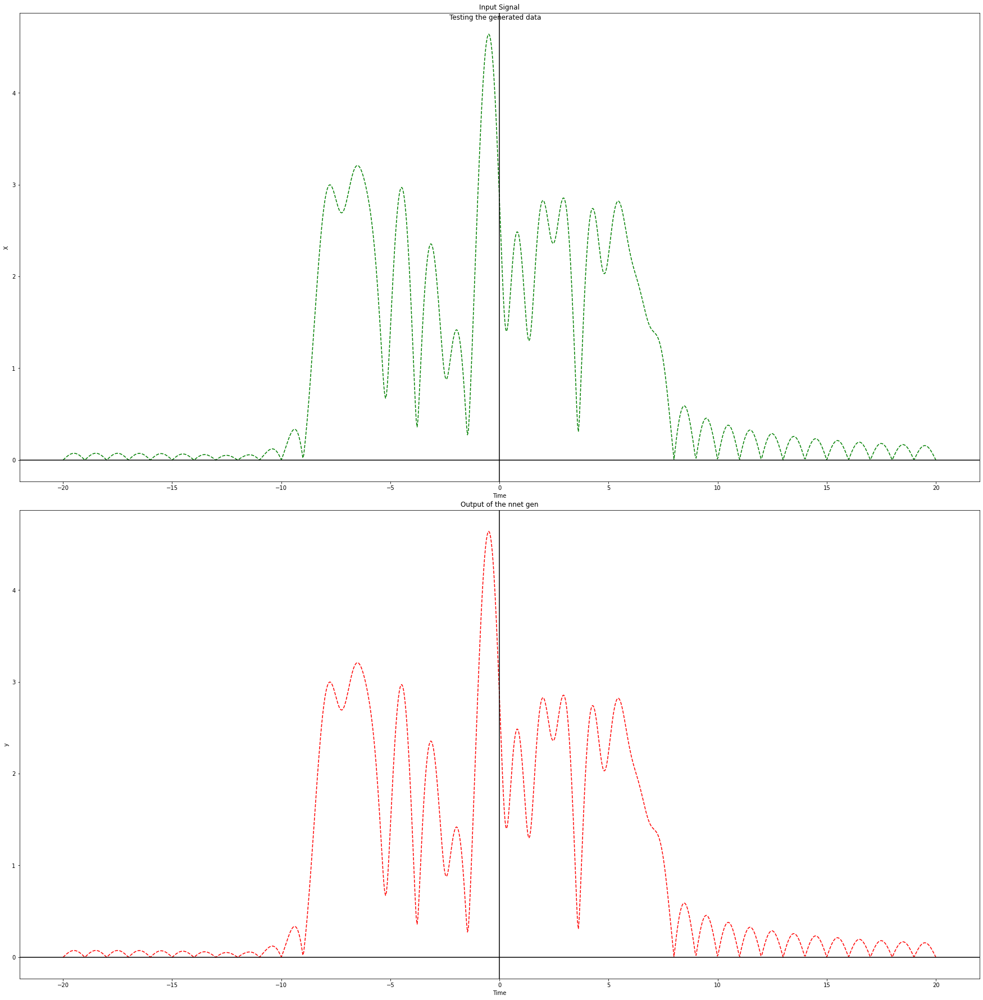

In [ ]:
    #Plots
    
    fig, (ax1, ax2) = plt.subplots(2, figsize = (25, 25))
    #fig = plt.figure(figsize=(25, 25))
    fig.tight_layout(pad=3.0)
    # Input signal
    fig.suptitle('Testing the generated data')
    ax1.set_xlabel('Time')
    ax1.set_ylabel('X')
    ax1.set_title("Input Signal")
    ax1.plot(parameters.t, np.squeeze(np.abs(X[index])), 'g--')
    ax1.axhline(y=0, color='black')
    ax1.axvline(x=0, color='black')

    # NNet generator
    ax2.set_xlabel('Time')
    ax2.set_ylabel('y')
    ax2.set_title("Output of the nnet gen")
    ax2.plot(parameters.t, np.squeeze(np.abs(y[index])), 'r--')
    ax2.axhline(y=0, color='black')
    ax2.axvline(x=0, color='black')

    plt.plot()

In [ ]:
X

array([[3.29636906e-16+3.39175889e-16j, 1.58647648e-02+7.93419875e-03j,
        3.15711029e-02+1.57887399e-02j, ...,
        1.71814998e-02+2.11290093e-02j, 8.64419257e-03+1.06153042e-02j,
        2.89160310e-16-3.61148686e-16j]])

In [ ]:
y

array([[ 1.03890746e-15-4.47881917e-16j,  1.88427218e-03+1.76377944e-02j,
         3.68469891e-03+3.51061510e-02j, ...,
        -8.53461297e-03+2.58611553e-02j, -4.26686907e-03+1.30077122e-02j,
        -6.71570073e-15-4.21966775e-15j]])

In [ ]:
np.sum(X[index]-y[index])

(-114.45473872655651-116.72053936808574j)

In [ ]:
np.sum(y[index])

(114.95529460501282+41.75022013827219j)

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


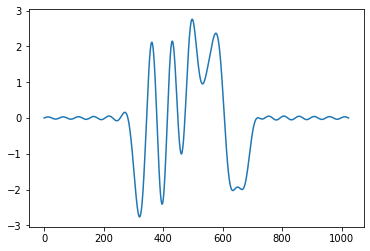

In [ ]:
plt.plot(X[index])

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


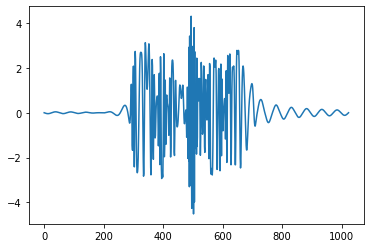

In [ ]:
plt.plot(y[index])

## **Data import and preparation**

In [ ]:
d1= load('gdrive/My Drive/DL_913/data/data_1.npz')
d2= load('gdrive/My Drive/DL_913/data/data_2.npz')
d3= load('gdrive/My Drive/DL_913/data/data_3.npz')
d4= load('gdrive/My Drive/DL_913/data/data_4.npz')
d5= load('gdrive/My Drive/DL_913/data/data_5.npz')
d6= load('gdrive/My Drive/DL_913/data/data_6.npz')

In [ ]:
X = np.concatenate([d1['X'], d2['X'], d3['X'], d4['X'], d5['X'], d6['X']])
y = np.concatenate([d1['y'], d2['y'], d3['y'], d4['y'], d5['y'], d6['y']])

In [ ]:
file_saved_name = "gdrive/My Drive/DL_913/data/30K.npz"
np.savez_compressed(file_saved_name, X=X, y=y)

In [ ]:
X.shape

(30000, 1024)

In [ ]:
X

array([[ 9.28770049e-17+7.17687318e-18j, -3.07468946e-03+1.91017146e-02j,
        -6.13014489e-03+3.80016505e-02j, ...,
         6.74018026e-03+3.57966641e-02j,  3.38042610e-03+1.79958618e-02j,
        -3.52845878e-16+8.41640575e-16j],
       [-2.30059282e-17+1.76400188e-16j,  2.50988827e-02+1.01541154e-02j,
         4.99436729e-02+2.02109753e-02j, ...,
         4.29506951e-02+1.38565099e-02j,  2.15931447e-02+6.96832409e-03j,
         4.79976163e-16+2.21872671e-16j],
       [ 4.42613888e-16+4.08168131e-16j,  1.48389571e-02+1.93673620e-04j,
         2.95191930e-02+3.67415396e-04j, ...,
         2.79192609e-02+8.12192864e-04j,  1.40351835e-02+4.14820442e-04j,
        -8.22760637e-17+2.85223062e-16j],
       ...,
       [-2.90130180e-18+6.84115370e-16j,  1.02543078e-02+1.67319968e-02j,
         2.03894121e-02+3.33092533e-02j, ...,
         2.82491358e-02+2.04427121e-02j,  1.41975538e-02+1.02788116e-02j,
         8.81002301e-16-2.03421613e-16j],
       [ 4.77799658e-16+3.63844425e-16j,  7.

In [ ]:
y

array([[ 2.51223671e-15+1.46719153e-15j, -1.77405851e-02+7.72015899e-03j,
        -3.53348222e-02+1.52693960e-02j, ...,
        -2.65464012e-02+2.49423290e-02j, -1.33249679e-02+1.25588038e-02j,
        -3.12594316e-15-6.35751186e-16j],
       [-4.00451639e-16-1.01574898e-15j,  4.97757736e-03+2.66135998e-02j,
         9.67017583e-03+5.30032233e-02j, ...,
         1.13686914e-02+4.36751409e-02j,  5.78059506e-03+2.19409699e-02j,
         5.21893874e-15+8.97686229e-16j],
       [-1.82220399e-16+2.87407291e-16j,  7.84900528e-03+1.25946526e-02j,
         1.55964527e-02+2.50652830e-02j, ...,
         1.43640458e-02+2.39545189e-02j,  7.22943675e-03+1.20371798e-02j,
        -3.76318999e-16+2.80466826e-16j],
       ...,
       [-7.50175386e-15-3.99625838e-15j, -8.55267018e-03+1.76624567e-02j,
        -1.71194812e-02+3.51021060e-02j, ...,
        -2.02353708e-03+3.48112547e-02j, -9.89103646e-04+1.74998907e-02j,
         1.48141749e-15+1.09838831e-15j],
       [ 2.45816866e-15+2.24990136e-15j,  1.

In [ ]:
index = 5450

[channel] qzt : [0.11414475-0.00488078j 0.10806337-0.0072388j  0.1002811 -0.00967259j ...
 0.12400867+0.00394506j 0.1223721 +0.00099819j 0.11886635-0.00207856j]
[channel] qzf : [ 152.97858204-257.15221426j -193.36667745+314.4489497j
   91.58061314-135.21724346j ...  -99.08850513 +25.95192865j
   97.52041005 +47.24929495j -103.04626727 +55.02447829j]
[Equalizer] qzte : [ 5.55111512e-16-4.44089210e-16j -1.25424747e-03-1.01246959e-02j
 -2.48073946e-03-2.01232084e-02j ... -1.16650818e-02-2.19504431e-02j
 -5.86178945e-03-1.10409537e-02j -2.22044605e-16-4.44089210e-16j]
[Equalizer] qzfe : [ 152.97858204-257.15221426j -185.54988935+319.12388265j
   77.81118438-143.5831857j  ...  -90.93954125 +47.13845867j
  101.7015781  +37.4100957j  -101.6573644  +57.55003625j]
[Equalizer] qzte : [-1.91002977-0.89663639j -1.69675376-1.29641184j -1.01980105-0.59910862j
 ... -0.00930768+0.92923507j -0.63731946+1.22009844j
 -1.37433663+0.44625637j]
[Equalizer] qzfe : [   9.08040681 +67.1942661j    69.51847501-1

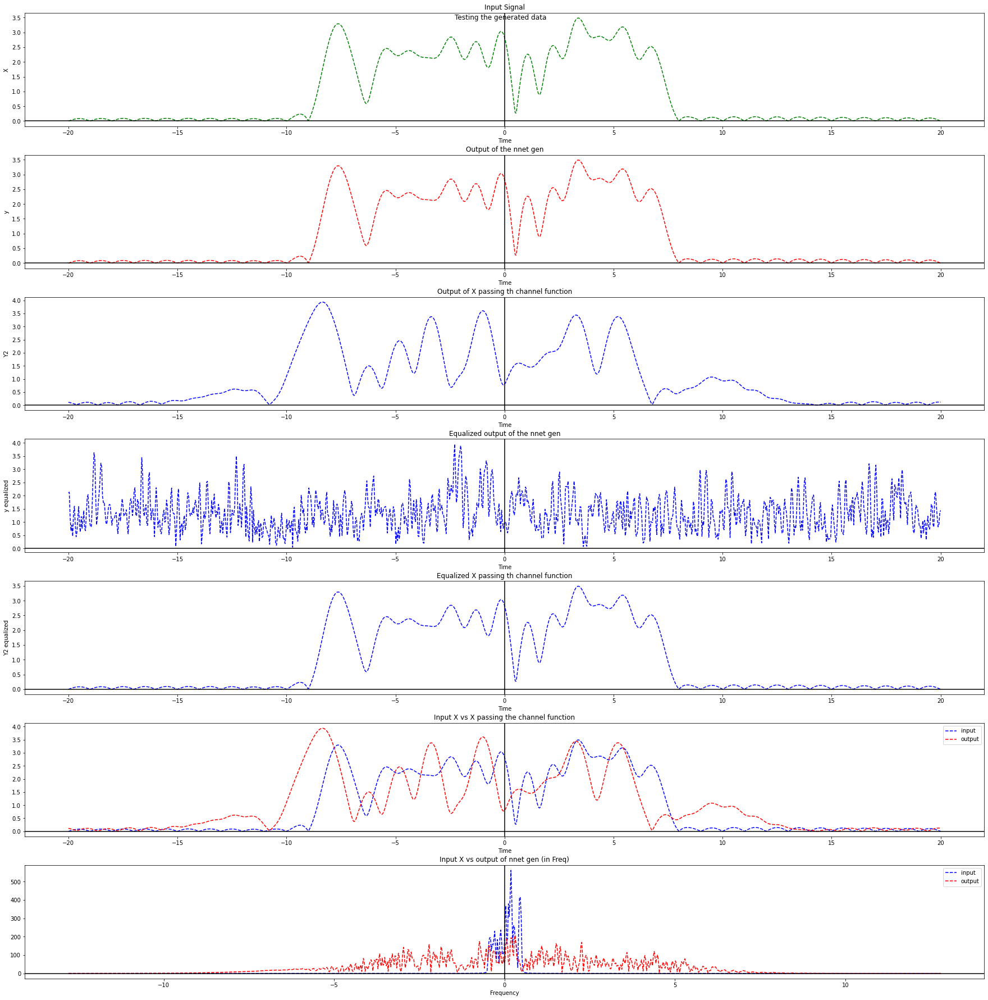

In [ ]:
test_generated(X, y, index, parameters)

In [ ]:
y_ = y[index].reshape(-1,1)

In [ ]:
y_.shape

(1024, 1)

In [ ]:
vect_real = fromComplexToReal(y_.T)
vect_im = fromRealToComplex(vect_real)

{fromComplexToReal} vect_real.shape :  (1, 2048)
{fromRealToComplex} vect_im.shape :  (1, 1024)


In [ ]:
y_

array([[-0.00041527+0.00022787j],
       [-0.0004775 +0.00022187j],
       [ 0.00033761-0.00020924j],
       ...,
       [-0.00034031+0.00019049j],
       [ 0.00048045-0.00024254j],
       [ 0.00041529-0.00020734j]])

In [ ]:
vect_real_ = vect_real.reshape(-1,1)
vect_real_

array([[-0.00041527],
       [ 0.00022787],
       [-0.0004775 ],
       ...,
       [-0.00024254],
       [ 0.00041529],
       [-0.00020734]])

In [ ]:
vect_im_ = vect_im.reshape(-1,1)
vect_im_

array([[-0.00041527+0.00022787j],
       [-0.0004775 +0.00022187j],
       [ 0.00033761-0.00020924j],
       ...,
       [-0.00034031+0.00019049j],
       [ 0.00048045-0.00024254j],
       [ 0.00041529-0.00020734j]])

In [ ]:
np_array_load = 0

In [ ]:
if np_array_load:
  X= load('gdrive/My Drive/DL_913/data/Source data/X_data.npy')
  y= load('gdrive/My Drive/DL_913/data/Source data/y_data.npy')
else :
  df = pd.read_csv('gdrive/My Drive/DL_913/data/new_gen/df_60K.csv')

In [ ]:
df.shape

(60000, 4097)

In [ ]:
#check if pandas added index column
if df.shape[1]%2 !=0 :
  df = df.drop(columns=df.columns[0])
  print("New shape : ",df.shape)
else :
  print("Shape : ",df.shape)

New shape :  (60000, 4096)


## **DataFrame init**

In [ ]:
df_ori = prepareDataFrame(X, y, scaling=False)

{fromComplexToReal} vect_real.shape :  (30000, 2048)
{fromComplexToReal} vect_real.shape :  (30000, 2048)
{prepareDataFrame} df_.shape :  (30000, 4096)


In [ ]:
df_ori.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,4056,4057,4058,4059,4060,4061,4062,4063,4064,4065,4066,4067,4068,4069,4070,4071,4072,4073,4074,4075,4076,4077,4078,4079,4080,4081,4082,4083,4084,4085,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
14952,4.895303e-16,5.800875e-16,0.007344,0.002546,0.014600,0.005057,0.021657,0.007493,0.028409,0.009817,0.034752,0.011996,0.040590,0.013995,0.045833,0.015785,0.050399,0.017337,0.054219,0.018629,0.057232,0.019642,0.059389,0.020358,0.060657,0.020768,0.061013,0.020864,0.060449,0.020646,0.058971,0.020117,0.056598,0.019283,0.053363,0.018158,0.049313,0.016759,0.044507,0.015106,...,-0.007366,0.057565,-0.008206,0.063718,-0.008920,0.068884,-0.009488,0.072991,-0.009893,0.075983,-0.010124,0.077822,-0.010172,0.078486,-0.010038,0.077971,-0.009728,0.076289,-0.009254,0.073470,-0.008634,0.069561,-0.007889,0.064624,-0.007042,0.058736,-0.006119,0.051989,-0.005140,0.044488,-0.004126,0.036347,-0.003094,0.027693,-0.002057,0.018657,-0.001023,0.009379,3.786072e-15,9.318229e-16
26067,-1.500767e-16,-4.429124e-16,0.009258,-0.008444,0.018414,-0.016767,0.027329,-0.024844,0.035866,-0.032552,0.043897,-0.039774,0.051297,-0.046402,0.057952,-0.052335,0.063760,-0.057482,0.068628,-0.061765,0.072480,-0.065120,0.075253,-0.067495,0.076901,-0.068853,0.077394,-0.069173,0.076721,-0.068450,0.074887,-0.066694,0.071914,-0.063932,0.067842,-0.060203,0.062730,-0.055565,0.056648,-0.050086,...,0.140559,0.007644,0.155455,0.009837,0.167913,0.011995,0.177771,0.013930,0.184910,0.015465,0.189253,0.016454,0.190760,0.016804,0.189428,0.016484,0.185290,0.015529,0.178412,0.014033,0.168900,0.012141,0.156895,0.010027,0.142580,0.007870,0.126177,0.005839,0.107940,0.004066,0.088157,0.002632,0.067139,0.001564,0.045213,0.000829,0.022718,0.000346,1.939997e-16,2.325366e-15
7534,-2.112602e-16,-7.053048e-18,-0.013528,-0.024835,-0.026920,-0.049432,-0.039974,-0.073419,-0.052490,-0.096431,-0.064277,-0.118115,-0.075154,-0.138136,-0.084951,-0.156182,-0.093514,-0.171970,-0.100709,-0.185248,-0.106420,-0.195802,-0.110552,-0.203457,-0.113035,-0.208082,-0.113823,-0.209588,-0.112895,-0.207935,-0.110257,-0.203129,-0.105939,-0.195226,-0.099997,-0.184327,-0.092513,-0.170578,-0.083591,-0.154171,...,0.048049,-0.068648,0.053472,-0.075949,0.058097,-0.082078,0.061830,-0.086962,0.064591,-0.090551,0.066319,-0.092807,0.066976,-0.093710,0.066549,-0.093253,0.065052,-0.091443,0.062523,-0.088298,0.059024,-0.083853,0.054636,-0.078160,0.049456,-0.071286,0.043588,-0.063319,0.037143,-0.054369,0.030231,-0.044564,0.022961,-0.034054,0.015434,-0.023002,0.007750,-0.011588,-2.710577e-15,-2.532154e-15
14359,3.454116e-17,-8.373475e-16,-0.012351,-0.021123,-0.024592,-0.042014,-0.036537,-0.062356,-0.048004,-0.081840,-0.058817,-0.100168,-0.068809,-0.117059,-0.077824,-0.132253,-0.085719,-0.145513,-0.092368,-0.156630,-0.097663,-0.165428,-0.101515,-0.171765,-0.103858,-0.175535,-0.104645,-0.176670,-0.103855,-0.175142,-0.101489,-0.170962,-0.097574,-0.164183,-0.092158,-0.154895,-0.085314,-0.143229,-0.077135,-0.129351,...,0.111726,-0.102230,0.124822,-0.111923,0.136071,-0.119763,0.145187,-0.125787,0.151923,-0.130057,0.156091,-0.132640,0.157577,-0.133586,0.156347,-0.132919,0.152453,-0.130630,0.146024,-0.126683,0.137262,-0.121027,0.126425,-0.113615,0.113809,-0.104422,0.099728,-0.093471,0.084494,-0.080840,0.068399,-0.066678,0.051701,-0.051204,0.034619,-0.034703,0.017335,-0.017511,4.028503e-15,-1.397470e-16
14381,-3.831312e-16,5.131326e-16,-0.034634,-0.005843,-0.068927,-0.011648,-0.102361,-0.017324,-0.134427,-0.022786,-0.164632,-0.027950,-0.192510,-0.032734,-0.217630,-0.037063,-0.239596,-0.040868,-0.258061,-0.044086,-0.272726,-0.046664,-0.283350,-0.048558,-0.289749,-0.049733,-0.291806,-0.050164,-0.289464,-0.049840,-0.282735,-0.048758,-0.271697,-0.046929,-0.256492,-0.044372,-0.237327,-0.041122,-0.214469,-0.037220,...,-0.111607,-0.119225,-0.121896,-0.133540,-0.130126,-0.145912,-0.136366,-0.156001,-0.140718,-0.163511,-0.143285,-0.168216,-0.14

In [ ]:
df_ori.shape

(30000, 4096)

### **z-scalar**

In [ ]:
from scipy.stats import zscore

In [ ]:
df_zsc = df_ori.copy()

In [ ]:
df_zsc = df_zsc.apply(zscore)

In [ ]:
df_zsc.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,4056,4057,4058,4059,4060,4061,4062,4063,4064,4065,4066,4067,4068,4069,4070,4071,4072,4073,4074,4075,4076,4077,4078,4079,4080,4081,4082,4083,4084,4085,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
0,0.383589,1.126910,-0.159312,-0.512953,0.159316,0.512985,0.159314,0.512949,-0.159315,-0.512952,-0.159309,-0.512953,0.159307,0.512956,0.159313,0.512957,-0.159316,-0.512948,-0.159322,-0.512933,0.159314,0.512952,0.159312,0.512932,-0.159312,-0.512952,0.159291,0.512950,0.159312,0.512951,-0.159312,-0.512971,-0.159314,-0.512955,0.159305,0.512944,0.159313,0.512949,-0.159315,-0.512949,...,-0.518843,0.138595,0.516770,-0.146243,0.528640,-0.093555,-0.532283,0.069239,-0.534002,0.053984,0.535858,0.027624,0.536191,-0.022010,-0.497142,-0.202773,-0.536588,-0.003361,-0.013212,0.536443,0.536168,0.020976,0.475563,-0.250507,-0.535618,-0.031950,-0.525304,0.111110,0.535405,0.035310,0.534902,-0.043869,-0.535612,-0.032047,-0.536604,0.002215,0.536172,0.020843,0.536075,0.023234
1,0.315756,0.965317,0.633732,-0.631629,-0.633713,0.631601,-0.633734,0.631632,0.633739,-0.631624,0.633731,-0.631627,-0.633731,0.631619,-0.633726,0.631629,0.633735,-0.631632,0.633745,-0.631651,-0.633732,0.631629,-0.633737,0.631622,0.633732,-0.631630,-0.633679,0.631585,-0.633733,0.631628,0.633717,-0.631609,0.633729,-0.631631,-0.633734,0.631640,-0.633737,0.631629,0.633734,-0.631634,...,-0.605696,-0.658690,0.615356,0.649627,0.547064,0.708464,-0.514177,-0.732879,-0.493097,-0.747346,0.374809,0.813747,0.447863,0.775555,-0.087849,-0.892116,-0.410948,-0.795926,-0.803333,0.396404,0.384785,0.809027,0.737128,0.506873,-0.368263,-0.816756,-0.570271,-0.689778,0.363173,0.819055,0.478938,0.756577,-0.368118,-0.816822,-0.419134,-0.791602,0.384986,0.808931,0.381395,0.810645
2,0.448413,0.836870,-0.873051,-0.908544,0.873053,0.908578,0.873053,0.908542,-0.873038,-0.908540,-0.873050,-0.908544,0.873051,0.908548,0.873053,0.908549,-0.873052,-0.908544,-0.873060,-0.908533,0.873051,0.908543,0.873092,0.908542,-0.873052,-0.908544,0.873067,0.908553,0.873052,0.908543,-0.873056,-0.908564,-0.873052,-0.908546,0.873053,0.908539,0.873048,0.908541,-0.873053,-0.908542,...,-0.942602,0.835959,0.930243,-0.849767,1.010290,-0.752138,-1.043360,0.705142,-1.062912,0.675041,1.152061,-0.506238,1.100916,-0.610462,-1.253867,0.098263,-1.128250,0.557787,0.537025,1.138189,1.145767,-0.520471,0.734404,-1.024194,-1.156074,0.496915,-0.984924,0.785312,1.159136,-0.489657,1.075370,-0.654827,-1.156162,0.496707,-1.122459,0.569468,1.145637,-0.520756,1.147928,-0.515640
3,-0.499875,1.492453,0.197558,-1.185457,-0.197585,1.185442,-0.197556,1.185456,0.197553,-1.185437,0.197562,-1.185455,-0.197564,1.185465,-0.197560,1.185461,0.197557,-1.185463,0.197540,-1.185460,-0.197556,1.185457,-0.197575,1.185524,0.197558,-1.185458,-0.197568,1.185535,-0.197558,1.185460,0.197573,-1.185444,0.197559,-1.185461,-0.197552,1.185454,-0.197553,1.185445,0.197557,-1.185466,...,-1.176448,-0.245063,1.179983,0.227624,1.150897,0.345274,-1.133840,-0.397697,-1.121998,-0.430013,1.044097,0.595368,1.094385,0.496297,-0.791506,-0.906544,-1.069804,-0.547521,-0.567052,1.059651,1.051351,0.582374,1.202344,-0.023116,-1.039279,-0.603793,-1.161803,-0.306707,1.035496,0.610304,1.113669,0.451195,-1.039172,-0.603980,-1.075406,-0.536370,1.051495,0.582112,1.048901,0.586803
4,-0.081347,0.181451,0.078602,-1.383253,-0.078605,1.383241,-0.078601,1.383255,0.078606,-1.383258,0.078603,-1.383253,-0.078604,1.383253,-0.078601,1.383250,0.078598,-1.383253,0.078608,-1.383256,-0.078601,1.383254,-0.078561,1.383267,0.078601,-1.383254,-0.078624,1.383253,-0.078600,1.383255,0.078605,-1.383247,0.078601,-1.383250,-0.078602,1.383258,-0.078603,1.383258,0.078597,-1.383253,...,-1.378815,-0.134138,1.380705,0.113715,1.361942,0.252110,-1.348882,-0.314281,-1.339309,-0.352789,1.270486,0.551961,1.315863,0.432174,-1.019557,-0.940180,-1.294027,-0.493934,-0.517573,1.284769,1.277191,0.536175,1.375209,-0.176207,-1.266005,-0.56

### **MaxAbsScaler**

In [ ]:
from sklearn.preprocessing import MaxAbsScaler

In [ ]:
df_masc = df_ori.copy()

In [ ]:
maxAbsScaler = MaxAbsScaler()

In [ ]:
df_masc = maxAbsScaler.fit_transform(df_masc)
df_masc = pd.DataFrame(df_masc)

In [ ]:
df_masc.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,4056,4057,4058,4059,4060,4061,4062,4063,4064,4065,4066,4067,4068,4069,4070,4071,4072,4073,4074,4075,4076,4077,4078,4079,4080,4081,4082,4083,4084,4085,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
0,0.528865,0.638379,0.463768,0.411765,0.536233,0.588239,0.536232,0.588235,0.463767,0.411763,0.463768,0.411764,0.536231,0.588236,0.536232,0.588235,0.463768,0.411766,0.463766,0.411767,0.536232,0.588235,0.536228,0.588226,0.463768,0.411765,0.536226,0.588232,0.536232,0.588235,0.463768,0.411762,0.463768,0.411765,0.536231,0.588234,0.536232,0.588236,0.463768,0.411766,...,0.407806,0.531906,0.590732,0.466495,0.596895,0.485093,0.403900,0.508678,0.404399,0.505993,0.592867,0.508887,0.594547,0.499591,0.436528,0.456368,0.406302,0.495989,0.494266,0.593365,0.593097,0.507092,0.570339,0.450525,0.407282,0.489775,0.402543,0.521958,0.592601,0.511263,0.595270,0.495778,0.407286,0.489745,0.406114,0.496961,0.593102,0.507069,0.593020,0.507532
1,0.521107,0.619552,0.560386,0.398190,0.439616,0.601807,0.439614,0.601810,0.560387,0.398189,0.560386,0.398190,0.439613,0.601809,0.439614,0.601809,0.560387,0.398190,0.560387,0.398188,0.439614,0.601810,0.439609,0.601802,0.560386,0.398190,0.439617,0.601801,0.439614,0.601810,0.560384,0.398192,0.560386,0.398190,0.439614,0.601811,0.439613,0.601811,0.560387,0.398190,...,0.397817,0.434004,0.602046,0.563922,0.599037,0.584384,0.406011,0.409470,0.409183,0.407077,0.573457,0.606129,0.584123,0.597900,0.486789,0.370985,0.421273,0.398160,0.396628,0.576606,0.574913,0.604586,0.600123,0.540436,0.427498,0.392730,0.397321,0.423127,0.571758,0.608155,0.588708,0.594502,0.427519,0.392704,0.420079,0.399027,0.574942,0.604565,0.574419,0.604974
2,0.536280,0.604587,0.376812,0.366516,0.623190,0.633488,0.623189,0.633484,0.376813,0.366515,0.376812,0.366516,0.623188,0.633485,0.623188,0.633484,0.376812,0.366516,0.376810,0.366517,0.623188,0.633484,0.623188,0.633477,0.376812,0.366516,0.623187,0.633482,0.623188,0.633484,0.376810,0.366513,0.376812,0.366516,0.623188,0.633483,0.623188,0.633485,0.376812,0.366517,...,0.359068,0.617539,0.638182,0.380372,0.652885,0.403561,0.344303,0.587328,0.342536,0.582656,0.667134,0.442850,0.661193,0.427057,0.343603,0.493654,0.335801,0.565253,0.562261,0.665382,0.666323,0.440107,0.599813,0.358677,0.332333,0.555172,0.349168,0.605156,0.668081,0.446363,0.658639,0.420426,0.332322,0.555128,0.336466,0.566944,0.666307,0.440067,0.666599,0.440846
3,0.427817,0.680968,0.507246,0.334842,0.492751,0.665156,0.492754,0.665158,0.507245,0.334842,0.507247,0.334842,0.492752,0.665159,0.492753,0.665158,0.507246,0.334841,0.507243,0.334842,0.492754,0.665158,0.492748,0.665159,0.507246,0.334842,0.492749,0.665163,0.492754,0.665158,0.507248,0.334843,0.507247,0.334842,0.492755,0.665158,0.492754,0.665158,0.507246,0.334841,...,0.332173,0.484795,0.666842,0.512262,0.669230,0.539421,0.333752,0.450926,0.335625,0.446248,0.654122,0.579116,0.660422,0.563478,0.400380,0.369198,0.342765,0.428822,0.425826,0.655982,0.654982,0.576546,0.653097,0.477519,0.346442,0.419064,0.328627,0.470399,0.653119,0.582348,0.663130,0.556837,0.346454,0.419023,0.342060,0.430515,0.654999,0.576505,0.654690,0.577273
4,0.475687,0.528226,0.492754,0.312217,0.507247,0.687781,0.507247,0.687783,0.492754,0.312215,0.492754,0.312217,0.507246,0.687783,0.507246,0.687782,0.492753,0.312218,0.492753,0.312217,0.507247,0.687783,0.507247,0.687777,0.492754,0.312217,0.507240,0.687779,0.507247,0.687783,0.492753,0.312218,0.492754,0.312218,0.507246,0.687783,0.507246,0.687784,0.492753,0.312218,...,0.308898,0.498416,0.689876,0.498318,0.693763,0.527887,0.308676,0.461243,0.310207,0.455781,0.681407,0.573747,0.686559,0.555574,0.372376,0.365032,0.316047,0.435436,0.431941,0.682924,0.682110,0.570830,0.672780,0.459345,0.319054,0.424204,0.304488,0.482755,0.680587,0.577385,0.688774,0.547822,0.319064,0.424158,0.315471,0.437413,0.682125,0.570782,0.681872,0.571674


### **StandardScaler**

In [ ]:
# demonstrate data standardization with sklearn
from sklearn.preprocessing import StandardScaler

In [ ]:
df_stc = df_ori.copy()

In [ ]:
# create scaler
scaler = StandardScaler()
# fit and transform in one step
df_stc = scaler.fit_transform(df_stc)

In [ ]:
df_stc = pd.DataFrame(df_stc)
df_stc.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,4056,4057,4058,4059,4060,4061,4062,4063,4064,4065,4066,4067,4068,4069,4070,4071,4072,4073,4074,4075,4076,4077,4078,4079,4080,4081,4082,4083,4084,4085,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
0,0.383589,1.126910,-0.159312,-0.512953,0.159316,0.512985,0.159314,0.512949,-0.159315,-0.512952,-0.159309,-0.512953,0.159307,0.512956,0.159313,0.512957,-0.159316,-0.512948,-0.159322,-0.512933,0.159314,0.512952,0.159312,0.512932,-0.159312,-0.512952,0.159291,0.512950,0.159312,0.512951,-0.159312,-0.512971,-0.159314,-0.512955,0.159305,0.512944,0.159313,0.512949,-0.159315,-0.512949,...,-0.518843,0.138595,0.516770,-0.146243,0.528640,-0.093555,-0.532283,0.069239,-0.534002,0.053984,0.535858,0.027624,0.536191,-0.022010,-0.497142,-0.202773,-0.536588,-0.003361,-0.013212,0.536443,0.536168,0.020976,0.475563,-0.250507,-0.535618,-0.031950,-0.525304,0.111110,0.535405,0.035310,0.534902,-0.043869,-0.535612,-0.032047,-0.536604,0.002215,0.536172,0.020843,0.536075,0.023234
1,0.315756,0.965317,0.633732,-0.631629,-0.633713,0.631601,-0.633734,0.631632,0.633739,-0.631624,0.633731,-0.631627,-0.633731,0.631619,-0.633726,0.631629,0.633735,-0.631632,0.633745,-0.631651,-0.633732,0.631629,-0.633737,0.631622,0.633732,-0.631630,-0.633679,0.631585,-0.633733,0.631628,0.633717,-0.631609,0.633729,-0.631631,-0.633734,0.631640,-0.633737,0.631629,0.633734,-0.631634,...,-0.605696,-0.658690,0.615356,0.649627,0.547064,0.708464,-0.514177,-0.732879,-0.493097,-0.747346,0.374809,0.813747,0.447863,0.775555,-0.087849,-0.892116,-0.410948,-0.795926,-0.803333,0.396404,0.384785,0.809027,0.737128,0.506873,-0.368263,-0.816756,-0.570271,-0.689778,0.363173,0.819055,0.478938,0.756577,-0.368118,-0.816822,-0.419134,-0.791602,0.384986,0.808931,0.381395,0.810645
2,0.448413,0.836870,-0.873051,-0.908544,0.873053,0.908578,0.873053,0.908542,-0.873038,-0.908540,-0.873050,-0.908544,0.873051,0.908548,0.873053,0.908549,-0.873052,-0.908544,-0.873060,-0.908533,0.873051,0.908543,0.873092,0.908542,-0.873052,-0.908544,0.873067,0.908553,0.873052,0.908543,-0.873056,-0.908564,-0.873052,-0.908546,0.873053,0.908539,0.873048,0.908541,-0.873053,-0.908542,...,-0.942602,0.835959,0.930243,-0.849767,1.010290,-0.752138,-1.043360,0.705142,-1.062912,0.675041,1.152061,-0.506238,1.100916,-0.610462,-1.253867,0.098263,-1.128250,0.557787,0.537025,1.138189,1.145767,-0.520471,0.734404,-1.024194,-1.156074,0.496915,-0.984924,0.785312,1.159136,-0.489657,1.075370,-0.654827,-1.156162,0.496707,-1.122459,0.569468,1.145637,-0.520756,1.147928,-0.515640
3,-0.499875,1.492453,0.197558,-1.185457,-0.197585,1.185442,-0.197556,1.185456,0.197553,-1.185437,0.197562,-1.185455,-0.197564,1.185465,-0.197560,1.185461,0.197557,-1.185463,0.197540,-1.185460,-0.197556,1.185457,-0.197575,1.185524,0.197558,-1.185458,-0.197568,1.185535,-0.197558,1.185460,0.197573,-1.185444,0.197559,-1.185461,-0.197552,1.185454,-0.197553,1.185445,0.197557,-1.185466,...,-1.176448,-0.245063,1.179983,0.227624,1.150897,0.345274,-1.133840,-0.397697,-1.121998,-0.430013,1.044097,0.595368,1.094385,0.496297,-0.791506,-0.906544,-1.069804,-0.547521,-0.567052,1.059651,1.051351,0.582374,1.202344,-0.023116,-1.039279,-0.603793,-1.161803,-0.306707,1.035496,0.610304,1.113669,0.451195,-1.039172,-0.603980,-1.075406,-0.536370,1.051495,0.582112,1.048901,0.586803
4,-0.081347,0.181451,0.078602,-1.383253,-0.078605,1.383241,-0.078601,1.383255,0.078606,-1.383258,0.078603,-1.383253,-0.078604,1.383253,-0.078601,1.383250,0.078598,-1.383253,0.078608,-1.383256,-0.078601,1.383254,-0.078561,1.383267,0.078601,-1.383254,-0.078624,1.383253,-0.078600,1.383255,0.078605,-1.383247,0.078601,-1.383250,-0.078602,1.383258,-0.078603,1.383258,0.078597,-1.383253,...,-1.378815,-0.134138,1.380705,0.113715,1.361942,0.252110,-1.348882,-0.314281,-1.339309,-0.352789,1.270486,0.551961,1.315863,0.432174,-1.019557,-0.940180,-1.294027,-0.493934,-0.517573,1.284769,1.277191,0.536175,1.375209,-0.176207,-1.266005,-0.56

### **MinMax Scaler**

In [ ]:
from sklearn.preprocessing import MinMaxScaler

In [ ]:
df_minmax = df_ori.copy()

In [ ]:
scaler = MinMaxScaler()

In [ ]:
df_minmax = scaler.fit_transform(df_minmax)

In [ ]:
df_minmax = pd.DataFrame(df_minmax)
df_minmax.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,4056,4057,4058,4059,4060,4061,4062,4063,4064,4065,4066,4067,4068,4069,4070,4071,4072,4073,4074,4075,4076,4077,4078,4079,4080,4081,4082,4083,4084,4085,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
0,0.662430,0.702975,0.575934,0.498783,0.575922,0.498729,0.575910,0.498674,0.575898,0.498619,0.575885,0.498564,0.575872,0.498509,0.575860,0.498453,0.575847,0.498397,0.575833,0.498340,0.575820,0.498283,0.575806,0.498226,0.575792,0.498169,0.575778,0.498111,0.575764,0.498052,0.575750,0.497994,0.575735,0.497935,0.575720,0.497876,0.575705,0.497816,0.575690,0.497756,...,0.483479,0.611947,0.481630,0.612980,0.479984,0.613982,0.480956,0.614882,0.487666,0.614814,0.491757,0.613262,0.493274,0.612701,0.492248,0.613178,0.488679,0.614648,0.482550,0.614963,0.480288,0.614071,0.482001,0.613062,0.483918,0.612010,0.485943,0.610977,0.487969,0.610017,0.483864,0.605645,0.478086,0.596596,0.473883,0.590191,0.471350,0.586385,0.695930,0.602862
1,0.447651,0.347500,0.594316,0.399322,0.594334,0.399455,0.594352,0.399588,0.594369,0.399722,0.594387,0.399857,0.594405,0.399993,0.594423,0.400129,0.594441,0.400266,0.594460,0.400404,0.594478,0.400542,0.594496,0.400681,0.594515,0.400821,0.594533,0.400961,0.594552,0.401103,0.594571,0.401245,0.594590,0.401388,0.594609,0.401531,0.594628,0.401676,0.594647,0.401821,...,0.719732,0.533868,0.716981,0.536012,0.714898,0.537891,0.714725,0.539426,0.718041,0.539867,0.720093,0.538782,0.720782,0.538365,0.720078,0.538672,0.718012,0.539658,0.714684,0.539421,0.713788,0.537900,0.715520,0.536044,0.717888,0.533930,0.720838,0.531654,0.724204,0.529335,0.718778,0.524067,0.710982,0.514909,0.705438,0.508321,0.702102,0.504359,0.517127,0.720222
2,0.427106,0.498954,0.375494,0.250992,0.375502,0.250868,0.375510,0.250742,0.375519,0.250616,0.375528,0.250490,0.375537,0.250363,0.375546,0.250235,0.375555,0.250107,0.375565,0.249978,0.375574,0.249848,0.375584,0.249718,0.375594,0.249587,0.375605,0.249456,0.375615,0.249323,0.375626,0.249191,0.375637,0.249057,0.375649,0.248923,0.375660,0.248788,0.375672,0.248653,...,0.571983,0.414544,0.570326,0.413472,0.569013,0.412067,0.569988,0.410526,0.575752,0.408576,0.579303,0.406174,0.580626,0.405178,0.579725,0.405697,0.576617,0.407632,0.571334,0.409361,0.569274,0.410557,0.570607,0.411645,0.572265,0.412425,0.574198,0.412783,0.576302,0.412701,0.571323,0.409870,0.564485,0.403559,0.559564,0.398889,0.556613,0.395983,0.372546,0.311134
3,0.509646,0.210440,0.386797,0.284579,0.386742,0.284611,0.386686,0.284643,0.386631,0.284676,0.386574,0.284708,0.386518,0.284741,0.386461,0.284774,0.386404,0.284807,0.386347,0.284840,0.386289,0.284873,0.386231,0.284906,0.386172,0.284940,0.386114,0.284973,0.386054,0.285007,0.385995,0.285041,0.385935,0.285075,0.385875,0.285109,0.385814,0.285143,0.385754,0.285177,...,0.673683,0.362022,0.672930,0.362085,0.672598,0.361661,0.674049,0.360924,0.679031,0.359650,0.682114,0.357830,0.683210,0.357121,0.682293,0.357632,0.679398,0.359267,0.674622,0.360575,0.672177,0.361243,0.672341,0.361630,0.672897,0.361559,0.673877,0.360958,0.675224,0.359867,0.668483,0.356365,0.659791,0.349941,0.653545,0.345155,0.649776,0.342195,0.707997,0.512617
4,0.369392,0.679710,0.172810,0.422856,0.172730,0.422744,0.172651,0.422630,0.172570,0.422516,0.172490,0.422402,0.172409,0.422287,0.172327,0.422172,0.172245,0.422057,0.172163,0.421940,0.172080,0.421824,0.171997,0.421707,0.171913,0.421589,0.171829,0.421472,0.171744,0.421353,0.171659,0.421234,0.171574,0.421115,0.171488,0.420995,0.171402,0.420875,0.171315,0.420754,...,0.316995,0.335440,0.318140,0.331207,0.318968,0.326687,0.322564,0.322323,0.332953,0.318221,0.339254,0.314652,0.341583,0.313265,0.340000,0.314216,0.334492,0.317362,0.324993,0.321243,0.319855,0.325307,0.319266,0.329572,0.318369,0.333594,0.317170,0.337058,0.315735,0.339794,0.310333,0.339790,0.304145,0.336358,0.299494,0.333745,0.296631,0.332085,0.532827,0.416291


## **Train & Test split**

In [ ]:
withReshape = True
ts = 0.25
X_train, X_test, y_train, y_test = prepareTrainAndTestData(df_minmax, withReshape, ts)

[INFO] - {prepareTrainAndTestData} converting from pandas to numpy...
(30000, 2048)
(30000, 2048)
(22500, 2048, 1)
(22500, 2048, 1)
(7500, 2048, 1)
(7500, 2048, 1)


In [ ]:
df_minmax

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,4056,4057,4058,4059,4060,4061,4062,4063,4064,4065,4066,4067,4068,4069,4070,4071,4072,4073,4074,4075,4076,4077,4078,4079,4080,4081,4082,4083,4084,4085,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
0,0.394057,0.329213,0.289773,0.573932,0.289775,0.573980,0.289778,0.574028,0.289780,0.574077,0.289782,0.574126,0.289784,0.574175,0.289787,0.574225,0.289789,0.574274,0.289792,0.574325,0.289794,0.574375,0.289796,0.574426,0.289799,0.574477,0.289801,0.574528,0.289804,0.574580,0.289806,0.574632,0.289809,0.574684,0.289812,0.574737,0.289814,0.574790,0.289817,0.574843,...,0.337434,0.308137,0.340106,0.311595,0.342311,0.314246,0.344003,0.316118,0.345185,0.317326,0.345882,0.318013,0.346121,0.318298,0.345917,0.318231,0.345261,0.317781,0.344134,0.316847,0.342513,0.315296,0.340396,0.313018,0.337822,0.309978,0.334888,0.306255,0.331756,0.302064,0.328649,0.297744,0.325832,0.293728,0.323574,0.290473,0.322112,0.289443,0.457717,0.615677
1,0.468003,0.563030,0.574311,0.388946,0.574303,0.389037,0.574295,0.389130,0.574286,0.389222,0.574278,0.389315,0.574270,0.389409,0.574261,0.389503,0.574253,0.389597,0.574244,0.389692,0.574235,0.389788,0.574227,0.389884,0.574218,0.389980,0.574209,0.390077,0.574200,0.390175,0.574191,0.390273,0.574182,0.390371,0.574173,0.390470,0.574164,0.390570,0.574155,0.390670,...,0.667384,0.440495,0.667424,0.446375,0.667568,0.451402,0.667767,0.455422,0.667961,0.458360,0.668092,0.460193,0.668115,0.460928,0.668014,0.460572,0.667801,0.459136,0.667518,0.456628,0.667219,0.453082,0.666963,0.448572,0.666797,0.443244,0.666747,0.437333,0.666813,0.431176,0.666966,0.425197,0.667161,0.419877,0.667341,0.415698,0.667452,0.413948,0.503053,0.387598
2,0.517082,0.614866,0.733406,0.401431,0.733363,0.401349,0.733320,0.401266,0.733277,0.401183,0.733234,0.401099,0.733191,0.401015,0.733147,0.400930,0.733103,0.400844,0.733060,0.400758,0.733015,0.400671,0.732971,0.400583,0.732926,0.400495,0.732882,0.400407,0.732837,0.400317,0.732792,0.400227,0.732746,0.400137,0.732701,0.400045,0.732655,0.399953,0.732609,0.399861,...,0.700676,0.654804,0.699358,0.660519,0.698287,0.665686,0.697472,0.670040,0.696896,0.673362,0.696533,0.675486,0.696360,0.676310,0.696365,0.675805,0.696552,0.674013,0.696941,0.671045,0.697554,0.667072,0.698405,0.662311,0.699485,0.657017,0.700755,0.651477,0.702139,0.646004,0.703529,0.640926,0.704792,0.636572,0.705793,0.633247,0.706412,0.631747,0.564620,0.402755
3,0.367942,0.284406,0.354528,0.143380,0.354508,0.143367,0.354488,0.143354,0.354468,0.143342,0.354448,0.143328,0.354428,0.143315,0.354407,0.143302,0.354387,0.143288,0.354366,0.143274,0.354345,0.143260,0.354324,0.143246,0.354302,0.143232,0.354281,0.143218,0.354259,0.143203,0.354237,0.143188,0.354214,0.143173,0.354192,0.143158,0.354169,0.143142,0.354146,0.143127,...,0.719906,0.176566,0.728431,0.187766,0.736322,0.197482,0.743103,0.205351,0.748343,0.211150,0.751696,0.214757,0.752937,0.216117,0.751986,0.215223,0.748924,0.212105,0.743979,0.206833,0.737493,0.199541,0.729890,0.190449,0.721634,0.179897,0.713201,0.168373,0.705064,0.156520,0.697672,0.145118,0.691438,0.135033,0.686719,0.127117,0.683789,0.123408,0.544841,0.668556
4,0.143315,0.308790,0.343187,0.560249,0.343258,0.560360,0.343330,0.560471,0.343401,0.560582,0.343473,0.560694,0.343546,0.560806,0.343618,0.560919,0.343691,0.561033,0.343764,0.561147,0.343838,0.561262,0.343911,0.561377,0.343986,0.561493,0.344060,0.561609,0.344135,0.561726,0.344210,0.561843,0.344285,0.561962,0.344361,0.562080,0.344437,0.562200,0.344514,0.562319,...,0.403721,0.272033,0.406678,0.276485,0.409205,0.280003,0.411215,0.282586,0.412659,0.284329,0.413518,0.285367,0.413786,0.285813,0.413466,0.285718,0.412564,0.285053,0.411090,0.283720,0.409070,0.281600,0.406550,0.278601,0.403612,0.274714,0.400385,0.270060,0.397044,0.264908,0.393808,0.259663,0.390923,0.254832,0.388635,0.250945,0.387152,0.249591,0.365253,0.425163
...,...,...,...,...,...,...,...,...,...,...,...,...,...

In [ ]:
x_ = df_minmax.iloc[0:1 , 0:2048]
x_.shape

(1, 2048)

In [ ]:
x_ = fromRealToComplex(x_.to_numpy())

{fromRealToComplex} vect_im.shape :  (1, 1024)


In [ ]:
test(x_, parameters)

In [ ]:
mid = X_train.shape[1]

In [ ]:
#-----------------------------------------------------------------------------------------#

def test_complex2real(y, index, mid, parameter):


    y__ = y[index-1:index,:mid].reshape(1,-1,1)
    vect_real = fromComplexToReal(y__)
    vect_im = fromRealToComplex(vect_real)
    
    y__ = y__.reshape(-1,1)
    vect_im = vect_im.reshape(-1,1)

    #Plots
    fig = plt.figure(figsize=(15, 15))
    
    # y_test vs y_pred
    ax = fig.add_subplot(111)
    ax.set_xlabel('Time')
    ax.plot(parameter.t, np.squeeze(y__.T), 'b--', label='test')
    ax.plot(parameter.t, np.squeeze(vect_im.T), 'r--', label='predicted')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')

    plt.show()
    
#-----------------------------------------------------------------------------------------#

def test_real2complex(y, index, mid, parameter):


    y__ = y[index-1:index,:mid].reshape(1,-1,1) 
    vect_im = fromRealToComplex(y__)
    vect_real = fromComplexToReal(vect_im)

    y__ = y__.reshape(-1,1)
    vect_real = vect_real.reshape(-1,1)

    #Plots
    fig = plt.figure(figsize=(15, 15))
    
    # y_test vs y_pred
    ax = fig.add_subplot(111)
    ax.set_xlabel('Time')
    ax.plot(np.squeeze(y__.T), 'b--', label='test')
    ax.plot(np.squeeze(vect_real.T), 'r--', label='predicted')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')

    plt.show()
    
#-----------------------------------------------------------------------------------------#

In [ ]:
"""
index = 10
mid = df.shape[1] // 2
test_complex2real(y, index, mid, parameters)
"""

'\nindex = 10\nmid = df.shape[1] // 2\ntest_complex2real(y, index, mid, parameters)\n'

In [ ]:
df = df_minmax

{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromComplexToReal} vect_real.shape :  (1, 2048, 1)


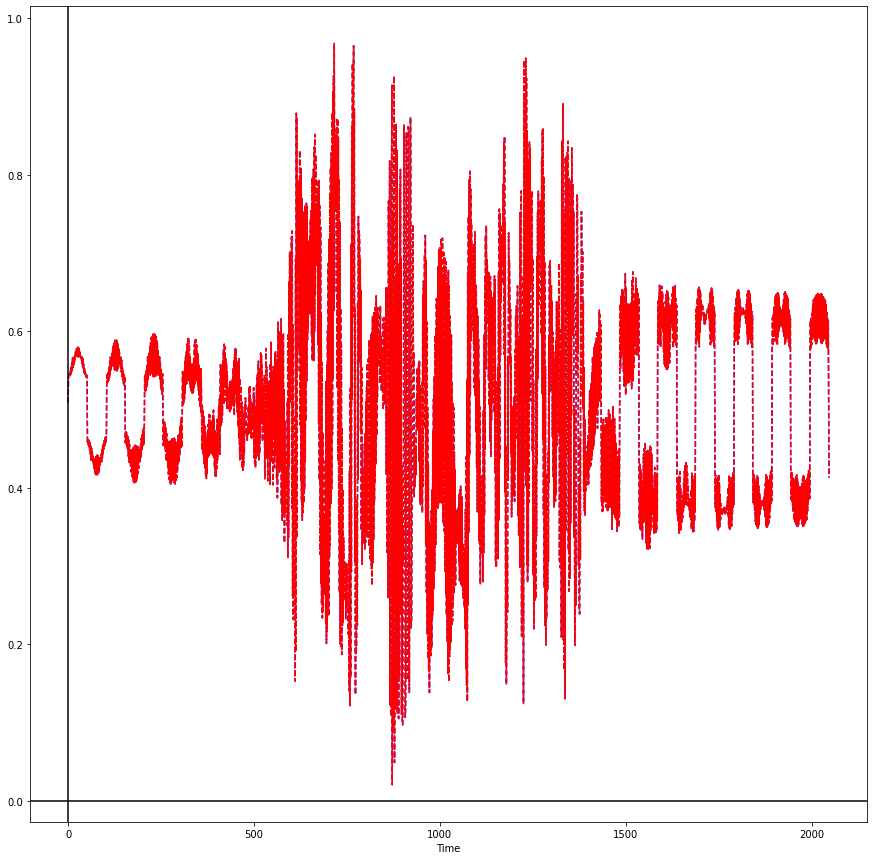

In [ ]:
index = 10
mid = df.shape[1] // 2
test_real2complex(y_test, index, mid, parameters)

# **Model Training & Testing**

In [ ]:
import datetime

import tensorflow as tf

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Embedding, BatchNormalization, Conv1D, Conv2D, Dense, LSTM, Flatten, Dropout
from keras.layers.advanced_activations import LeakyReLU, PReLU
from keras.callbacks import History 
from keras.utils.vis_utils import plot_model

from keras.layers import Activation
from keras.utils.generic_utils import get_custom_objects
from keras import backend as K
from keras.optimizers import Adam

In [ ]:
#-----------------------------------------------------------------------------------------#

def test_prediction(y_test, y_pred, index, parameter):
    
    print("y_pred : ",y_pred)
    print("y_pred.shape : ",y_pred.shape)

    # Original
    y_ = y_test[index].reshape(1,-1,1)
    y_test_im = fromRealToComplex(y_)
    # Predicted
    y_pred = y_pred.reshape(1,-1,1)
    y_pred_im = fromRealToComplex(y_pred)
    
    y_test_im = np.squeeze(y_test_im)
    y_pred_im = np.squeeze(y_pred_im)

    diff = y_ - y_pred
    diff_im = fromRealToComplex(diff)

    y_ = np.squeeze(y_)
    y_pred = np.squeeze(y_pred)
    diff_im = np.squeeze(diff_im)

    


    print("y_test_im.shape : ",y_test_im.shape)
    print("y_pred_im.shape : ",y_pred_im.shape)
    print("y_.shape : ",y_.shape)
    print("y_pred.shape : ",y_pred.shape)
    print("\n")
    print("y_ : ", y_)
    print("y_test_im : ", y_test_im)
    print("y_pred : ", y_pred)
    print("y_pred_im : ", y_pred_im)
    print("diff : ", diff)
    print("\n")

    # Equalizer
    #Y2e, _ = equalizer.equalize(parameter.t, y_test, parameter.z)
    #Y1e, _ = equalizer.equalize(parameter.t, y_pred, parameter.z)

    #Plots
    fig = plt.figure(figsize=(15, 15))
    
    # y_test vs y_pred
    ax = fig.add_subplot(211)
    ax.set_xlabel('Time')
    ax.plot(parameter.t, y_test_im.T, 'b--', label='test')
    ax.plot(parameter.t, y_pred_im.T, 'r--', label='predicted')
   # ax.plot(parameter.t, diff_im.T, 'g--', label='difference')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')

    """
    ax = fig.add_subplot(212)
    ax.set_xlabel('Time')
    ax.plot(y_, 'b--', label='test')
    ax.plot(y_pred, 'r--', label='predicted')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    """

    y_f = np.fft.fft(y_)
    print("y_f : ", y_f)
    print("y_f.shape : ", y_f.shape)
    y_f = y_f.reshape(1,-1,1)
    print("y_f : ", y_f)
    print("y_f.shape : ", y_f.shape)
    y_f_im = fromRealToComplex(y_f)
    print("y_f_im : ", y_f_im)
    print("y_f_im.shape : ", y_f.shape)

    y_pred_f = np.fft.fft(y_pred)
    print("y_pred_f : ", y_pred_f)
    print("y_pred_f.shape : ", y_pred_f.shape)
    y_pred_f = y_pred_f.reshape(1,-1,1)
    print("y_pred_f : ", y_pred_f)
    print("y_pred_f.shape : ", y_pred_f.shape)
    y_pred_f_im = fromRealToComplex(y_pred_f)
    print("y_pred_f_im : ", y_pred_f_im)
    print("y_pred_f_im.shape : ", y_pred_f_im.shape)

    ax = fig.add_subplot(212)
    ax.set_xlabel('Frequency')
    ax.plot(parameter.f, np.squeeze(y_f_im), 'b--', label='test')
    ax.plot(parameter.f, np.squeeze(y_pred_f_im), 'r--', label='predicted')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')
    plt.show()
    
#-----------------------------------------------------------------------------------------#

def test_predicted(y_test, y_pred, index, parameter):

    #X = X_test[index]

    print("y_pred : ",y_pred)
    print("y_pred.shape : ",y_pred.shape)

    # Original
    y_original = y_test[index].reshape(1,-1,1)
    y_test_im = fromRealToComplex(y_original)

    # Predicted
    y_predicted = y_pred.reshape(1,-1,1)
    y_pred_im = fromRealToComplex(y_predicted)
    
    # Getting rid of one dim
    y_test_im = np.squeeze(y_test_im)
    y_pred_im = np.squeeze(y_pred_im)

    # Compute the difference between the test and predicted data
    diff = y_original - y_predicted
    diff_im = fromRealToComplex(diff)

    y_original = np.squeeze(y_original)
    y_predicted = np.squeeze(y_predicted)
    diff_im = np.squeeze(diff_im)

    """
    # Channel
    Y2, _ = channel.channel(parameter.t, X, parameter.z, parameter.sigma2, parameter.B )#0, 0)

    # Equalizer
    Y2e, _ = equalizer.equalize(parameter.t, Y2, parameter.z)
    Y1e, _ = equalizer.equalize(parameter.t, np.squeeze(y), parameter.z)

    # Fourier Transform
    Xf = fftshift(fft(X))
    Yf = fftshift(fft(y))
    """
    #Plots
    
    fig, (ax1) = plt.subplots(1, figsize = (25, 25))
    fig.tight_layout(pad=3.0)

    # Input signal
    fig.suptitle('Testing the predicted data')

    ax1.set_xlabel('Time')
    ax1.plot(parameter.t, np.abs(y_original), 'b--', label='y_test')
    ax1.plot(parameter.t, np.abs(y_predicted), 'r--', label='y_predicted')
    ax1.set_title("Input signal vs predicted signal.")
    ax1.axhline(y=0, color='black')
    ax1.axvline(x=0, color='black')
    ax1.legend()
    
    plt.show()
    
#-----------------------------------------------------------------------------------------#

def test_ypred(y_pred, parameter):
    

    # Predicted
    y_pred = y_pred.reshape(1,-1,1)
    y_pred_im = fromRealToComplex(y_pred)
    
    y_pred_im = np.squeeze(y_pred_im)

    y_pred = np.squeeze(y_pred)

    print("y_pred_im.shape : ",y_pred_im.shape)
    print("y_pred.shape : ",y_pred.shape)
    print("\n")

    # Equalizer
    #Y2e, _ = equalizer.equalize(parameter.t, y_test, parameter.z)
    #Y1e, _ = equalizer.equalize(parameter.t, y_pred, parameter.z)

    #Plots
    fig = plt.figure(figsize=(15, 15))
    
    # y_test vs y_pred
    ax = fig.add_subplot(211)
    ax.set_xlabel('Time')
    ax.plot(parameter.t, y_pred_im.T, 'r--', label='predicted')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')

    ax = fig.add_subplot(212)
    ax.set_xlabel('Time')
    ax.plot(y_pred, 'r--', label='predicted')
    ax.axhline(y=0, color='black')
    ax.axvline(x=0, color='black')

    plt.show()
    
#-----------------------------------------------------------------------------------------#

In [ ]:
#-----------------------------------------------------------------------------------------------------#

def train(model, X_train, X_test, y_train, y_test, Nepochs, batchSize, earlystopping_patience=5) :
  # Fiting the model
  log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
  tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

  earlystopping = tf.keras.callbacks.EarlyStopping(monitor ="val_loss",  
                                        mode ="min", patience = earlystopping_patience,  
                                        restore_best_weights = True) 
  
  model.fit( X_train, y_train, 
            batch_size = batchSize, 
            epochs = Nepochs, 
            verbose = 1, 
            validation_data =(X_test, y_test), 
            callbacks =[history, earlystopping, tensorboard_callback])
  
  return model

#-----------------------------------------------------------------------------------------------------#

def test_model(model, X_test, y_test, history, index_pred, with_error_plots, all_plots=False) :
  with_eval = False
  y_pred = evaluate(model, X_test, y_test, history, index_pred, with_eval, with_error_plots, all_plots)
  return y_pred

#-----------------------------------------------------------------------------------------------------#


def evaluate(model, X_test, y_test, history, index_pred, with_eval, with_error_plots, all_plots=False):

  # evaluating and printing results 
  if with_eval :
    score = model.evaluate(X_test, y_test, verbose = 0) 
    print('Test loss:', score[0]) 
    print('Test accuracy:', score[1]) 

  # Plots
  
  if with_error_plots : 
    plt.plot(history.history['mse'])
    plt.title("mse")
    plt.show()
    plt.plot(history.history['mae'])
    plt.title("mae")
    plt.show()
    plt.plot(history.history['cosine_proximity'])
    plt.title("cosine_proximity")
    plt.show()
    
  # prediction on one element
  X = X_test[index_pred]
  y_pred = model.predict(X)
  print("X_test.shape : ",X_test.shape)
  print("y_test.shape : ",y_test.shape)
  print("X.shape : ",X.shape)
  print("y_pred.shape : ",y_pred.shape)
  print("\n")

  X = X.reshape(-1,1)
  y_pred = y_pred.reshape(-1,1)
  print("After reshaping...")
  print("X.shape : ",X.shape)
  print("y_pred.shape : ",y_pred.shape)

  

  if all_plots:
  
    X_im = fromRealToComplex(X.T)
    y_im = fromRealToComplex(y_pred.T)

    y_qzt, y_qzf = channel.channel(parameters.t, X_im, parameters.z, parameters.sigma02, parameters.B)
    y_gen_equalized_t, y_gen_equalized_f = equalizer.equalize(parameters.t, y_im, parameters.z)
    y_qzt_equalized_t, y_qzt_equalized_f = equalizer.equalize(parameters.t, y_qzt, parameters.z)
    allPlots(y_qzt, y_qzf, y_qzt_equalized_t, y_qzt_equalized_f, y_im, y_gen_equalized_t, y_gen_equalized_f)

  return y_pred

#-----------------------------------------------------------------------------------------------------#

def allPlots(y_qzt, y_qzf, y_qzt_equalized_t, y_qzt_equalized_f, y_pred, y_pred_equalized_t, y_pred_equalized_f):
    
    fig2, (ax1, ax2, ax3, ax4, ax5, ax6, ax7) = plt.subplots(7, figsize = (15, 15))
    fig2.tight_layout(pad=7.0)


    ###
    ax1.plot(parameters.t, np.squeeze(y_qzt.real), 'b-')
    ax1.set_xlabel("Time")
    ax1.set_ylabel("Abs(y_qzt)")
    ax1.set_title("y_test passed in Channel function - Time plot - Re(y_qzt)")

    ###
    ax2.plot(parameters.f, np.squeeze(np.abs(y_qzf)), 'b-')
    ax2.set_xlabel("Freq")
    ax2.set_ylabel("Abs(y_qzf)")
    ax2.set_title("Equalization of y_test- Freq plot - |y_qzf|")

    ###
    ax3.plot(parameters.t, np.squeeze(np.abs(y_qzt_equalized_t)), 'b-')
    ax3.set_xlabel("Time")
    ax3.set_ylabel("Abs(y_qzt_equalized_t)")
    ax3.set_title("Equalization of y_test input in the Channel - Time plot - |y_qzt_equalized_t|")

    ###
    ax4.plot(parameters.f, np.squeeze(np.abs(y_qzt_equalized_f)), 'b-')
    ax4.set_xlabel("Freq")
    ax4.set_ylabel("Abs(y_qzt_equalized_f)")
    ax4.set_title("Equalization of y_test input in the Channel - Freq plot - |y_qzt_equalized_f|")

    ###
    ax5.plot(parameters.t, np.squeeze(np.absolute(y_pred)), 'b-')
    ax5.set_xlabel("Time")
    ax5.set_ylabel("Abs(y_pred)")
    ax5.set_title("Prediction (y_pred) - Time plot - |y_pred|")

    ###
    ax6.plot(parameters.t, np.squeeze(np.abs(y_pred_equalized_t)), 'b-')
    ax6.set_xlabel("Time")
    ax6.set_ylabel("Abs(y_pred_equalized_t)")
    ax6.set_title("Equalization of prediction (y_pred) - Time plot - |y_pred_equalized_t|")

    ###        
    ax7.plot(parameters.f, np.squeeze(np.abs(y_pred_equalized_f)), 'b-')
    ax7.set_xlabel("Freq")
    ax7.set_ylabel("Abs(y_pred_equalized_t)")
    ax7.set_title("Equalization of prediction (y_pred) - Freq plot - |y_pred_equalized_f|")

    plt.show()

#-----------------------------------------------------------------------------------------------------#

def all_evals(model, index_pred):

  with_error_plots = False
  with_eval = False
  y_pred = evaluate(model, X_test, y_test, history, index_pred, with_eval, with_error_plots)

  X_test_im = goBackToComplexVector(X_test[index_pred])
  y_test_im = goBackToComplexVector(y_test[index_pred])
  y_pred_im = goBackToComplexVector(y_pred)

  plotOne(X_test_im)
  plotTwo(X_test_im, y_pred_im)
  plotTwo(y_test_im, y_pred_im)


#-----------------------------------------------------------------------------------------------------#

def plotResults(X, y_pred):

    y_pred_im = fromRealToComplex(y_pred.T).T
    X = fromRealToComplex(X.T).T

    Xf = np.fft.fftshift(X)
    Yf = np.fft.fftshift(y_pred_im)

    fig3, (ax5) = plt.subplots(1, figsize = (10, 10))
    fig3.tight_layout(pad=7.0)

    ###
    ax5.plot(parameters.f, np.absolute(Xf), 'b-', label='nnet')
    ax5.set_xlabel("Time")
    ax5.set_ylabel("Abs(y_gen)")
    ax5.set_title("NNetGen - Time plot - |y_gen|")

    ###
    ax5.plot(parameters.f, np.squeeze(np.absolute(Yf)), 'r-', label='nnet')
    ax5.set_xlabel("Freq")
    ax5.set_ylabel("Abs(y_gen)")
    ax5.set_title("NNetGen - Freq plot - |y_gen|")

#-----------------------------------------------------------------------------------------------------#

In [ ]:
history = History()
batch_size = 32
earlystopping_patience = 4
N_output_pred = 1#len(y_train[0])
N_features = len(X_train[0])
N_samples = len(X_train)
N_output = len(y_train[0])
inputShape = (batch_size, N_features, 1)#(N_samples, batch_size, N_features) 
inputShape

(32, 2048, 1)

In [ ]:
X_train.shape

(22500, 2048, 1)

In [ ]:
X_train.shape[1]

2048

In [ ]:
N_output_pred

1

## **Dense (MLP)**

In [ ]:
#-----------------------------------------------------------------------------------------------------#

def my_activation(x):
        """ Computes the activation of a neuron.
            @param x : data.

            Should use Keras function for stability of the tensors.
        """
        dz = parameters.z/parameters.nz
        return x*K.exp(1j*dz*K.abs(x)**2) # add complex j, later add weight factor to the activation function (put w to the exponents)


#-----------------------------------------------------------------------------------------------------#

def create_MLP_CNN(only_dense, opti, customActivationFct, activation_fct, lr, N_output_pred, loss_fct, nbrOfStackedDense, nbrOfStackedCNN, nbrNeuronsDense, nbrFiltersCNN, dropoutDense, dropoutCNN):

  # use early stopping
  #callback = tf.keras.callbacks.LearningRateScheduler(scheduler)
  

  # custom activation function
  if customActivationFct :
    # see how to provide the gradient for tf so that BP use it to update the errors
    #2048 dense neurons* 6 layers * phase activation/ker activation * 100K examples
    get_custom_objects().update({'my_activation': Activation(my_activation)})
  
  # Model
  model_dense_cnn = Sequential()

  

  # Embedding layer -----------------------------------------------------------------------------------------------------#
  
  #model_dense_cnn.add(Embedding(X_train.shape[1], 16, input_length=X_train.shape[1]))
  
  # Fully connected layers -----------------------------------------------------------------------------------------------#
  
  for i in range(nbrOfStackedDense//2) :

    if i == 0 :
      # Input layer - 1st Dense layer should include input shape
      model_dense_cnn.add(Dense(X_train.shape[1], kernel_initializer='VarianceScaling',  use_bias=True,  input_shape=X_train.shape[1:]))
      #model_dense_cnn.add(PReLU())
      model_dense_cnn.add(Dropout(dropoutDense))
      
      
    else :
      model_dense_cnn.add(BatchNormalization())
      model_dense_cnn.add(Dense(nbrNeuronsDense, kernel_initializer='VarianceScaling',  use_bias=True))
      #model_dense_cnn.add(PReLU())
      model_dense_cnn.add(Dropout(dropoutDense))


  # Convolution layers ----------------------------------------------------------------------------------------------------#
  if only_dense != 1 :

    # go up to 10 layers of CNN
    for i in range((nbrOfStackedCNN-1)//2):
      
      if i == 0 :
        # 1st CNN layer should include input shape
        model_dense_cnn.add(BatchNormalization())
        model_dense_cnn.add(Conv1D(filters=nbrFiltersCNN, kernel_size=1 ,strides=1, input_shape=X_train.shape[1:], use_bias=True, kernel_initializer= 'VarianceScaling')) 
        #model_dense_cnn.add(PReLU())
        model_dense_cnn.add(Dropout(dropoutCNN))

      else :
        model_dense_cnn.add(BatchNormalization())
        model_dense_cnn.add(Conv1D(filters=nbrFiltersCNN, kernel_size=1 ,strides=1,  kernel_initializer= 'VarianceScaling', use_bias=True))
        model_dense_cnn.add(Dropout(dropoutCNN))

   

  # Fully connected layers -------------------------------------------------------------------------------------------------#
  for i in range(nbrOfStackedDense//2) :
    model_dense_cnn.add(BatchNormalization())
    model_dense_cnn.add(Dense(nbrNeuronsDense, use_bias=True, kernel_initializer='VarianceScaling'))
    #model_dense_cnn.add(PReLU())
    model_dense_cnn.add(Dropout(dropoutDense))

  

  # Output layer -----------------------------------------------------------------------------------------------------------#
  model_dense_cnn.add(Dense(N_output_pred)) #=1
 
  if customActivationFct :
    model_dense_cnn.add(Activation(my_activation, name='SpecialActivation'))
  else :
    model_dense_cnn.add(Activation('sigmoid'))
  # Compile the model ------------------------------------------------------------------------------------------------------#
  

  model_dense_cnn.compile(loss=loss_fct, 
                      optimizer=opti, 
                      metrics=['mse', 'mae', 'cosine_proximity', 'cosine_similarity'])
  if lr != None :
    K.set_value(model_dense_cnn.optimizer.learning_rate, lr)

  print(model_dense_cnn.optimizer.get_config())
  print(model_dense_cnn.summary())
  print("model_dense.output_shape : ",model_dense_cnn.output_shape)

  return model_dense_cnn

#-----------------------------------------------------------------------------------------------------#

In [ ]:
with_error_plots = True 

only_dense = True
customActivationFct = False
lr = None

nbrOfStackedDense = 3
nbrOfStackedCNN = 0
nbrNeuronsDense = 512
nbrFiltersCNN = 0

dropoutDense, dropoutCNN = 0.2, 0

loss_fct = 'mse'
activation_fct = 'relu'
opti = 'sgd'

### **Full Dense**

#### **With min-max scaler**

In [ ]:
withReshape = True
ts = 0.25
X_train, X_test, y_train, y_test = prepareTrainAndTestData(df_minmax, withReshape, ts)

[INFO] - {prepareTrainAndTestData} converting from pandas to numpy...
(30000, 2048)
(30000, 2048)
(22500, 2048, 1)
(22500, 2048, 1)
(7500, 2048, 1)
(7500, 2048, 1)


In [ ]:
model_dense_full_minmax = create_MLP_CNN(only_dense, opti, customActivationFct, activation_fct, lr, N_output_pred, loss_fct, nbrOfStackedDense, nbrOfStackedCNN, nbrNeuronsDense, nbrFiltersCNN, dropoutDense, dropoutCNN)

{'name': 'SGD', 'learning_rate': 0.01, 'decay': 0.0, 'momentum': 0.0, 'nesterov': False}
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 2048, 2048)        4096      
_________________________________________________________________
dropout (Dropout)            (None, 2048, 2048)        0         
_________________________________________________________________
batch_normalization (BatchNo (None, 2048, 2048)        8192      
_________________________________________________________________
dense_1 (Dense)              (None, 2048, 512)         1049088   
_________________________________________________________________
dropout_1 (Dropout)          (None, 2048, 512)         0         
_________________________________________________________________
dense_2 (Dense)              (None, 2048, 1)           513       
_________________________________

In [ ]:
epochs = 10
# Fiting the model
model_dense_full_minmax = train(model_dense_full_minmax, X_train, X_test, y_train, y_test, epochs , batch_size, earlystopping_patience)

Epoch 1/10
  3/704 [..............................] - ETA: 2:57 - loss: 0.0716 - mse: 0.0716 - mae: 0.2161 - cosine_proximity: 1.0000 - cosine_similarity: 1.0000

KeyboardInterrupt: ignored

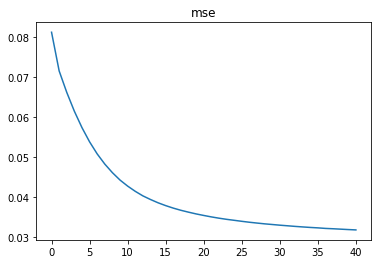

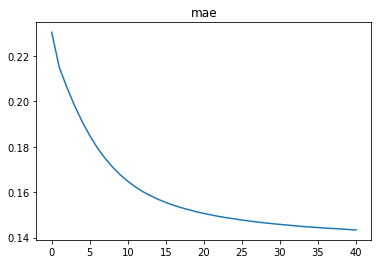

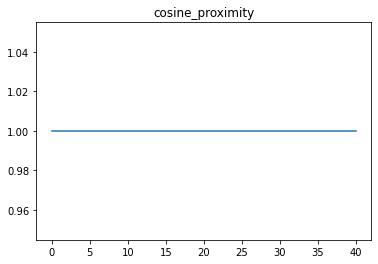

X_test.shape :  (1250, 2048, 1)
y_test.shape :  (1250, 2048, 1)
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1, 1)


After reshaping...
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1)
y_pred :  [[0.4881199 ]
 [0.5082102 ]
 [0.48454288]
 ...
 [0.4722678 ]
 [0.4769551 ]
 [0.46972352]]
y_pred.shape :  (2048, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
y_test_im.shape :  (1024,)
y_pred_im.shape :  (1024,)
y_.shape :  (2048,)
y_pred.shape :  (2048,)


y_ :  [0.56339103 0.44222335 0.68966623 ... 0.15054249 0.51604454 0.45659802]
y_test_im :  [0.56339103+0.44222335j 0.68966623+0.20708409j 0.69468777+0.20834103j ...
 0.58155096+0.1531759j  0.57945768+0.15054249j 0.51604454+0.45659802j]
y_pred :  [0.4881199  0.5082102  0.48454288 ... 0.4722678  0.4769551  0.46972352]
y_pred_im :  [0.4881199 +0.5082102j  0.48454288+0.45833176j 0.4845449 +0.45831025j ...
 0.47844413+0.47228137j 0.47845477+0.

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


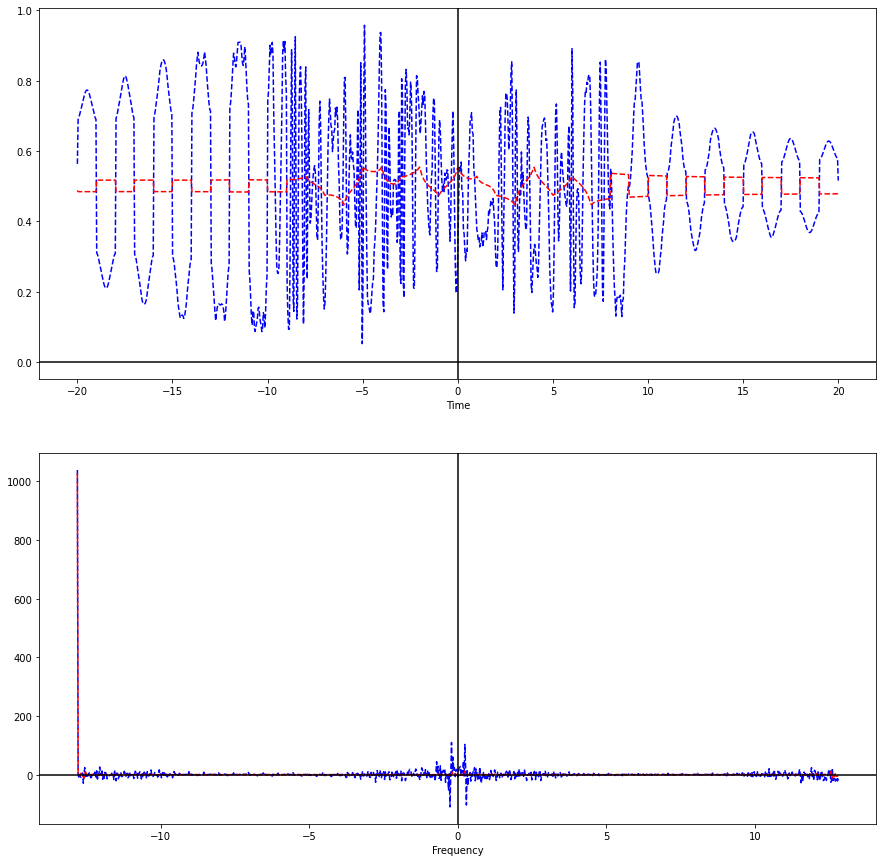

In [ ]:
# testing the model
index_pred = -198
with_error_plots = True
y_pred = test_model(model_dense_full_minmax, X_test, y_test, history, index_pred, with_error_plots)
test_prediction(y_test, y_pred, index_pred, parameters)

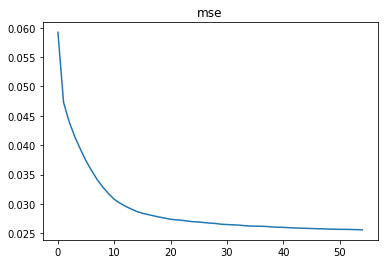

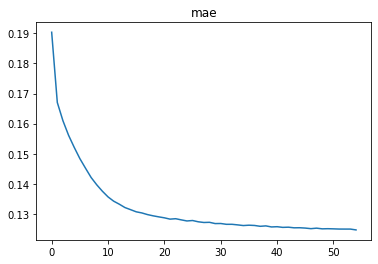

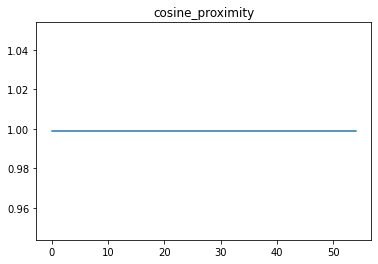

X_test.shape :  (250, 2048, 1)
y_test.shape :  (250, 2048, 1)
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1, 1)


After reshaping...
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1)
y_pred :  [[0.42231235]
 [0.48450506]
 [0.41057009]
 ...
 [0.60103464]
 [0.4263225 ]
 [0.5009929 ]]
y_pred.shape :  (2048, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
y_test_im.shape :  (1024,)
y_pred_im.shape :  (1024,)
y_.shape :  (2048,)
y_pred.shape :  (2048,)


y_ :  [0.26362355 0.33791057 0.14737598 ... 0.45755368 0.33402382 0.24228896]
y_test_im :  [0.26362355+0.33791057j 0.14737598+0.45252484j 0.14775534+0.45094581j ...
 0.15503613+0.45645298j 0.1544065 +0.45755368j 0.33402382+0.24228896j]
y_pred :  [0.42231235 0.48450506 0.41057009 ... 0.60103464 0.4263225  0.5009929 ]
y_pred_im :  [0.42231235+0.48450506j 0.41057009+0.602275j   0.4105702 +0.6022683j  ...
 0.40885442+0.6010263j  0.4088575 +0.60

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


TypeError: ignored

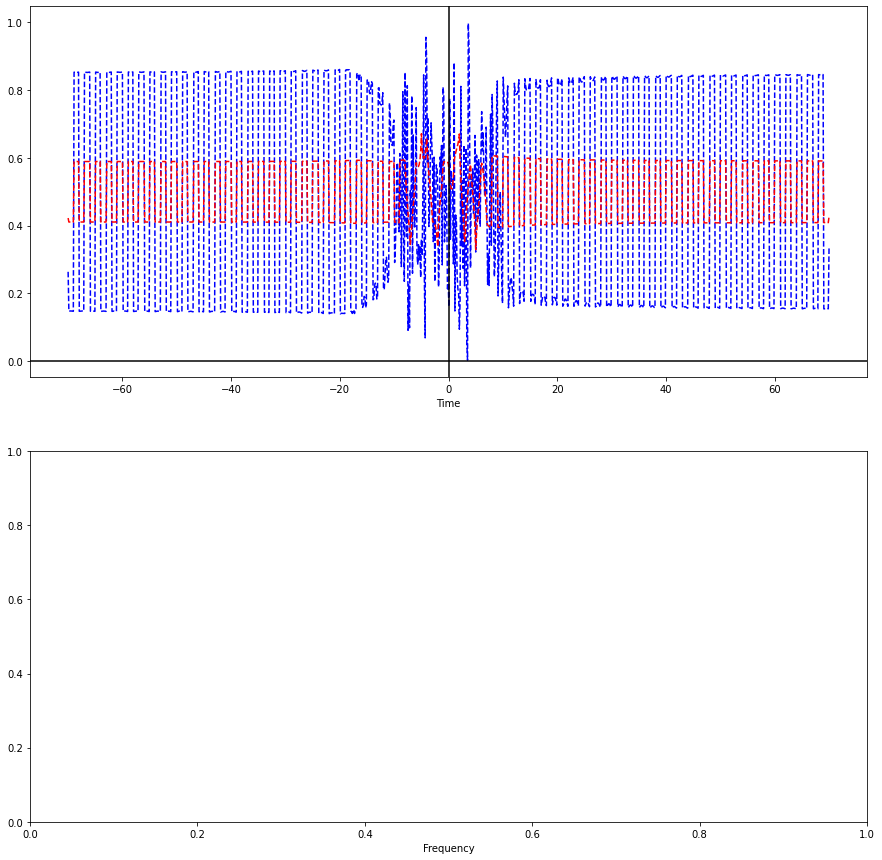

In [ ]:
# testing the model
index_pred = -198
with_error_plots = True
y_pred = test_model(model_dense_full_minmax, X_test, y_test, history, index_pred, with_error_plots)
test_prediction(y_test, y_pred, index_pred, parameters)

In [ ]:
# testing the model
index_pred = -1
with_error_plots = False
y_pred = test_model(model_dense_full, X_test, y_test, history, index_pred, with_error_plots)
test_prediction(y_test, y_pred, index_pred, parameters)

NameError: ignored

In [ ]:
y_pred

array([[0.7628479 ],
       [0.8705845 ],
       [0.917663  ],
       ...,
       [0.88984257],
       [0.80232626],
       [0.88923883]], dtype=float32)

In [ ]:
y_test[index_pred]

array([[0.41868118],
       [0.61831996],
       [0.41212175],
       ...,
       [0.38424995],
       [0.5850962 ],
       [0.38463718]])

In [ ]:
np.sum(y_pred)/(y_pred[1]*len(y_pred))

#### **With Z-Scaler**

In [ ]:
withReshape = True
ts = 0.25
X_train, X_test, y_train, y_test = prepareTrainAndTestData(df_zsc, withReshape, ts)

In [ ]:
epochs = 5
# Fiting the model
model_dense_full_zsc = create_MLP_CNN(only_dense, opti, customActivationFct, activation_fct, lr, N_output_pred, loss_fct, nbrOfStackedDense, nbrOfStackedCNN, nbrNeuronsDense, nbrFiltersCNN, dropoutDense, dropoutCNN)

In [ ]:
model_dense_full_zsc = train(model_dense_full_zsc, X_train, X_test, y_train, y_test, epochs , batch_size)

In [ ]:
# testing the model
index_pred = -1
with_error_plots = False
y_pred = test_model(model_dense_full_2, X_test, y_test, history, index_pred, with_error_plots)
test_prediction(y_test, y_pred, index_pred, parameters)

In [ ]:
model_dense_full.weights

In [ ]:
y_pred

array([[2.3718481e-01],
       [2.4085340e-01],
       [5.1770557e-04],
       ...,
       [2.6522839e-09],
       [3.9441189e-01],
       [4.0914434e-01]], dtype=float32)

In [ ]:
y_test[index_pred]

array([[ 0.50140138],
       [-1.46331905],
       [ 0.59767279],
       ...,
       [ 1.44522801],
       [-0.55755538],
       [ 1.44275879]])

In [ ]:
np.sum(y_pred)/(y_pred[1]*len(y_pred))

array([0.16965835], dtype=float32)

### **Dense & CNN**

In [ ]:
with_error_plots = True 

only_dense = False
customActivationFct = False
lr = None

nbrOfStackedDense = 4
nbrOfStackedCNN = 5
nbrNeuronsDense = 8
nbrFiltersCNN = 8

dropoutDense, dropoutCNN = 0.15, 0.15

loss_fct = 'mse'
activation_fct = 'sigmoid'
opti = 'sgd'

#### **With min-max scaler**

In [ ]:
withReshape = True
ts = 0.25
X_train, X_test, y_train, y_test = prepareTrainAndTestData(df_minmax, withReshape, ts)

[INFO] - {prepareTrainAndTestData} converting from pandas to numpy...
(30000, 2048)
(30000, 2048)
(22500, 2048, 1)
(22500, 2048, 1)
(7500, 2048, 1)
(7500, 2048, 1)


In [ ]:
model_dense_cnn_minmax_full = create_MLP_CNN(only_dense, opti, customActivationFct, activation_fct, lr, N_output_pred, loss_fct, nbrOfStackedDense, nbrOfStackedCNN, nbrNeuronsDense, nbrFiltersCNN, dropoutDense, dropoutCNN)

{'name': 'SGD', 'learning_rate': 0.01, 'decay': 0.0, 'momentum': 0.0, 'nesterov': False}
Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_26 (Dense)             (None, 2048, 2048)        4096      
_________________________________________________________________
dropout_29 (Dropout)         (None, 2048, 2048)        0         
_________________________________________________________________
batch_normalization_23 (Batc (None, 2048, 2048)        8192      
_________________________________________________________________
dense_27 (Dense)             (None, 2048, 8)           16392     
_________________________________________________________________
dropout_30 (Dropout)         (None, 2048, 8)           0         
_________________________________________________________________
batch_normalization_24 (Batc (None, 2048, 8)           32        
_______________________________

In [ ]:
epochs = 6
# Fiting the model
model_dense_cnn_minmax_full = train(model_dense_cnn_minmax, X_train, X_test, y_train, y_test, epochs , batch_size, earlystopping_patience)

Epoch 1/6
704/704 [==============================] - 53s 75ms/step - loss: 0.0268 - mse: 0.0268 - mae: 0.1302 - cosine_proximity: 1.0000 - cosine_similarity: 1.0000 - val_loss: 0.0259 - val_mse: 0.0259 - val_mae: 0.1289 - val_cosine_proximity: 1.0000 - val_cosine_similarity: 1.0000
Epoch 2/6
704/704 [==============================] - 53s 75ms/step - loss: 0.0267 - mse: 0.0267 - mae: 0.1301 - cosine_proximity: 1.0000 - cosine_similarity: 1.0000 - val_loss: 0.0259 - val_mse: 0.0259 - val_mae: 0.1289 - val_cosine_proximity: 1.0000 - val_cosine_similarity: 1.0000
Epoch 3/6
704/704 [==============================] - 53s 75ms/step - loss: 0.0267 - mse: 0.0267 - mae: 0.1300 - cosine_proximity: 1.0000 - cosine_similarity: 1.0000 - val_loss: 0.0259 - val_mse: 0.0259 - val_mae: 0.1289 - val_cosine_proximity: 1.0000 - val_cosine_similarity: 1.0000
Epoch 4/6
704/704 [==============================] - 53s 75ms/step - loss: 0.0266 - mse: 0.0266 - mae: 0.1299 - cosine_proximity: 1.0000 - cosine_simil

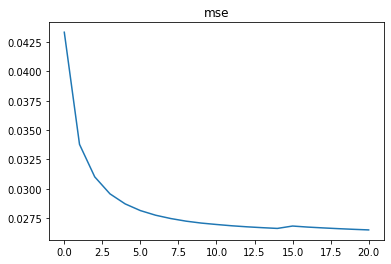

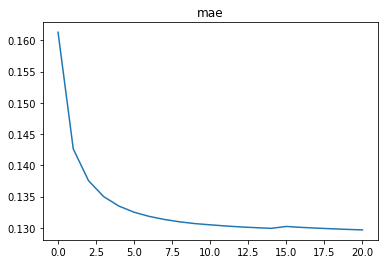

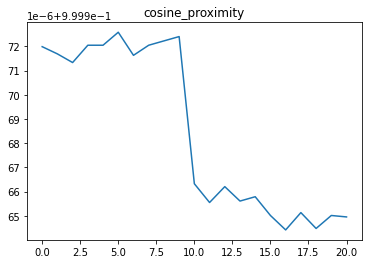

X_test.shape :  (7500, 2048, 1)
y_test.shape :  (7500, 2048, 1)
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1, 1)


After reshaping...
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1)
y_pred :  [[0.50675505]
 [0.4988066 ]
 [0.5061379 ]
 ...
 [0.5124052 ]
 [0.48188096]
 [0.5134056 ]]
y_pred.shape :  (2048, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
y_test_im.shape :  (1024,)
y_pred_im.shape :  (1024,)
y_.shape :  (2048,)
y_pred.shape :  (2048,)


y_ :  [0.47747362 0.44651134 0.41344617 ... 0.56547929 0.71028673 0.72008176]
y_test_im :  [0.47747362+0.44651134j 0.41344617+0.60915826j 0.41439681+0.6100449j  ...
 0.35069421+0.56895188j 0.34852156+0.56547929j 0.71028673+0.72008176j]
y_pred :  [0.50675505 0.4988066  0.5061379  ... 0.5124052  0.48188096 0.5134056 ]
y_pred_im :  [0.50675505+0.4988066j  0.5061379 +0.50954473j 0.50615   +0.50954247j ...
 0.49745834+0.5124089j  0.49746305+0.

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


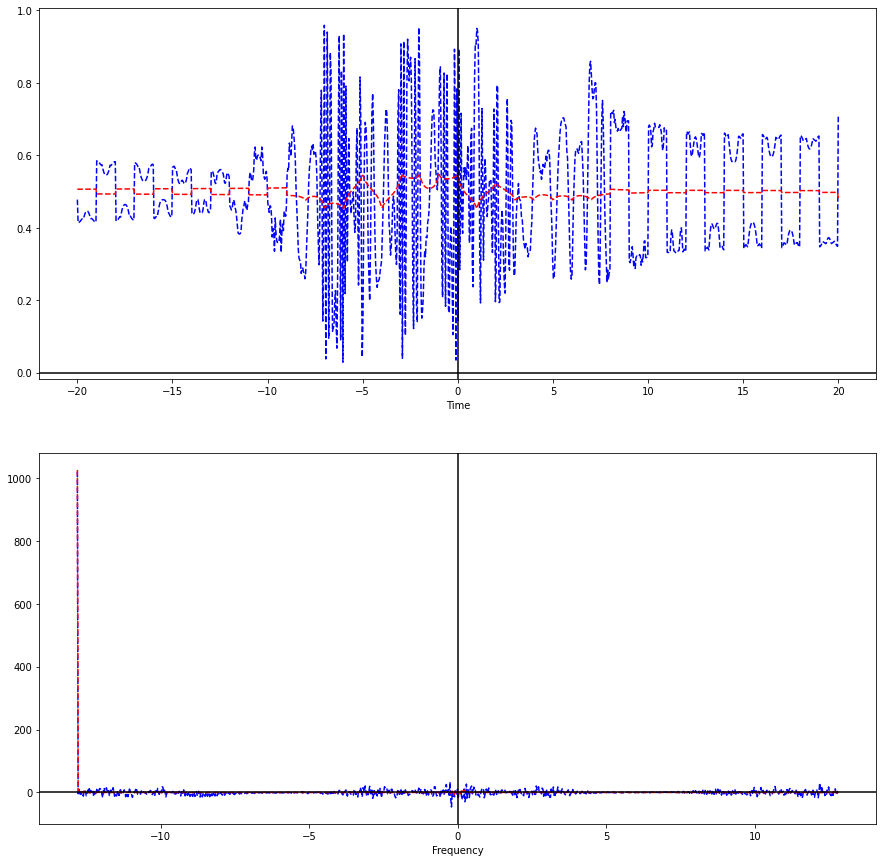

In [ ]:
# testing the model
index_pred = 0
with_error_plots = True
y_pred = test_model(model_dense_cnn_minmax_full, X_test, y_test, history, index_pred, with_error_plots)
test_prediction(y_test, y_pred, index_pred, parameters)

In [ ]:
epochs = 10
# Fiting the model
model_dense_cnn_minmax = train(model_dense_cnn_minmax, X_train, X_test, y_train, y_test, epochs , batch_size, earlystopping_patience)

Epoch 1/10
704/704 [==============================] - 82s 76ms/step - loss: 0.0510 - mse: 0.0510 - mae: 0.1761 - cosine_proximity: 1.0000 - cosine_similarity: 1.0000 - val_loss: 0.0260 - val_mse: 0.0260 - val_mae: 0.1284 - val_cosine_proximity: 1.0000 - val_cosine_similarity: 1.0000
Epoch 2/10
704/704 [==============================] - 53s 75ms/step - loss: 0.0348 - mse: 0.0348 - mae: 0.1446 - cosine_proximity: 1.0000 - cosine_similarity: 1.0000 - val_loss: 0.0260 - val_mse: 0.0260 - val_mae: 0.1286 - val_cosine_proximity: 1.0000 - val_cosine_similarity: 1.0000
Epoch 3/10
704/704 [==============================] - 53s 75ms/step - loss: 0.0315 - mse: 0.0315 - mae: 0.1385 - cosine_proximity: 1.0000 - cosine_similarity: 1.0000 - val_loss: 0.0259 - val_mse: 0.0259 - val_mae: 0.1287 - val_cosine_proximity: 1.0000 - val_cosine_similarity: 1.0000
Epoch 4/10
704/704 [==============================] - 53s 75ms/step - loss: 0.0299 - mse: 0.0299 - mae: 0.1354 - cosine_proximity: 1.0000 - cosine_s

X_test.shape :  (7500, 2048, 1)
y_test.shape :  (7500, 2048, 1)
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1, 1)


After reshaping...
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1)
y_pred :  [[0.5188265 ]
 [0.49215645]
 [0.51163423]
 ...
 [0.489415  ]
 [0.5052099 ]
 [0.48989424]]
y_pred.shape :  (2048, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
y_test_im.shape :  (1024,)
y_pred_im.shape :  (1024,)
y_.shape :  (2048,)
y_pred.shape :  (2048,)


y_ :  [0.64925821 0.59168026 0.65808699 ... 0.57221824 0.35860541 0.39621412]
y_test_im :  [0.64925821+0.59168026j 0.65808699+0.51687446j 0.66051467+0.51818661j ...
 0.6477809 +0.57628985j 0.64487546+0.57221824j 0.35860541+0.39621412j]
y_pred :  [0.5188265  0.49215645 0.51163423 ... 0.489415   0.5052099  0.48989424]
y_pred_im :  [0.5188265 +0.49215645j 0.51163423+0.48485914j 0.5116313 +0.48485616j ...
 0.51398337+0.48942024j 0.51398027+0.

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


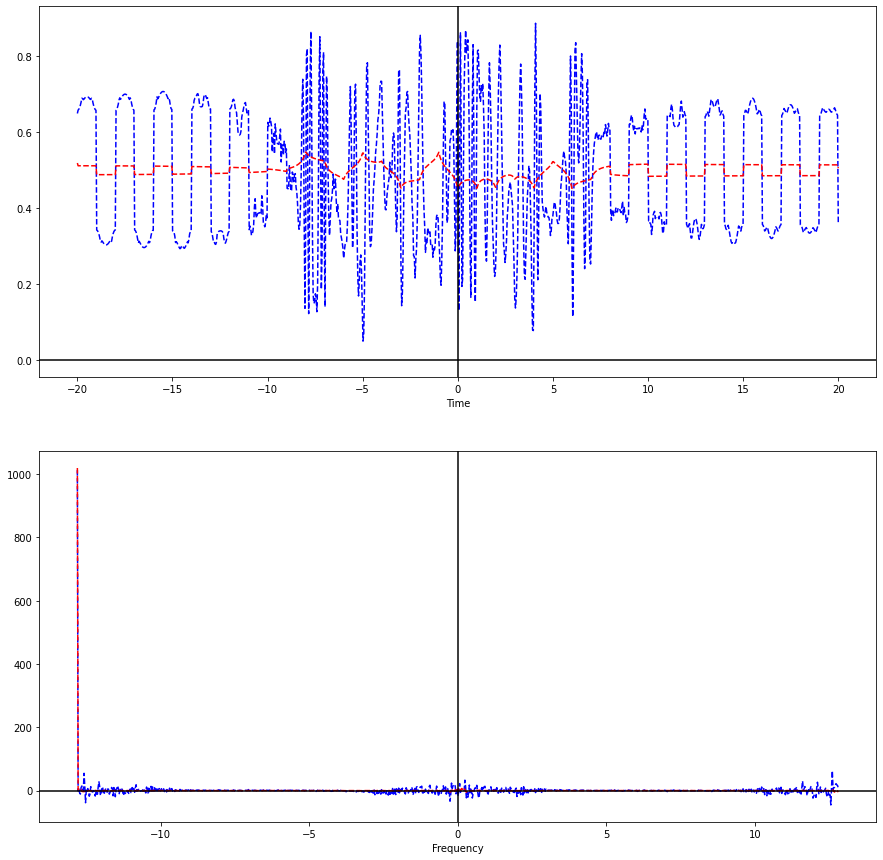

In [ ]:
# testing the model
index_pred = 654
with_error_plots = False
y_pred = test_model(model_dense_cnn_minmax, X_test, y_test, history, index_pred, with_error_plots)
test_prediction(y_test, y_pred, index_pred, parameters)

In [ ]:
with_error_plots = True 

only_dense = False
customActivationFct = False
lr = None
batch_size = 64

nbrOfStackedDense = 2
nbrOfStackedCNN = 7
nbrNeuronsDense = 16
nbrFiltersCNN = 256

dropoutDense, dropoutCNN = 0, 0

loss_fct = tf.keras.losses.Huber()  #'mse'
activation_fct = 'sigmoid'
opti = tf.keras.optimizers.SGD(nesterov=True)#'sgd'

# Model
model_dense_cnn_minmax_3 = create_MLP_CNN(only_dense, opti, customActivationFct, activation_fct, lr, N_output_pred, loss_fct, nbrOfStackedDense, nbrOfStackedCNN, nbrNeuronsDense, nbrFiltersCNN, dropoutDense, dropoutCNN)

epochs = 30
# Fiting the model
model_dense_cnn_minmax_3 = train(model_dense_cnn_minmax_3, X_train, X_test, y_train, y_test, epochs , batch_size)

{'name': 'SGD', 'learning_rate': 0.01, 'decay': 0.0, 'momentum': 0.0, 'nesterov': True}
Model: "sequential_36"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_218 (Dense)            (None, 2048, 64)          128       
_________________________________________________________________
dropout_304 (Dropout)        (None, 2048, 64)          0         
_________________________________________________________________
batch_normalization_272 (Bat (None, 2048, 64)          256       
_________________________________________________________________
conv1d_120 (Conv1D)          (None, 2048, 256)         16640     
_________________________________________________________________
dropout_305 (Dropout)        (None, 2048, 256)         0         
_________________________________________________________________
batch_normalization_273 (Bat (None, 2048, 256)         1024      
_______________________________

X_test.shape :  (15000, 2048, 1)
y_test.shape :  (15000, 2048, 1)
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1, 1)


After reshaping...
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1)
y_pred :  [[0.50108457]
 [0.5010147 ]
 [0.49783587]
 ...
 [0.501709  ]
 [0.50420445]
 [0.49523914]]
y_pred.shape :  (2048, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
y_test_im.shape :  (1024,)
y_pred_im.shape :  (1024,)
y_.shape :  (2048,)
y_pred.shape :  (2048,)


y_ :  [0.55497873 0.5756432  0.55330331 ... 0.42212142 0.44598624 0.42188209]
y_test_im :  [0.55497873+0.5756432j  0.55330331+0.57758082j 0.44373122+0.42778815j ...
 0.55518586+0.57509487j 0.44587445+0.42212142j 0.44598624+0.42188209j]
y_pred :  [0.50108457 0.5010147  0.49783587 ... 0.501709   0.50420445 0.49523914]
y_pred_im :  [0.50108457+0.5010147j  0.49783587+0.501709j   0.501568  +0.49769562j ...
 0.50157154+0.4976949j  0.49783564+

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


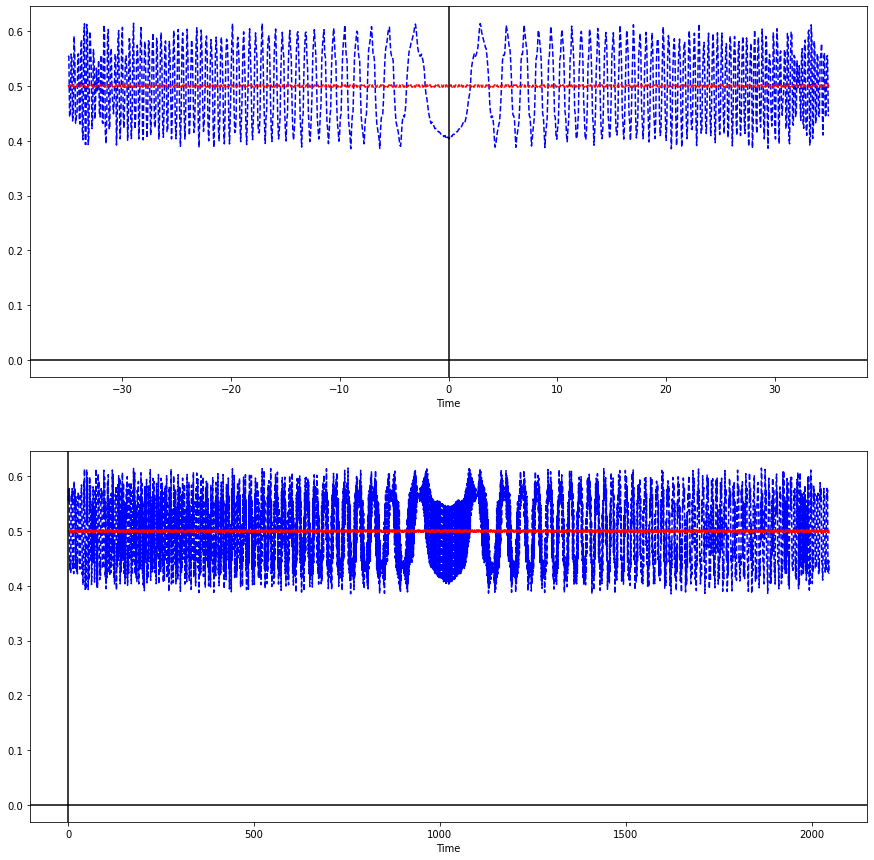

In [ ]:
# testing the model
index_pred = -1
with_error_plots = False
y_pred = test_model(model_dense_cnn_minmax_3, X_test, y_test, history, index_pred, with_error_plots)
test_prediction(y_test, y_pred, index_pred, parameters)

X_test.shape :  (15000, 2048, 1)
y_test.shape :  (15000, 2048, 1)
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1, 1)


After reshaping...
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1)
y_pred :  [[0.49116817]
 [0.4915247 ]
 [0.5082547 ]
 ...
 [0.48789176]
 [0.47480103]
 [0.52188885]]
y_pred.shape :  (2048, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
y_test_im.shape :  (1024,)
y_pred_im.shape :  (1024,)
y_.shape :  (2048,)
y_pred.shape :  (2048,)


y_ :  [0.55497873 0.5756432  0.55330331 ... 0.42212142 0.44598624 0.42188209]
y_test_im :  [0.55497873+0.5756432j  0.55330331+0.57758082j 0.44373122+0.42778815j ...
 0.55518586+0.57509487j 0.44587445+0.42212142j 0.44598624+0.42188209j]
y_pred :  [0.49116817 0.4915247  0.5082547  ... 0.48789176 0.47480103 0.52188885]
y_pred_im :  [0.49116817+0.4915247j  0.5082547 +0.48789176j 0.4886312 +0.5089941j  ...
 0.4886314 +0.508995j   0.5082547 +

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


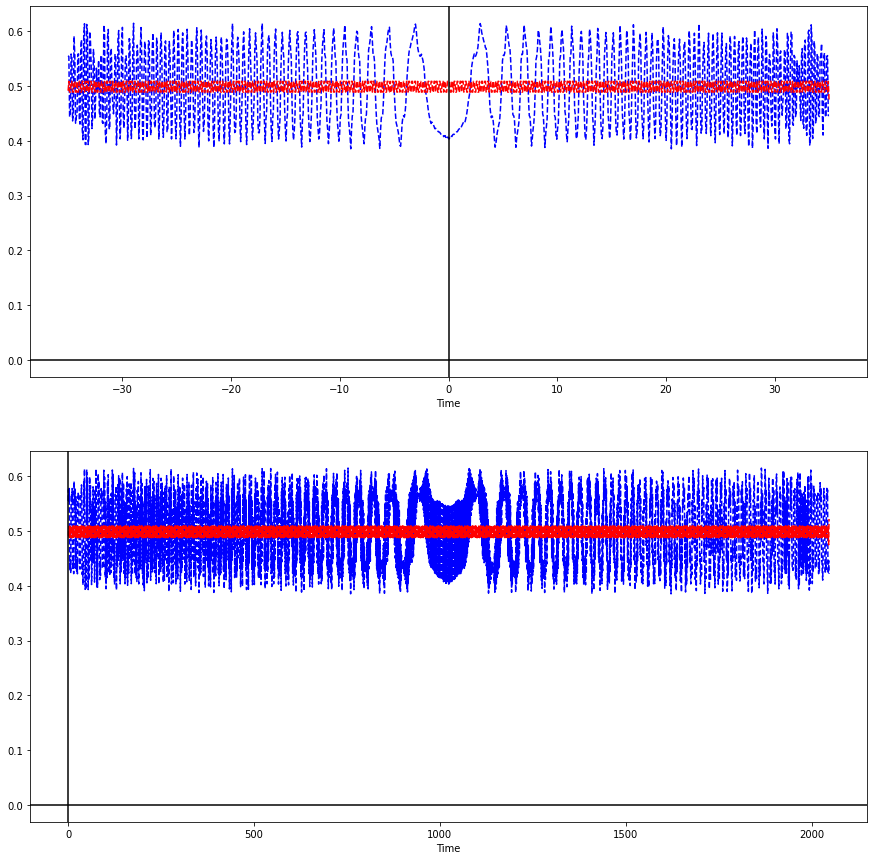

In [ ]:
# testing the model
index_pred = -1
with_error_plots = False
y_pred = test_model(model_dense_cnn_minmax_2, X_test, y_test, history, index_pred, with_error_plots)
test_prediction(y_test, y_pred, index_pred, parameters)

X_test.shape :  (15000, 2048, 1)
y_test.shape :  (15000, 2048, 1)
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1, 1)


After reshaping...
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1)
y_pred :  [[0.5068476 ]
 [0.50057364]
 [0.23594178]
 ...
 [0.5641568 ]
 [0.76504654]
 [0.10570443]]
y_pred.shape :  (2048, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
y_test_im.shape :  (1024,)
y_pred_im.shape :  (1024,)
y_.shape :  (2048,)
y_pred.shape :  (2048,)


y_ :  [0.55497873 0.5756432  0.55330331 ... 0.42212142 0.44598624 0.42188209]
y_test_im :  [0.55497873+0.5756432j  0.55330331+0.57758082j 0.44373122+0.42778815j ...
 0.55518586+0.57509487j 0.44587445+0.42212142j 0.44598624+0.42188209j]
y_pred :  [0.5068476  0.50057364 0.23594178 ... 0.5641568  0.76504654 0.10570443]
y_pred_im :  [0.5068476 +0.50057364j 0.23594178+0.5641568j  0.55131423+0.22668894j ...
 0.5513112 +0.22667743j 0.23594168+

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


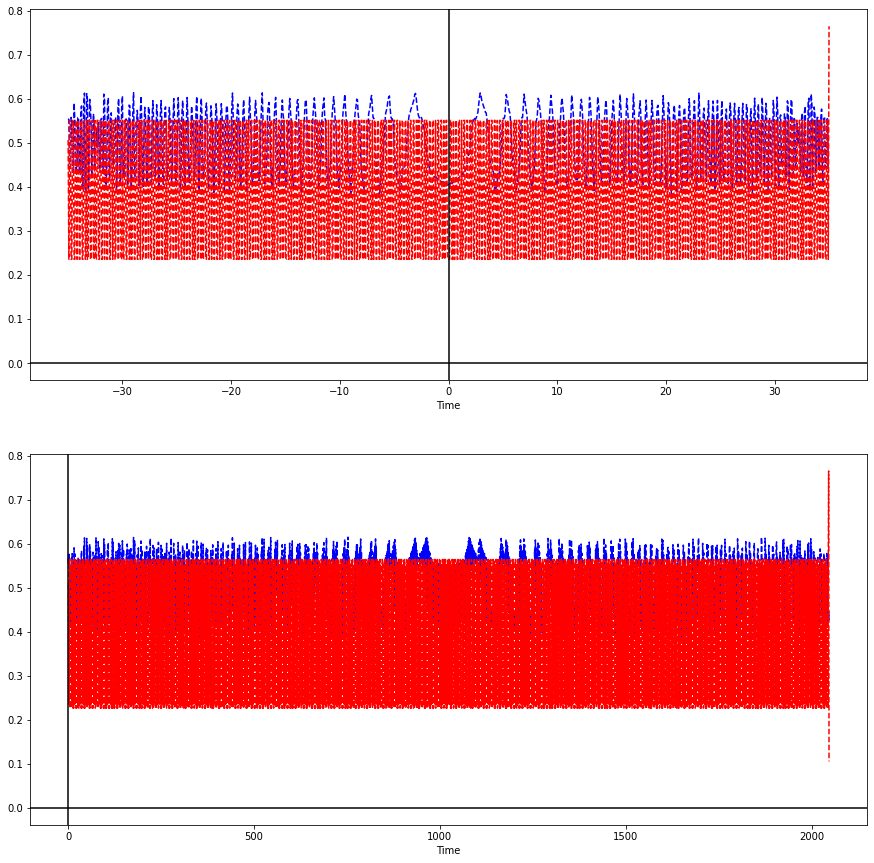

In [ ]:
# testing the model
index_pred = -1
with_error_plots = False
y_pred = test_model(model_dense_cnn_minmax, X_test, y_test, history, index_pred, with_error_plots)
test_prediction(y_test, y_pred, index_pred, parameters)

### CNN-20epo

In [ ]:
epochs = 20
# Fiting the model
model_dense_cnn = train(model_dense_cnn, X_train, X_test, y_train, y_test, epochs , batch_size)

Epoch 1/20
352/352 [==============================] - 90s 256ms/step - loss: 1.0077 - mse: 1.0077 - mae: 0.8013 - cosine_proximity: 1.0366e-04 - msle: 0.1532 - val_loss: 1.1131 - val_mse: 1.1131 - val_mae: 0.8209 - val_cosine_proximity: -2.5490e-04 - val_msle: 0.1577
Epoch 2/20
352/352 [==============================] - 89s 254ms/step - loss: 1.0027 - mse: 1.0027 - mae: 0.7994 - cosine_proximity: 1.0366e-04 - msle: 0.1636 - val_loss: 1.0073 - val_mse: 1.0073 - val_mae: 0.7997 - val_cosine_proximity: -2.5490e-04 - val_msle: 0.1670
Epoch 3/20
352/352 [==============================] - 89s 254ms/step - loss: 1.0011 - mse: 1.0011 - mae: 0.7987 - cosine_proximity: 1.0366e-04 - msle: 0.1690 - val_loss: 1.0063 - val_mse: 1.0063 - val_mae: 0.7994 - val_cosine_proximity: -2.5490e-04 - val_msle: 0.1715
Epoch 4/20
352/352 [==============================] - 89s 254ms/step - loss: 1.0003 - mse: 1.0003 - mae: 0.7984 - cosine_proximity: 1.0366e-04 - msle: 0.1724 - val_loss: 1.0057 - val_mse: 1.0057 -

X_test.shape :  (15000, 2048, 1)
y_test.shape :  (15000, 2048, 1)
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1, 1)


After reshaping...
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1)
y_pred :  [[0.0095441 ]
 [0.00831803]
 [0.01936297]
 ...
 [0.03261735]
 [0.01025091]
 [0.0078587 ]]
y_pred.shape :  (2048, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
y_test_im.shape :  (1024,)
y_pred_im.shape :  (1024,)
y_.shape :  (2048,)
y_pred.shape :  (2048,)


y_ :  [ 2.01475351  0.05466522  2.00644788 ... -0.12412681 -2.01102334
 -0.13310471]
y_test_im :  [ 2.01475351+0.05466522j  2.00644788+0.1897594j  -2.01498805+0.0524797j
 ...  2.01516887+0.03758189j -2.01160197-0.12412681j
 -2.01102334-0.13310471j]
y_pred :  [0.0095441  0.00831803 0.01936297 ... 0.03261735 0.01025091 0.0078587 ]
y_pred_im :  [0.0095441 +0.00831803j 0.01936297+0.0326551j  0.01269986+0.00747514j ...
 0.01269348+0.00746611

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


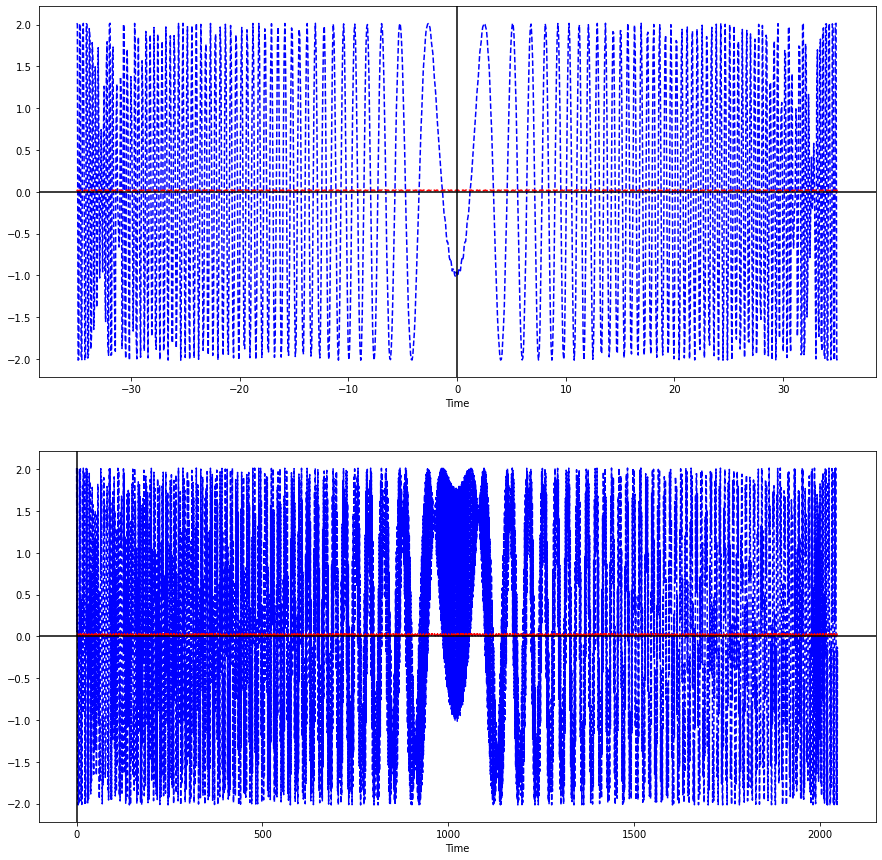

In [ ]:
# testing the model
index_pred = 9595
with_error_plots = False
y_pred = test_model(model_dense_cnn, X_test, y_test, history, index_pred, with_error_plots)
test_prediction(y_test, y_pred, index_pred, parameters)

### CNN-1epo

In [ ]:
epochs = 1
# Fiting the model
model_dense_cnn = train(model_dense_cnn, X_train, X_test, y_train, y_test, epochs , batch_size)

X_test.shape :  (15000, 2048, 1)
y_test.shape :  (15000, 2048, 1)
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1, 1)


After reshaping...
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1)
y_pred :  [[1.5839407e-05]
 [9.9997163e-01]
 [9.9934024e-01]
 ...
 [1.7020812e-07]
 [5.2293479e-02]
 [9.9997234e-01]]
y_pred.shape :  (2048, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
y_test_im.shape :  (1024,)
y_pred_im.shape :  (1024,)
y_.shape :  (2048,)
y_pred.shape :  (2048,)


y_ :  [-1.54450358 -1.94308932 -1.4115483  ...  1.99530333  1.46816275
  2.00188733]
y_test_im :  [-1.54450358-1.94308932j -1.4115483 -2.04255341j  1.64494801+1.85811788j
 ... -1.56080531-1.92990241j  1.47702648+1.99530333j
  1.46816275+2.00188733j]
y_pred :  [1.5839407e-05 9.9997163e-01 9.9934024e-01 ... 1.7020812e-07 5.2293479e-02
 9.9997234e-01]
y_pred_im :  [1.5839407e-05+9.9997163e-01j 9.9934024e-01+1.7020812e-07j

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


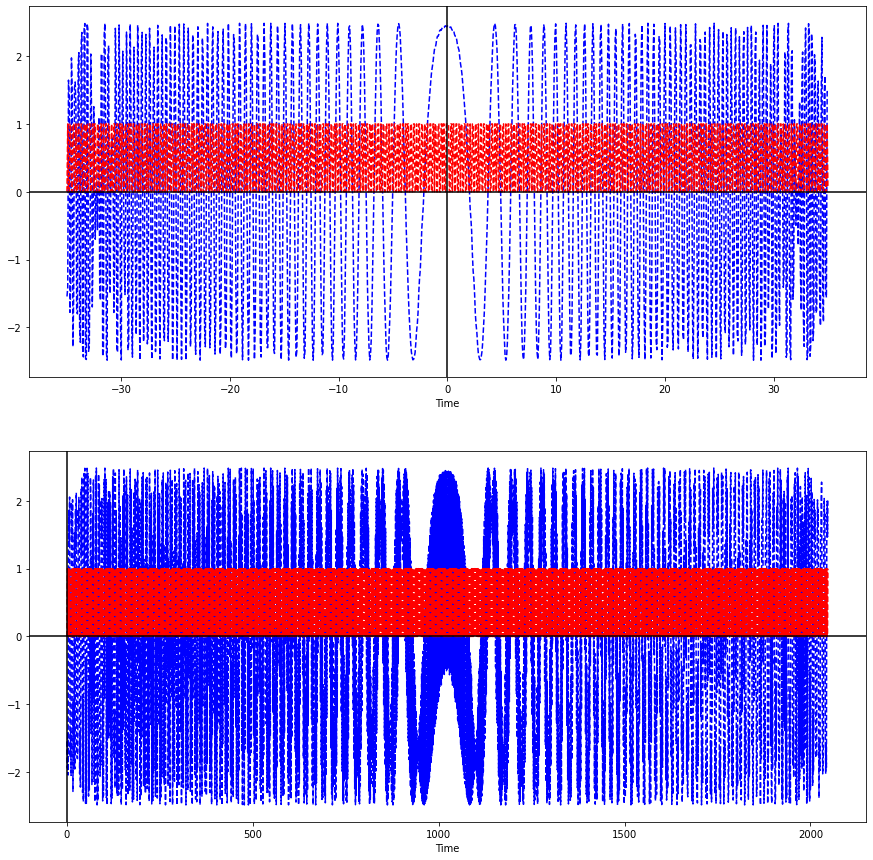

In [ ]:
# testing the model
index_pred = -1
with_error_plots = False
y_pred = test_model(model_dense_cnn, X_test, y_test, history, index_pred, with_error_plots)
test_prediction(y_test, y_pred, index_pred, parameters)

In [ ]:
y_pred

array([[1.5839407e-05],
       [9.9997163e-01],
       [9.9934024e-01],
       ...,
       [1.7020812e-07],
       [5.2293479e-02],
       [9.9997234e-01]], dtype=float32)

### CNN-200epo

In [ ]:
with_error_plots = True 

only_dense = False
customActivationFct = False
lr = None

nbrOfStackedDense = 7
nbrOfStackedCNN = 110
nbrNeuronsDense = 32
nbrFiltersCNN = 32

dropoutDense, dropoutCNN = 0, 0

loss_fct = 'mse'
activation_fct = 'relu'
opti = 'rmsprop'

model_dense_cnn_200ep = create_MLP_CNN(only_dense, opti, customActivationFct, activation_fct, lr, N_output_pred, loss_fct, nbrOfStackedDense, nbrOfStackedCNN, nbrNeuronsDense, nbrFiltersCNN, dropoutDense, dropoutCNN)

{'name': 'RMSprop', 'learning_rate': 0.001, 'decay': 0.0, 'rho': 0.9, 'momentum': 0.0, 'epsilon': 1e-07, 'centered': False}
Model: "sequential_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_240 (Dense)            (None, 2048, 64)          128       
_________________________________________________________________
dropout_296 (Dropout)        (None, 2048, 64)          0         
_________________________________________________________________
batch_normalization_159 (Bat (None, 2048, 64)          256       
_________________________________________________________________
dense_241 (Dense)            (None, 2048, 32)          2080      
_________________________________________________________________
dropout_297 (Dropout)        (None, 2048, 32)          0         
_________________________________________________________________
batch_normalization_160 (Bat (None, 2048, 32)          128   

In [ ]:
epochs = 5
# Fiting the model
model_dense_cnn_200ep = train(model_dense_cnn_200ep, X_train, X_test, y_train, y_test, epochs , batch_size)

Epoch 1/5
352/352 [==============================] - 134s 325ms/step - loss: 1.0699 - mse: 1.0699 - mae: 0.8256 - cosine_proximity: 9.9505e-05 - msle: 0.1482 - val_loss: 1.0188 - val_mse: 1.0188 - val_mae: 0.8008 - val_cosine_proximity: -2.7461e-04 - val_msle: 0.1793
Epoch 2/5
352/352 [==============================] - 111s 314ms/step - loss: 0.9883 - mse: 0.9883 - mae: 0.7931 - cosine_proximity: 1.7299e-04 - msle: 0.1913 - val_loss: 1.0045 - val_mse: 1.0045 - val_mae: 0.7986 - val_cosine_proximity: -2.5544e-04 - val_msle: 0.1914
Epoch 3/5
352/352 [==============================] - 110s 314ms/step - loss: 0.9992 - mse: 0.9992 - mae: 0.7985 - cosine_proximity: 1.9615e-04 - msle: 0.1934 - val_loss: 1.5296 - val_mse: 1.5296 - val_mae: 1.0018 - val_cosine_proximity: 0.0026 - val_msle: 0.2502
Epoch 4/5
352/352 [==============================] - 110s 314ms/step - loss: 1.0029 - mse: 1.0029 - mae: 0.7991 - cosine_proximity: -2.2609e-05 - msle: 0.1937 - val_loss: 1.0820 - val_mse: 1.0820 - val

X_test.shape :  (45000, 2048, 1)
y_test.shape :  (45000, 2048, 1)
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1, 1)


After reshaping...
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1)
y_pred :  [[3.6933102e-06]
 [2.7286986e-04]
 [1.5757173e-04]
 ...
 [1.4857753e-05]
 [1.6476084e-05]
 [4.0160699e-04]]
y_pred.shape :  (2048, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
y_test_im.shape :  (1024,)
y_pred_im.shape :  (1024,)
y_.shape :  (2048,)
y_pred.shape :  (2048,)


y_ :  [ 0.52850823  1.62367662  0.41918396 ... -1.64102169 -0.46534038
 -1.64312215]
y_test_im :  [ 0.52850823+1.62367662j  0.41918396+1.65564347j -0.61344083-1.59317139j
 ...  0.54216097+1.6191157j  -0.47260939-1.64102169j
 -0.46534038-1.64312215j]
y_pred :  [3.6933102e-06 2.7286986e-04 1.5757173e-04 ... 1.4857753e-05 1.6476084e-05
 4.0160699e-04]
y_pred_im :  [3.69331019e-06+2.72869860e-04j 1.57571732e-04+1.48579511e

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


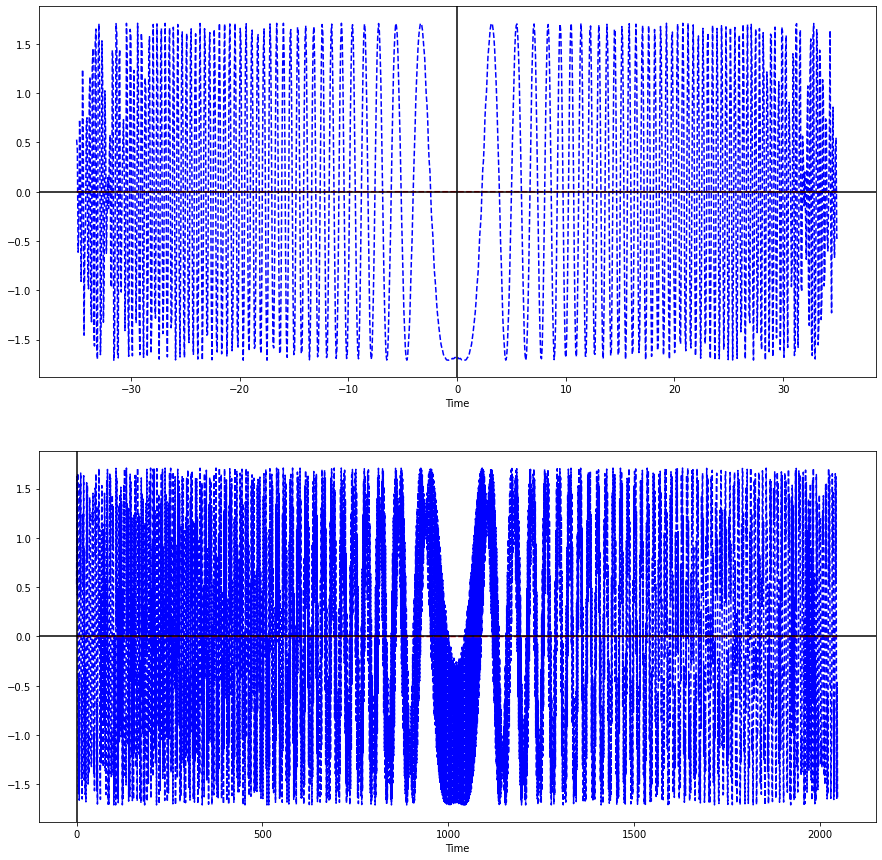

In [ ]:
# testing the model
index_pred = 1089
with_error_plots = False
y_pred = test_model(model_dense_cnn_200ep, X_train, y_train, history, index_pred, with_error_plots)
test_prediction(y_train, y_pred, index_pred, parameters)

In [ ]:
y_pred

array([[1.5811718e-04],
       [3.5150439e-05],
       [2.0351032e-05],
       ...,
       [2.7850461e-05],
       [8.0708858e-05],
       [2.9275920e-05]], dtype=float32)

In [ ]:
np.var(X_test[index_pred])

1.0771286940255362

In [ ]:
np.var(y_test[index_pred])

1.0762441477155273

X_test.shape :  (15000, 2048, 1)
y_test.shape :  (15000, 2048, 1)
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1, 1)


After reshaping...
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1)
y_pred :  [[1.2477558]
 [1.2477576]
 [1.2477578]
 ...
 [1.2475696]
 [1.2477576]
 [1.2477555]]
y_pred.shape :  (2048, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
y_test_im.shape :  (1024,)
y_pred_im.shape :  (1024,)
y_.shape :  (2048,)
y_pred.shape :  (2048,)


y_ :  [0.39011991 0.4190017  0.39615594 ... 0.58495349 0.60640421 0.58550204]
y_test_im :  [0.39011991+0.4190017j  0.39615594+0.40956044j 0.61452836+0.57492691j ...
 0.38937218+0.41997238j 0.60680595+0.58495349j 0.60640421+0.58550204j]
y_pred :  [1.2477558 1.2477576 1.2477578 ... 1.2475696 1.2477576 1.2477555]
y_pred_im :  [1.2477558+1.2477576j 1.2477578+1.2475696j 1.2477568+1.2477576j ...
 1.2477572+1.2477576j 1.2477578+1.2475696j 1.2477576+

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


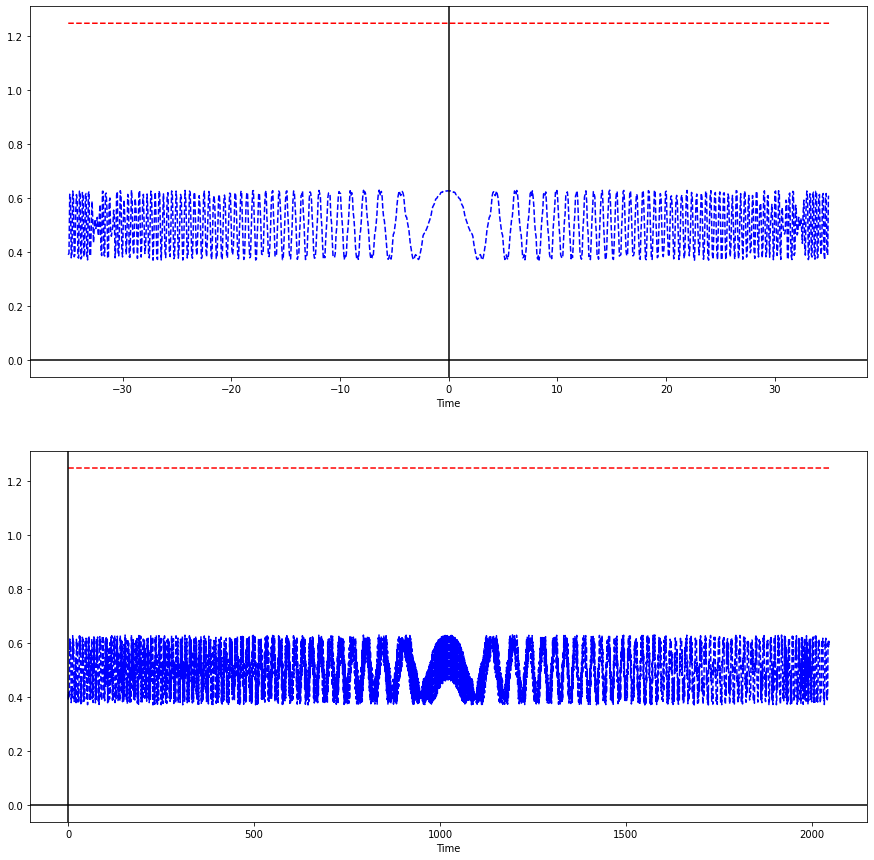

In [ ]:
# testing the model
index_pred = 100
with_error_plots = False
y_pred = test_model(model_dense_cnn, X_test, y_test, history, index_pred, with_error_plots)
test_prediction(y_test, y_pred, index_pred, parameters)

{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
y_pred_im.shape :  (1024,)
y_pred.shape :  (2048,)




/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


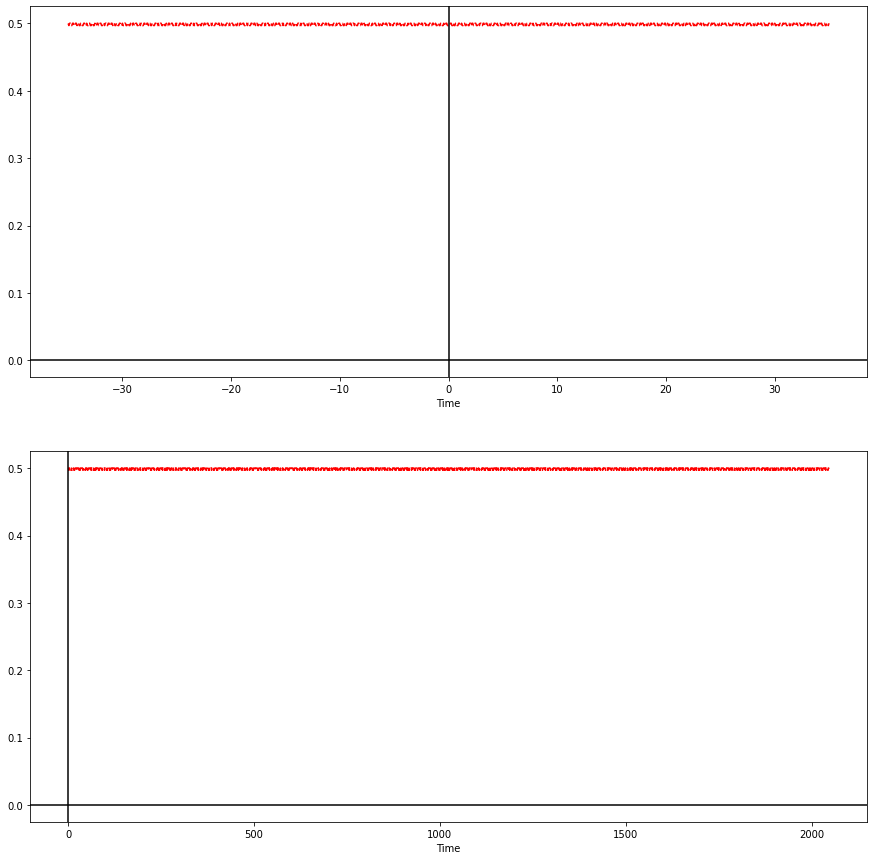

In [ ]:
test_ypred(y_pred, parameters)

In [ ]:
np.sum(y_pred)/(y_pred[0]*len(y_pred))

array([0.9996035], dtype=float32)

In [ ]:
yx = y_pred - y_test
yx

array([[[-0.10590568],
        [ 0.06199363],
        [-0.1139306 ],
        ...,
        [-0.05728353],
        [ 0.10932373],
        [-0.0568421 ]],

       [[ 0.19837884],
        [ 0.00241415],
        [ 0.19892415],
        ...,
        [-0.00849684],
        [-0.19989642],
        [-0.00946032]],

       [[ 0.17814424],
        [-0.14283557],
        [ 0.18787643],
        ...,
        [ 0.13774165],
        [-0.18495184],
        [ 0.13689321]],

       ...,

       [[ 0.01126706],
        [ 0.0335951 ],
        [ 0.00689831],
        ...,
        [-0.03303105],
        [-0.00995413],
        [-0.03312947]],

       [[-0.11877371],
        [ 0.18614033],
        [-0.13511465],
        ...,
        [-0.18119486],
        [ 0.12698067],
        [-0.18071238]],

       [[-0.04777307],
        [ 0.06561572],
        [-0.05514298],
        ...,
        [-0.06299483],
        [ 0.05081449],
        [-0.06282418]]])

## **CNN-1D**

In [ ]:
#-----------------------------------------------------------------------------------------------------#

def my_activation(x):
        """ Computes the activation of a neuron.
            @param x : data.

            Should use Keras function for stability of the tensors.
        """
        dz = parameters.z/parameters.nz
        return x*K.exp(dz*K.abs(x)**2)

#-----------------------------------------------------------------------------------------------------#

def create_CNN1D(only_dense, customActivationFct, lr, loss_fct, nbrOfStackedCNN, nbrFiltersCNN, dropoutDense, dropoutCNN):

  if lr != None :
    K.set_value(model_dense.optimizer.learning_rate, lr)

  # custom activation function
  if customActivationFct :
    get_custom_objects().update({'my_activation': Activation(my_activation)})
  
  # Model
  model_cnn1D= Sequential()

  # Convolution layers


  # 1st CNN layer should include input shape
  model_cnn1D.add(Conv1D(filters=nbrFiltersCNN, kernel_size=1 ,strides=1, input_shape=X_train.shape[1:], kernel_initializer= 'uniform')) 
  model_cnn1D.add(LeakyReLU())
  model_cnn1D.add(Dropout(dropoutCNN))

  # go up to 10 layers of CNN
  for i in range(nbrOfStackedCNN):
    
    model_cnn1D.add(Conv1D(filters=nbrFiltersCNN, kernel_size=1 ,strides=1,  kernel_initializer= 'uniform', activation='relu'))
    model_cnn1D.add(Dropout(dropoutCNN))

    

  # Fully connected layers
  for i in range(nbrOfStackedDense) :
    model_cnn1D.add(Dense(nbrNeuronsDense, kernel_initializer='normal', activation='relu'))
    model_cnn1D.add(Dropout(dropoutDense))
  

  # Output layer
  model_cnn1D.add(Dense(1))
  if customActivationFct :
    model_cnn1D.add(Activation(my_activation, name='SpecialActivation'))
  else :
    model_cnn1D.add(Activation('relu'))

  # Compile the model
  model_cnn1D.compile(loss=loss_fct, 
                      optimizer='adam', 
                      metrics=['mean_squared_error', 'mean_absolute_error', 'mean_absolute_percentage_error', 'cosine_proximity', 'msle'])
  
  print(model_cnn1D.optimizer.get_config())
  print(model_cnn1D.summary())
  print("model_dense.output_shape : ",model_cnn1D.output_shape)

  return model_cnn1D

#-----------------------------------------------------------------------------------------------------#

In [ ]:
X_train.shape[1:]

(1500, 1)

## **LSTM**

In [ ]:
inputs=inputShape

In [ ]:
#-----------------------------------------------------------------------------------------------------#

def create_LSTM(only_dense, customActivationFct, lr, loss_fct, nbrOfStackedLSTM, nbrOfStackedDense, nbrNeuronsLSTM, dropoutDense, dropoutLSTM):

  if lr != None :
    K.set_value(model_dense.optimizer.learning_rate, lr)

  # custom activation function
  if customActivationFct :
    get_custom_objects().update({'my_activation': Activation(my_activation)})

  # Model
  model_lstm = Sequential()

  # Input Layer
  #model_lstm.add(Input(shape=inputShape))
  # Input layer - 1st Dense layer should include input shape
  model_lstm.add(Dense(16, kernel_initializer='normal', input_shape=X_train.shape[1:]))
  model_lstm.add(LeakyReLU())
  model_lstm.add(Dropout(dropoutDense))
  model_lstm.add(BatchNormalization())

  # LSTM layers

  # 1st LSTM layer should include input shape
  model_lstm.add(LSTM(nbrNeuronsLSTM, return_sequences=True))
  model_lstm.add(LeakyReLU())
  model_lstm.add(Dropout(dropoutLSTM))
  model_lstm.add(BatchNormalization())

  # go up to 10 layers of LSTM
  for i in range(nbrOfStackedLSTM):    
    model_lstm.add(LSTM(nbrNeuronsLSTM, return_sequences=True))
    model_lstm.add(LeakyReLU())
    model_lstm.add(Dropout(dropoutLSTM))
    model_lstm.add(BatchNormalization())

    

  # Fully connected layers
  for i in range(nbrOfStackedDense) :
    model_lstm.add(Dense(nbrNeuronsDense, kernel_initializer='normal', activation='relu'))
    model_lstm.add(Dropout(dropoutDense))
    model_lstm.add(BatchNormalization())


  # Output layer
  model_lstm.add(Dense(1))
  if customActivationFct :
    model_lstm.add(Activation(my_activation, name='SpecialActivation'))
  else :
    model_lstm.add(Activation('sigmoid'))

  # Compile the model
  model_lstm.compile(loss=loss_fct, 
                      optimizer='adam', 
                      metrics=['mean_squared_error', 'mean_absolute_error', 'mean_absolute_percentage_error', 'cosine_proximity', 'msle'])

  print(model_lstm.optimizer.get_config())
  print(model_lstm.summary())
  print("model_dense.output_shape : ",model_lstm.output_shape)

  return model_lstm

  #-----------------------------------------------------------------------------------------------------#

In [ ]:
with_error_plots = True 

only_dense = False
customActivationFct = False
lr = None

nbrOfStackedDense = 6
nbrOfStackedLSTM = 4
nbrNeuronsDense = 32
nbrNeuronsLSTM = 32

dropoutDense, dropoutLSTM = 0.15, 0.15

loss_fct = 'mse'

model_lstm = create_LSTM(only_dense, customActivationFct, lr, loss_fct, nbrOfStackedLSTM, nbrOfStackedDense, nbrNeuronsLSTM, dropoutDense, dropoutLSTM)

{'name': 'Adam', 'learning_rate': 0.001, 'decay': 0.0, 'beta_1': 0.9, 'beta_2': 0.999, 'epsilon': 1e-07, 'amsgrad': False}
Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_135 (Dense)            (None, 1500, 16)          32        
_________________________________________________________________
leaky_re_lu_98 (LeakyReLU)   (None, 1500, 16)          0         
_________________________________________________________________
dropout_222 (Dropout)        (None, 1500, 16)          0         
_________________________________________________________________
batch_normalization_85 (Batc (None, 1500, 16)          64        
_________________________________________________________________
lstm_105 (LSTM)              (None, 1500, 32)          6272      
_________________________________________________________________
leaky_re_lu_99 (LeakyReLU)   (None, 1500, 32)          0      

In [ ]:
epochs = 5
# Fiting the model
model_lstm = train(model_lstm, X_train, X_test, y_train, y_test, epochs , batch_size)

Epoch 1/5
469/469 [==============================] - 163s 348ms/step - loss: 0.2147 - mean_squared_error: 0.2147 - mean_absolute_error: 0.4278 - mean_absolute_percentage_error: 122196624.0000 - cosine_proximity: 0.6878 - msle: 0.1060 - val_loss: 0.3069 - val_mean_squared_error: 0.3069 - val_mean_absolute_error: 0.5074 - val_mean_absolute_percentage_error: 140687408.0000 - val_cosine_proximity: 0.6881 - val_msle: 0.1496
Epoch 2/5
469/469 [==============================] - 159s 338ms/step - loss: 0.1106 - mean_squared_error: 0.1106 - mean_absolute_error: 0.2179 - mean_absolute_percentage_error: 63857092.0000 - cosine_proximity: 0.6866 - msle: 0.0543 - val_loss: 0.0422 - val_mean_squared_error: 0.0422 - val_mean_absolute_error: 0.1181 - val_mean_absolute_percentage_error: 36886240.0000 - val_cosine_proximity: 0.6881 - val_msle: 0.0218
Epoch 3/5
469/469 [==============================] - 159s 338ms/step - loss: 0.0613 - mean_squared_error: 0.0613 - mean_absolute_error: 0.1199 - mean_absolu

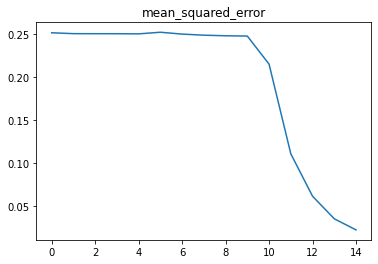

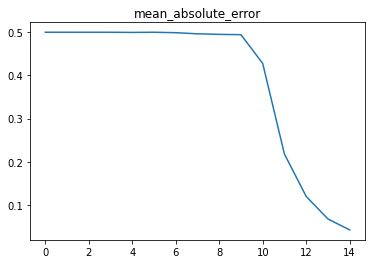

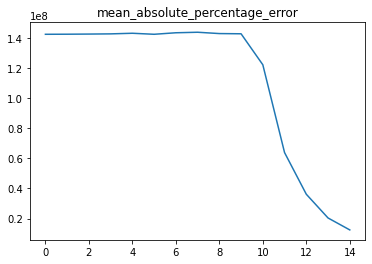

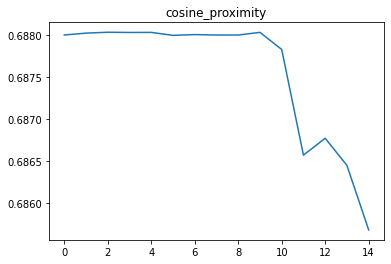

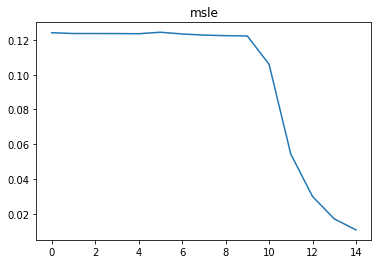

X_test.shape :  (10000, 1500, 1)
y_test.shape :  (10000, 1500, 1)
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1, 1)
After reshaping...
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1)
{fromRealToComplex} vect_im.shape :  (1, 750)
{fromRealToComplex} vect_im.shape :  (1, 750)
[channel] qzt : [[ 5.14537068e-01+2.66219635e-01j -1.06614302e-01+5.61374909e-01j
   4.45955252e-01+6.28453247e-01j  2.62848505e-01+7.03914640e-01j
   5.12281935e-01+9.48706748e-01j -1.26308989e-01-5.14120161e-02j
  -1.28234528e-01+4.53183884e-01j -1.92490823e-01+1.12102747e+00j
  -5.28126035e-01+8.22673958e-01j  3.91619626e-01+8.09660457e-01j
   5.91216187e-01+1.02384213e+00j  4.73906673e-01+2.32851642e-01j
  -9.02074508e-02+6.13133092e-01j  4.55383741e-01+1.39162992e-01j
  -5.08670884e-01+1.04320200e+00j  5.12573390e-01+7.87222636e-01j
   3.52768987e-01+6.21673305e-01j  7.63582921e-01+5.96759549e-01j
   2.24500198e-01+2.50248939e-01j  4.52955271e-01-4.00555058e-01j
   5.98335171e-01+1.68247922e-02j  3.93274571e-02+

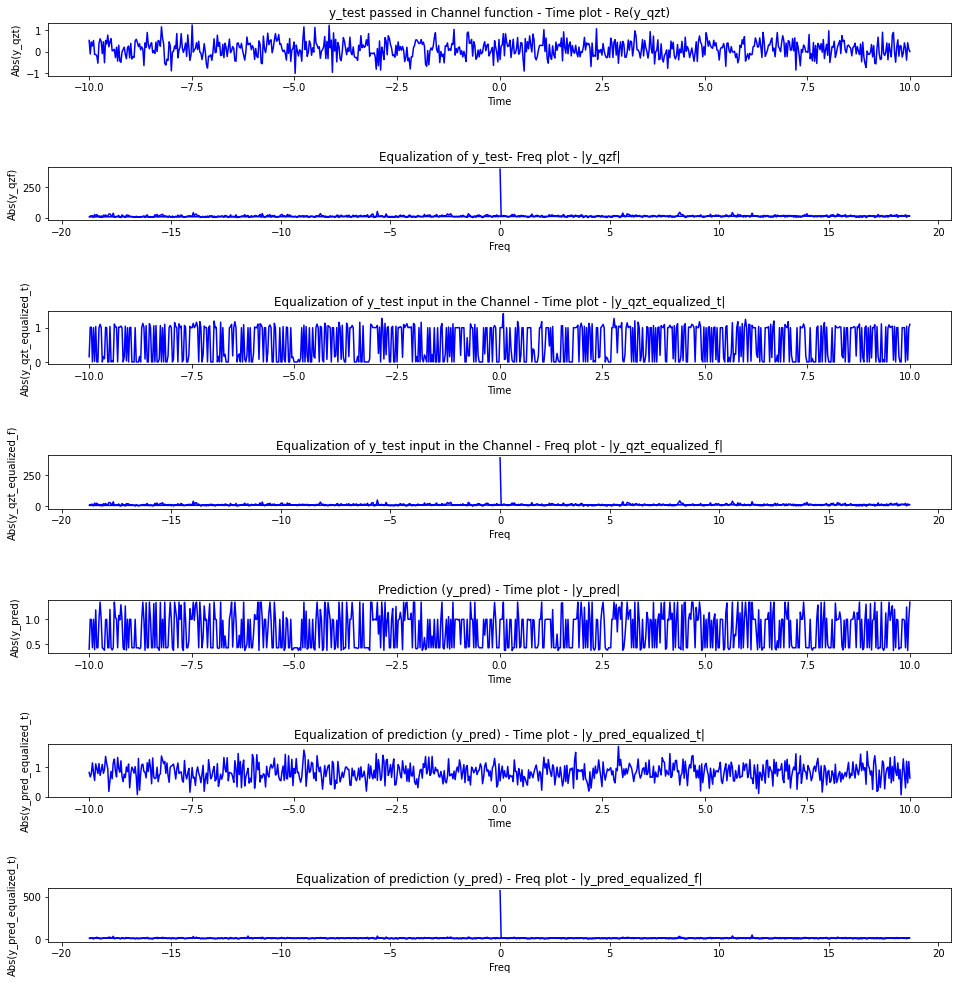

In [ ]:
# testing the model
index_pred = -1
with_error_plots = True
y_pred = test_model(model_lstm, X_test, y_test, history, index_pred, with_error_plots)

In [ ]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

## **LSTM-CNN**

In [ ]:
#-----------------------------------------------------------------------------------------------------#

def create_LSTM_CNN(customActivationFct, lr, loss_fct, nbrOfStackedLSTM, nbrOfStackedDense, nbrNeuronsLSTM, nbrOfStackedCNN, nbrFiltersCNN, dropoutDense, dropoutLSTM, dropoutCNN):

  if lr != None :
    K.set_value(model_dense.optimizer.learning_rate, lr)

  # custom activation function
  if customActivationFct :
    get_custom_objects().update({'my_activation': Activation(my_activation)})

  # Model
  model_lstm_cnn = Sequential()

  # Input Layer ----------------------------------------------------------------------------------------------------------#
  # 1st Dense layer should include input shape
  model_lstm_cnn.add(Dense(X_train.shape[1], kernel_initializer='normal', input_shape=X_train.shape[1:]))
  model_lstm_cnn.add(LeakyReLU())
  model_lstm_cnn.add(Dropout(dropoutDense))
  model_lstm_cnn.add(BatchNormalization())
  

  # LSTM layers ----------------------------------------------------------------------------------------------------------#

  # go up to 10 layers of LSTM
  for i in range(nbrOfStackedLSTM):

    if i == 0 :
      # 1st LSTM layer should include input shape
      model_lstm_cnn.add(LSTM(nbrNeuronsLSTM, return_sequences=True))
      model_lstm_cnn.add(LeakyReLU())
      model_lstm_cnn.add(Dropout(dropoutLSTM))
      #model_lstm_cnn.add(BatchNormalization())
      continue
    
    model_lstm_cnn.add(BatchNormalization())
    model_lstm_cnn.add(LSTM(nbrNeuronsLSTM, return_sequences=True))
    model_lstm_cnn.add(LeakyReLU())
    model_lstm_cnn.add(Dropout(dropoutLSTM))
    #model_lstm_cnn.add(BatchNormalization())

  # Fully connected layers -------------------------------------------------------------------------------------------------#
  
  for i in range(nbrOfStackedDense) :
    model_lstm_cnn.add(BatchNormalization())
    model_lstm_cnn.add(Dense(nbrNeuronsDense, kernel_initializer='normal'))
    model_lstm_cnn.add(LeakyReLU())
    model_lstm_cnn.add(Dropout(dropoutDense))
    #model_lstm_cnn.add(BatchNormalization())

  

  # Convolution layers ----------------------------------------------------------------------------------------------------#

  
  # go up to 10 layers of CNN 
  for i in range(nbrOfStackedCNN-1):
    if i == 0 :
      # 1st CNN layer should include input shape
      model_lstm_cnn.add(Conv1D(filters=nbrFiltersCNN, kernel_size=1 ,strides=1, input_shape=X_train.shape[1:], kernel_initializer= 'uniform')) 
      model_lstm_cnn.add(LeakyReLU())
      model_lstm_cnn.add(Dropout(dropoutCNN))

    model_lstm_cnn.add(Conv1D(filters=nbrFiltersCNN, kernel_size=1 ,strides=1,  kernel_initializer= 'uniform', activation='sigmoid'))
    model_lstm_cnn.add(Dropout(dropoutCNN))

    

  # Fully connected layers -------------------------------------------------------------------------------------------------#
  for i in range(nbrOfStackedDense) :
    model_lstm_cnn.add(BatchNormalization())
    model_lstm_cnn.add(Dense(nbrNeuronsDense, kernel_initializer='normal'))
    model_lstm_cnn.add(LeakyReLU())
    model_lstm_cnn.add(Dropout(dropoutDense))
    #model_lstm_cnn.add(BatchNormalization())
    


  # Output layer -----------------------------------------------------------------------------------------------------------#
  model_lstm_cnn.add(Dense(1))
  if customActivationFct :
    model_lstm_cnn.add(Activation(my_activation, name='SpecialActivation'))
  else :
    model_lstm_cnn.add(Activation('sigmoid'))

  # Compile the model
  model_lstm_cnn.compile(loss=loss_fct, 
                      optimizer='SGD', 
                      metrics=['mean_squared_error', 'mean_absolute_error', 'mean_absolute_percentage_error', 'cosine_proximity', 'msle'])

  print(model_lstm_cnn.optimizer.get_config())
  print(model_lstm_cnn.summary())
  print("model_dense.output_shape : ",model_lstm_cnn.output_shape)

  return model_lstm_cnn

  #-----------------------------------------------------------------------------------------------------#

In [ ]:
with_error_plots = True 

customActivationFct = False
lr = None

nbrOfStackedDense = 0
nbrOfStackedLSTM = 4
nbrOfStackedCNN = 0

nbrNeuronsDense = 0
nbrNeuronsLSTM = 64
nbrFiltersCNN = 0

dropoutDense, dropoutLSTM, dropoutCNN = 0, 0, 0

loss_fct = 'mse'

In [ ]:
customActivationFct, lr, loss_fct, nbrOfStackedLSTM, nbrOfStackedDense, nbrNeuronsLSTM, nbrOfStackedCNN, nbrFiltersCNN, dropoutDense, dropoutLSTM, dropoutCNN

(False, None, 'mse', 4, 0, 64, 0, 0, 0, 0, 0)

In [ ]:
model_lstm = create_LSTM_CNN(customActivationFct, lr, loss_fct, nbrOfStackedLSTM, nbrOfStackedDense, nbrNeuronsLSTM, nbrOfStackedCNN, nbrFiltersCNN, dropoutDense, dropoutLSTM, dropoutCNN)

{'name': 'SGD', 'learning_rate': 0.01, 'decay': 0.0, 'momentum': 0.0, 'nesterov': False}
Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_91 (Dense)             (None, 2048, 2048)        4096      
_________________________________________________________________
leaky_re_lu_87 (LeakyReLU)   (None, 2048, 2048)        0         
_________________________________________________________________
dropout_143 (Dropout)        (None, 2048, 2048)        0         
_________________________________________________________________
batch_normalization_105 (Bat (None, 2048, 2048)        8192      
_________________________________________________________________
lstm_29 (LSTM)               (None, 2048, 64)          540928    
_________________________________________________________________
leaky_re_lu_88 (LeakyReLU)   (None, 2048, 64)          0         
______________________________

In [ ]:
epochs = 3
# Fiting the model
model_lstm2 = train(model_lstm, X_train, X_test, y_train, y_test, epochs , batch_size)

Epoch 1/3
704/704 [==============================] - 298s 415ms/step - loss: 0.0264 - mean_squared_error: 0.0264 - mean_absolute_error: 0.1291 - mean_absolute_percentage_error: 23407.9676 - cosine_proximity: 1.0000 - msle: 0.0122 - val_loss: 0.0263 - val_mean_squared_error: 0.0263 - val_mean_absolute_error: 0.1303 - val_mean_absolute_percentage_error: 12218.1611 - val_cosine_proximity: 1.0000 - val_msle: 0.0121
Epoch 2/3
704/704 [==============================] - 289s 410ms/step - loss: 0.0257 - mean_squared_error: 0.0257 - mean_absolute_error: 0.1271 - mean_absolute_percentage_error: 18425.0623 - cosine_proximity: 1.0000 - msle: 0.0118 - val_loss: 0.0263 - val_mean_squared_error: 0.0263 - val_mean_absolute_error: 0.1302 - val_mean_absolute_percentage_error: 12277.8965 - val_cosine_proximity: 1.0000 - val_msle: 0.0120
Epoch 3/3
704/704 [==============================] - 289s 411ms/step - loss: 0.0257 - mean_squared_error: 0.0257 - mean_absolute_error: 0.1269 - mean_absolute_percentage_

X_test.shape :  (7500, 2048, 1)
y_test.shape :  (7500, 2048, 1)
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1, 1)


After reshaping...
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1)
y_pred :  [[0.481085  ]
 [0.49418345]
 [0.48112983]
 ...
 [0.48732004]
 [0.4819129 ]
 [0.4927776 ]]
y_pred.shape :  (2048, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
y_test_im.shape :  (1024,)
y_pred_im.shape :  (1024,)
y_.shape :  (2048,)
y_pred.shape :  (2048,)


y_ :  [0.61992088 0.5865048  0.40711177 ... 0.38916306 0.39951026 0.37524659]
y_test_im :  [0.61992088+0.5865048j  0.40711177+0.34693829j 0.40843977+0.34797182j ...
 0.4377259 +0.39180826j 0.43499756+0.38916306j 0.39951026+0.37524659j]
y_pred :  [0.481085   0.49418345 0.48112983 ... 0.48732004 0.4819129  0.4927776 ]
y_pred_im :  [0.481085  +0.49418345j 0.48112983+0.48738673j 0.4811302 +0.48738706j ...
 0.4819919 +0.48731968j 0.4819893 +0.

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


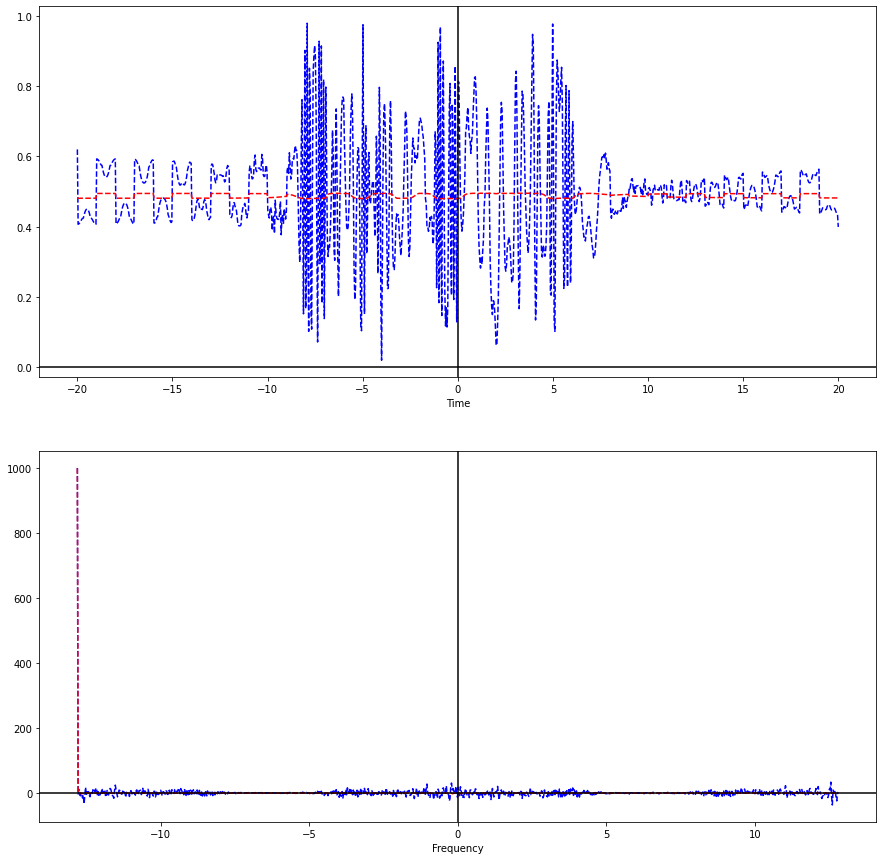

In [ ]:
# testing the model
index_pred = 695
with_error_plots = False
y_pred = test_model(model_lstm2, X_test, y_test, history, index_pred, with_error_plots)
test_prediction(y_test, y_pred, index_pred, parameters)


In [ ]:
epochs = 3
# Fiting the model
model_lstm = train(model_lstm_cnn, X_train, X_test, y_train, y_test, epochs , batch_size)

Epoch 1/3
704/704 [==============================] - 421s 588ms/step - loss: 0.0384 - mean_squared_error: 0.0384 - mean_absolute_error: 0.1465 - mean_absolute_percentage_error: 16921.0625 - cosine_proximity: 1.0000 - msle: 0.0176 - val_loss: 0.0241 - val_mean_squared_error: 0.0241 - val_mean_absolute_error: 0.1194 - val_mean_absolute_percentage_error: 11350.1230 - val_cosine_proximity: 1.0000 - val_msle: 0.0109
Epoch 2/3
704/704 [==============================] - 410s 583ms/step - loss: 0.0197 - mean_squared_error: 0.0197 - mean_absolute_error: 0.0992 - mean_absolute_percentage_error: 20747.9350 - cosine_proximity: 1.0000 - msle: 0.0091 - val_loss: 0.0193 - val_mean_squared_error: 0.0193 - val_mean_absolute_error: 0.0974 - val_mean_absolute_percentage_error: 10120.2695 - val_cosine_proximity: 1.0000 - val_msle: 0.0089
Epoch 3/3
704/704 [==============================] - 410s 583ms/step - loss: 0.0183 - mean_squared_error: 0.0183 - mean_absolute_error: 0.0919 - mean_absolute_percentage_

X_test.shape :  (7500, 2048, 1)
y_test.shape :  (7500, 2048, 1)
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1, 1)


After reshaping...
X.shape :  (2048, 1)
y_pred.shape :  (2048, 1)
y_pred :  [[0.5054246 ]
 [0.50494856]
 [0.5055274 ]
 ...
 [0.4984662 ]
 [0.50505924]
 [0.5023168 ]]
y_pred.shape :  (2048, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
{fromRealToComplex} vect_im.shape :  (1, 1024, 1)
y_test_im.shape :  (1024,)
y_pred_im.shape :  (1024,)
y_.shape :  (2048,)
y_pred.shape :  (2048,)


y_ :  [0.61992088 0.5865048  0.40711177 ... 0.38916306 0.39951026 0.37524659]
y_test_im :  [0.61992088+0.5865048j  0.40711177+0.34693829j 0.40843977+0.34797182j ...
 0.4377259 +0.39180826j 0.43499756+0.38916306j 0.39951026+0.37524659j]
y_pred :  [0.5054246  0.50494856 0.5055274  ... 0.4984662  0.50505924 0.5023168 ]
y_pred_im :  [0.5054246 +0.50494856j 0.5055274 +0.49840817j 0.50552887+0.4984068j  ...
 0.50506496+0.498466j   0.50506765+0.

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


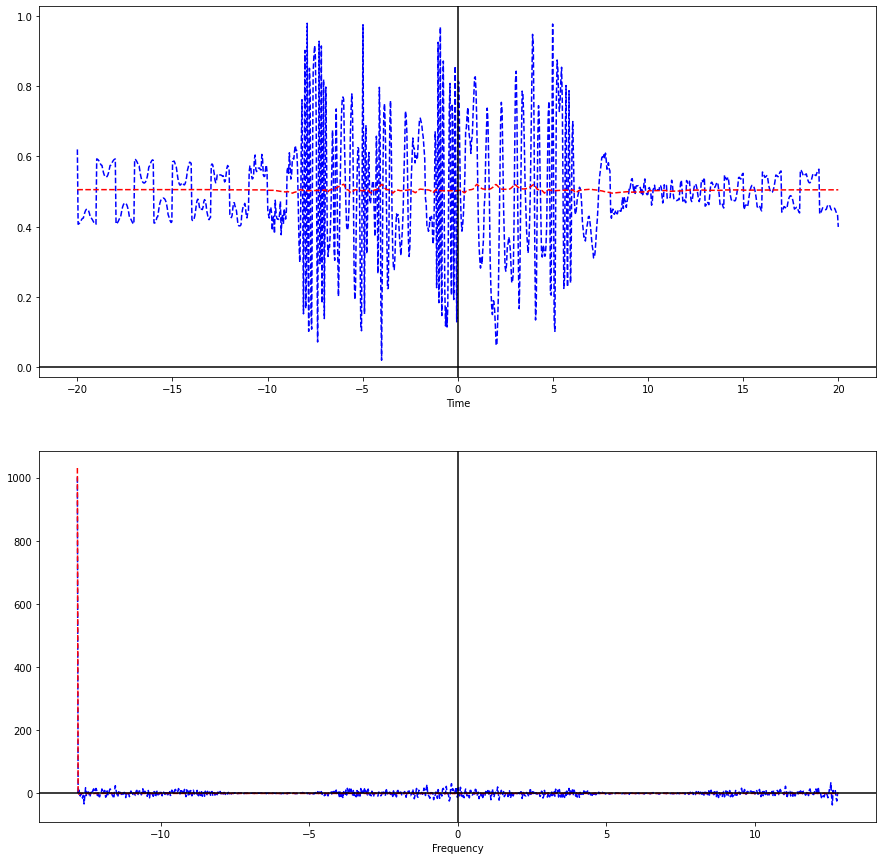

In [ ]:
# testing the model
index_pred = 695
with_error_plots = False
y_pred = test_model(model_lstm_cnn, X_test, y_test, history, index_pred, with_error_plots)
test_prediction(y_test, y_pred, index_pred, parameters)

In [ ]:
epochs = 35
# Fiting the model
model_lstm = train(model_lstm_cnn, X_train, X_test, y_train, y_test, epochs , batch_size)

Epoch 1/35
469/469 [==============================] - 161s 343ms/step - loss: 0.0939 - mean_squared_error: 0.0939 - mean_absolute_error: 0.1841 - mean_absolute_percentage_error: 53119308.0000 - cosine_proximity: 0.6866 - msle: 0.0460 - val_loss: 0.0274 - val_mean_squared_error: 0.0274 - val_mean_absolute_error: 0.0948 - val_mean_absolute_percentage_error: 27757368.0000 - val_cosine_proximity: 0.6881 - val_msle: 0.0147
Epoch 2/35
469/469 [==============================] - 158s 337ms/step - loss: 0.0667 - mean_squared_error: 0.0667 - mean_absolute_error: 0.1294 - mean_absolute_percentage_error: 37883272.0000 - cosine_proximity: 0.6857 - msle: 0.0326 - val_loss: 0.0150 - val_mean_squared_error: 0.0150 - val_mean_absolute_error: 0.0595 - val_mean_absolute_percentage_error: 18437834.0000 - val_cosine_proximity: 0.6881 - val_msle: 0.0083
Epoch 3/35
469/469 [==============================] - 158s 338ms/step - loss: 0.0523 - mean_squared_error: 0.0523 - mean_absolute_error: 0.1007 - mean_absol

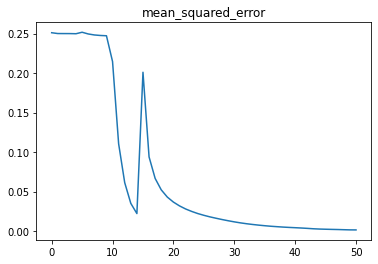

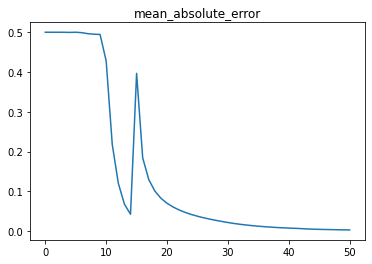

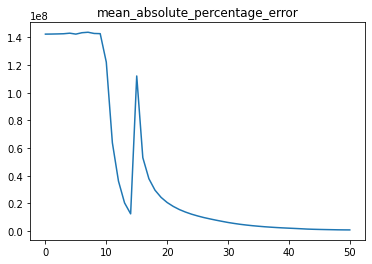

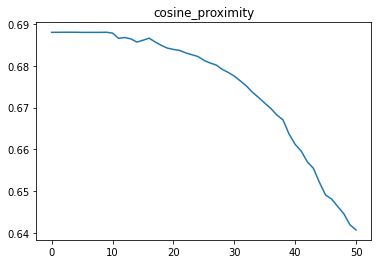

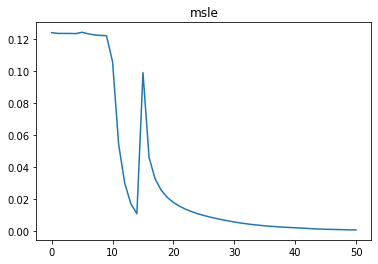

X_test.shape :  (10000, 1500, 1)
y_test.shape :  (10000, 1500, 1)
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1, 1)
After reshaping...
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1)
{fromRealToComplex} vect_im.shape :  (1, 750)
{fromRealToComplex} vect_im.shape :  (1, 750)
[channel] qzt : [[ 5.14537068e-01+2.66219635e-01j -1.06614302e-01+5.61374909e-01j
   4.45955252e-01+6.28453247e-01j  2.62848505e-01+7.03914640e-01j
   5.12281935e-01+9.48706748e-01j -1.26308989e-01-5.14120161e-02j
  -1.28234528e-01+4.53183884e-01j -1.92490823e-01+1.12102747e+00j
  -5.28126035e-01+8.22673958e-01j  3.91619626e-01+8.09660457e-01j
   5.91216187e-01+1.02384213e+00j  4.73906673e-01+2.32851642e-01j
  -9.02074508e-02+6.13133092e-01j  4.55383741e-01+1.39162992e-01j
  -5.08670884e-01+1.04320200e+00j  5.12573390e-01+7.87222636e-01j
   3.52768987e-01+6.21673305e-01j  7.63582921e-01+5.96759549e-01j
   2.24500198e-01+2.50248939e-01j  4.52955271e-01-4.00555058e-01j
   5.98335171e-01+1.68247922e-02j  3.93274571e-02+

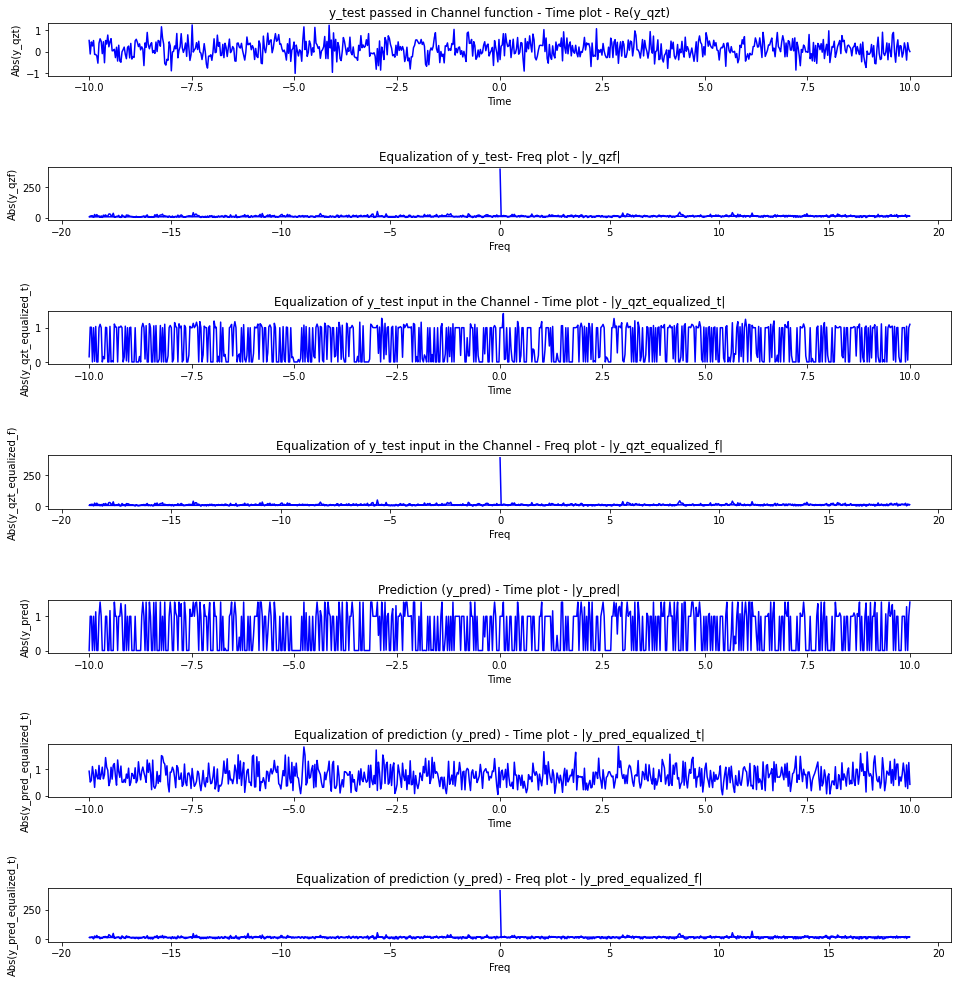

In [ ]:
# testing the model
index_pred = -1
with_error_plots = True
y_pred = test_model(model_lstm, X_test, y_test, history, index_pred, with_error_plots)

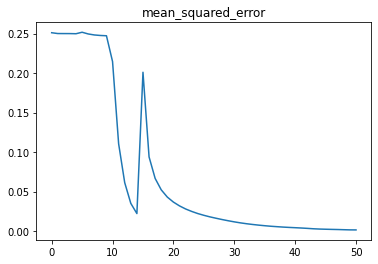

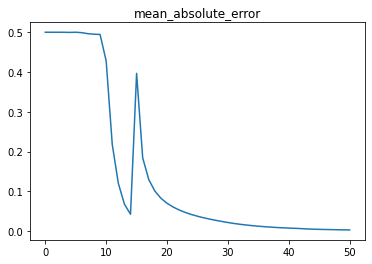

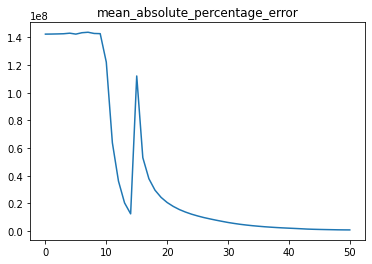

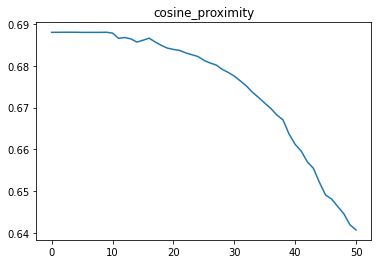

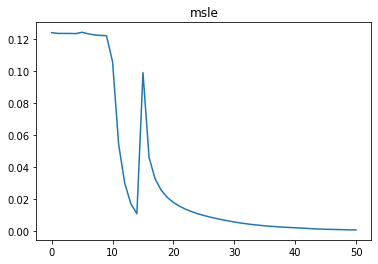

X_test.shape :  (10000, 1500, 1)
y_test.shape :  (10000, 1500, 1)
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1, 1)
After reshaping...
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1)
{fromRealToComplex} vect_im.shape :  (1, 750)
{fromRealToComplex} vect_im.shape :  (1, 750)
[channel] qzt : [[ 5.14537068e-01+2.66219635e-01j -1.06614302e-01+5.61374909e-01j
   4.45955252e-01+6.28453247e-01j  2.62848505e-01+7.03914640e-01j
   5.12281935e-01+9.48706748e-01j -1.26308989e-01-5.14120161e-02j
  -1.28234528e-01+4.53183884e-01j -1.92490823e-01+1.12102747e+00j
  -5.28126035e-01+8.22673958e-01j  3.91619626e-01+8.09660457e-01j
   5.91216187e-01+1.02384213e+00j  4.73906673e-01+2.32851642e-01j
  -9.02074508e-02+6.13133092e-01j  4.55383741e-01+1.39162992e-01j
  -5.08670884e-01+1.04320200e+00j  5.12573390e-01+7.87222636e-01j
   3.52768987e-01+6.21673305e-01j  7.63582921e-01+5.96759549e-01j
   2.24500198e-01+2.50248939e-01j  4.52955271e-01-4.00555058e-01j
   5.98335171e-01+1.68247922e-02j  3.93274571e-02+

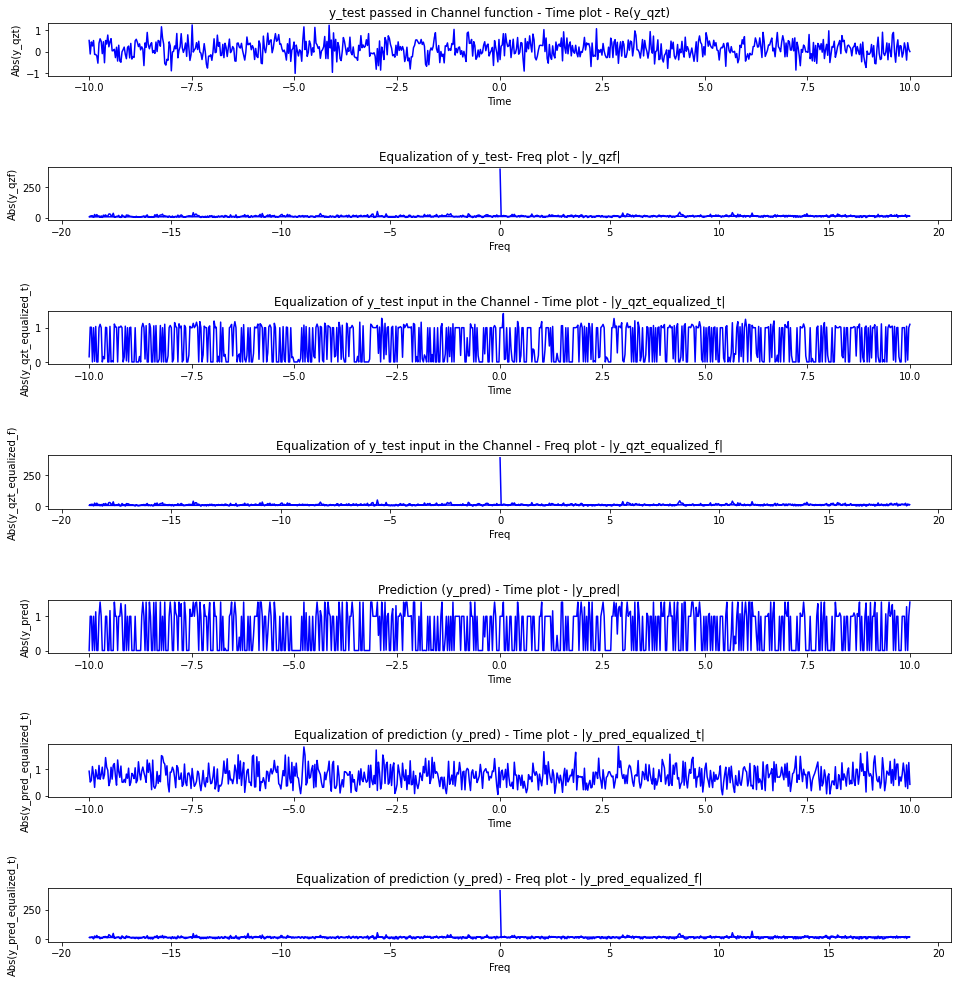

In [ ]:
# testing the model
index_pred = 150
with_error_plots = True
y_pred = test_model(model_lstm, X_test, y_test, history, index_pred, with_error_plots)

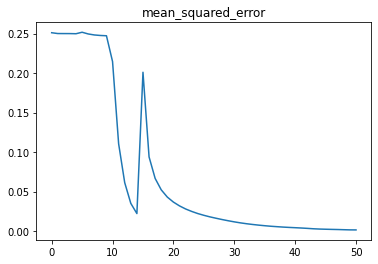

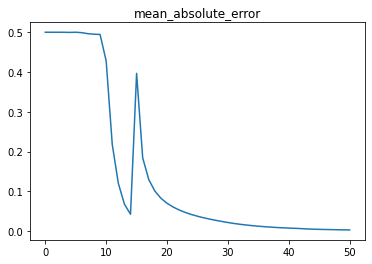

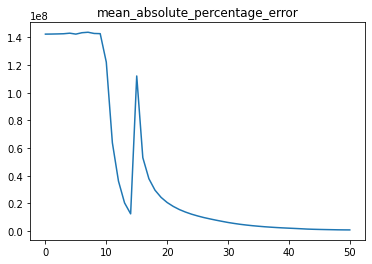

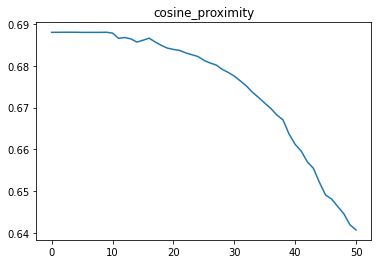

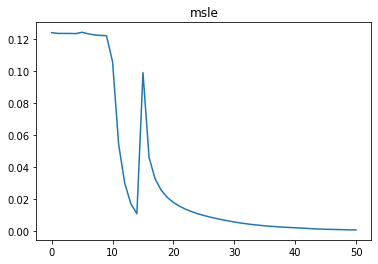

X_test.shape :  (10000, 1500, 1)
y_test.shape :  (10000, 1500, 1)
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1, 1)
After reshaping...
X.shape :  (1500, 1)
y_pred.shape :  (1500, 1)
{fromRealToComplex} vect_im.shape :  (1, 750)
{fromRealToComplex} vect_im.shape :  (1, 750)
[channel] qzt : [[ 5.14537068e-01+2.66219635e-01j -1.06614302e-01+5.61374909e-01j
   4.45955252e-01+6.28453247e-01j  2.62848505e-01+7.03914640e-01j
   5.12281935e-01+9.48706748e-01j -1.26308989e-01-5.14120161e-02j
  -1.28234528e-01+4.53183884e-01j -1.92490823e-01+1.12102747e+00j
  -5.28126035e-01+8.22673958e-01j  3.91619626e-01+8.09660457e-01j
   5.91216187e-01+1.02384213e+00j  4.73906673e-01+2.32851642e-01j
  -9.02074508e-02+6.13133092e-01j  4.55383741e-01+1.39162992e-01j
  -5.08670884e-01+1.04320200e+00j  5.12573390e-01+7.87222636e-01j
   3.52768987e-01+6.21673305e-01j  7.63582921e-01+5.96759549e-01j
   2.24500198e-01+2.50248939e-01j  4.52955271e-01-4.00555058e-01j
   5.98335171e-01+1.68247922e-02j  3.93274571e-02+

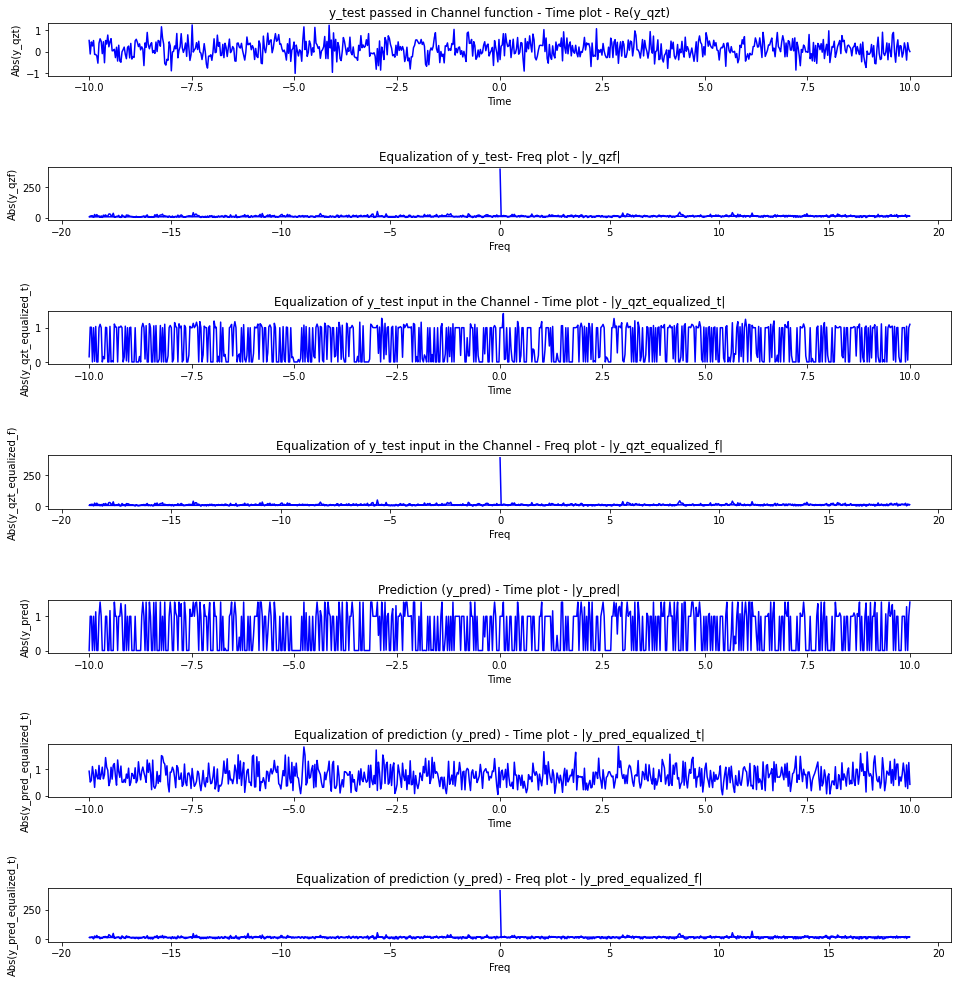

In [ ]:
# testing the model
index_pred = 951
with_error_plots = True
y_pred = test_model(model_lstm, X_test, y_test, history, index_pred, with_error_plots)

In [ ]:
# testing the model
index_pred = 234
with_error_plots = True
y_pred = test_model(model_lstm, X_test, y_test, history, index_pred, with_error_plots)